# MRP: Hopfield_v2.py
This is the complete HN create by the MRP


In [1]:
# Hopfield v2 -> all even modules
############################### DEPENDENCIES ##################################
import json
import os
import sys
import contextlib
import io
import numpy as np
import inspect
import os.path
import matplotlib.pyplot as plt
from math import pi, atan, sin, sqrt, tanh, cosh, exp, ceil
import seaborn as sns
from numpy.core.fromnumeric import shape
import random
import time
import math
from pathlib import Path


In [2]:
########################## LOCAL DEPENDENCIES #################################

#filename = inspect.getframeinfo(inspect.currentframe()).filename
#file_path = os.path.dirname(os.path.abspath(filename))
#project_root = os.path.dirname(file_path)

#if project_root not in sys.path:
#    sys.path.append(project_root)

#print(project_root)


In [3]:
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

print(module_path)

project_root = module_path

c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub


In [4]:


#project_root = os.path.dirname(r"C:\Users\aurel\Documents\Maastricht University\Thesis\Last code MRP")

if project_root not in sys.path:
    sys.path.append(project_root)
from event_model import event_model as em
from validator import validator_lite as vl
import data_analysis.event_generator as eg
from visual.color_map import Colormap



In [5]:
########################### GLOBAL VARIABLES ##################################


########################### CONTEXTS ##################################
@contextlib.contextmanager
def nostdout():
    save_stdout = sys.stdout
    sys.stdout = io.BytesIO()
    yield
    sys.stdout = save_stdout


In [6]:
########################### HELPER FUNCTIONS ##################################
def get_polar_coordinates(x, y):
    r = math.sqrt(x ** 2 + y ** 2)
    phi = math.atan2(x, y)
    if phi < 0:
        phi = math.pi - phi
    return r, phi


In [7]:
############################### BODY ##########################################
class Hopfield:
    def __init__(self, modules: list, parameters: dict, tracks: list = None):
        # set self variables, such as the maximum size
        self.p = parameters
        self.m = modules
        self.start_T = self.p["T"]
        self.start_B = self.p["B"]
        self.N = None
        self.N_info = None
        self.modules_count = len(modules)
        self.hit_counts = [len(module.hits()) for module in self.m]
        self.neuron_count = [
            self.hit_counts[i] * self.hit_counts[i + 1]
            for i in range(self.modules_count - 1)
        ]
        self.flips = 0
        self.max_neurons = max(self.neuron_count)
        self.init_neurons(tracks=tracks)
        self.init_weights()
        self.extracted_hits = set()
        self.extracted_tracks = []
        self.extracted_track_states = []
        self.energies = []

    def init_neurons(self, tracks: list = None):
        # consider hits in 2 modules as one neuron layer
        # the neurons in N are ordered h(1,1)-h(2,1); h(1,1)-h(2,2); h(1,1)-h(2,3) etc
        if self.p["random_neuron_init"]:
            self.N = np.random.uniform(size=(self.modules_count - 1, self.max_neurons))
        else:
            self.N = np.ones(shape=(self.modules_count - 1, self.max_neurons))
        if tracks:
            self.N = np.zeros(shape=(self.modules_count - 1, self.max_neurons))
        for idx, nc in enumerate(self.neuron_count):
            self.N[idx, nc:] = 0
        self.N_info = np.zeros(shape=(self.modules_count - 1, self.max_neurons, 4))
        for idx in range(self.modules_count - 1):
            m1 = self.m[idx]
            m2 = self.m[idx + 1]

            for i, hit1 in enumerate(m1.hits()):
                for j, hit2 in enumerate(m2.hits()):
                    n_idx = i * self.hit_counts[idx + 1] + j
                    if tracks:
                        for t in tracks:
                            if hit1 in t and hit2 in t:
                                self.N[idx, n_idx] = 1
                    # maybe we can check these angles again
                    angle_xz = atan((hit2.x - hit1.x) / (hit2.z - hit1.z))
                    angle_yz = atan((hit2.y - hit1.y) / (hit2.z - hit1.z))
                    norm_dist = sqrt(
                        (hit2.y - hit1.y) ** 2 + (hit2.x - hit1.x) ** 2
                    ) / sqrt(
                        (hit2.z - hit1.z) ** 2
                    )  # does not work!!!

                    _, r_hit1 = get_polar_coordinates(hit1.x, hit1.y)
                    _, r_hit2 = get_polar_coordinates(hit2.x, hit2.y)
                    monotone_dist = (r_hit2 - r_hit1) / (hit2.z - hit1.z)

                    self.N_info[idx, n_idx, 0] = abs(angle_xz)
                    self.N_info[idx, n_idx, 1] = abs(angle_yz)
                    self.N_info[idx, n_idx, 2] = norm_dist  # not robust!!!!
                    self.N_info[idx, n_idx, 3] = monotone_dist

    def init_weights(self, neg_weights=False):
        #### get params from the dict #######
        alpha = self.p["ALPHA"]
        beta = self.p["BETA"]
        gamma = self.p["GAMMA"]
        #####################################
        self.W = np.zeros(
            shape=(self.modules_count - 2, self.max_neurons, self.max_neurons,)
        )

        # loops neuron_layer - neuron_layer weight matrices
        for w_idx in range(self.modules_count - 2):
            # loops hits of the module connecting the neuron layers
            for con_idx in range(self.hit_counts[w_idx + 1]):  # m2
                for i in range(self.hit_counts[w_idx]):  # m1
                    ln_idx = i * self.hit_counts[w_idx + 1] + con_idx  # left_neuron_idx
                    for j in range(self.hit_counts[w_idx + 2]):  # m3
                        rn_idx = (
                            con_idx * self.hit_counts[w_idx + 2] + j
                        )  # right_neuron_idx

                        # Constant term from the other group
                        constant = (
                            self.N_info[w_idx, ln_idx, 2]
                            - self.N_info[w_idx + 1, rn_idx, 2]
                        )
                        constant = tanh(constant) * (
                            self.p["narrowness"] + 1
                        )  # tanh to force between -1 and 1
                        constant = (
                            -2 * constant ** 2
                        ) + 1  # this should be high if both terms are similar and low/penalizing if both are not similar
                        constant = constant * self.p["constant_factor"]
                        constant = min(
                            max(constant, -self.p["constant_factor"]),
                            self.p["constant_factor"],
                        )

                        # monotone constant
                        monotone_constant = (
                            self.N_info[w_idx, ln_idx, 3]
                            - self.N_info[w_idx + 1, rn_idx, 3]
                        )
                        monotone_constant = tanh(monotone_constant) * (
                            self.p["narrowness"] + 1
                        )  # tanh to force between -1 and 1

                        monotone_constant = (
                            -2 * monotone_constant ** 2
                        ) + 1  # this should be high if both terms are similar and low/penalizing if both are not similar

                        monotone_constant = (
                            monotone_constant * self.p["monotone_constant_factor"]
                        )
                        monotone_constant = min(
                            max(monotone_constant, -self.p["monotone_constant_factor"]),
                            self.p["monotone_constant_factor"],
                        )

                        theta = abs(
                            self.N_info[w_idx, ln_idx, 0]
                            - self.N_info[w_idx + 1, rn_idx, 0]
                        )
                        phi = abs(
                            self.N_info[w_idx, ln_idx, 1]
                            - self.N_info[w_idx + 1, rn_idx, 1]
                        )

                        self.W[w_idx, ln_idx, rn_idx] = (
                            alpha
                            * ((1 - sin(theta)) ** beta)
                            * ((1 - sin(phi)) ** gamma)
                            + monotone_constant
                            + constant
                        )
                        #    + constant # this does not work properly

                        if not neg_weights:
                            self.W[w_idx, ln_idx, rn_idx] = max(
                                0, self.W[w_idx, ln_idx, rn_idx]
                            )

                        # maybe we can play a bit around with this

    def update(self):
        # I think here we need to look at the first neurons,
        # then all the neurons in between as they are dependent on two other layers of neurons
        # then the last layer of the neurons as they only dep on one side
        update_list = []
        for idx in range(self.modules_count - 1):
            c1 = self.hit_counts[idx]
            c2 = self.hit_counts[idx + 1]
            for i in range(c1 * c2):
                update_list.append((idx, i))

        if self.p["randomized_updates"]:
            random.shuffle(update_list)

        if self.p["fully_randomized_updates"]:
            for c in range(len(update_list)):
                idx, i = random.sample(update_list, 1)[0]
                self.update_neuron(idx, i)

        else:
            for idx, i in update_list:
                self.update_neuron(idx, i)

    def update_neuron(self, idx, i):
        b = self.p["B"]
        t = self.p["T"]
        c1 = self.hit_counts[idx]
        c2 = self.hit_counts[idx + 1]
        update = 0
        if idx > 0:
            update += self.N[idx - 1, :].T @ self.W[idx - 1, :, i]
        if idx < self.modules_count - 2:
            update += self.W[idx, i, :] @ self.N[idx + 1, :]
        if 0 < idx < self.modules_count - 1:
            update /= 2
        # left module and right module hit id -> current neuron connects hit lm_id with hit rn_id
        lm_id = i // c2
        rm_id = i % c2
        # there can be a lot improved runtime wise with storing the sums and adj
        # but too complicated for now
        # all segments mapping to the hit in m1 -> the left module
        m1h = np.sum(self.N[idx, lm_id * c2 : (lm_id + 1) * c2])
        # all segments mapping to the hit in m2 - the right module
        m2h = np.sum(
            self.N[idx, : c1 * c2].reshape(c2, c1)[rm_id, :]
        )  # correct as well...
        # we need to subtract the neuron of the segment 2 times because we add it 2 times
        pen = m1h + m2h - 2 * self.N[idx, i]
        _update = 0.5 * (1 + tanh(update / t - b * pen / t))

        if self.p["binary_states"]:
            # XXX some threshold... -> we dont use bina
            if random.random() < _update:
                self.N[idx, i] = 1
            else:
                self.N[idx, i] = 0
        else:
            self.N[idx, i] = _update

    def energy(self):
        b = self.p["B"]

        E = 0
        bifurc_pen = 0
        for idx in range(self.modules_count - 2):
            c1 = self.hit_counts[idx]
            c2 = self.hit_counts[idx + 1]
            c3 = self.hit_counts[idx + 2]

            # XXX: just realised we are counting most penalties too often!! -> fixed
            f1 = 0.5
            f2 = 0.5
            if idx == 0:
                f1 = 1
            if idx == self.modules_count - 3:
                f2 = 1
            N1_pen = self.N[idx, : c1 * c2].reshape(c2, c1)
            N2_pen = self.N[idx + 1, : c2 * c3].reshape(c2, c3)
            bifurc_pen = (
                np.sum(np.trace(N1_pen @ N1_pen.T)) * f1
                + np.sum(np.trace(N2_pen @ N2_pen.T)) * f2
                - np.sum(self.N[idx, :] * self.N[idx, :]) * f1
                - np.sum(self.N[idx + 1, :] * self.N[idx + 1, :]) * f2
            )

            E += (
                -0.5 * (self.N[idx, :].T @ self.W[idx, :, :] @ self.N[idx + 1, :])
                + b * bifurc_pen
            )
        return E

    def converge(self):
        # Basically keep updating until the difference in Energy between timesteps is lower than 0.0005 (Based on Stimfple-Abele)
        # Passaleva uses a different kind of convergence i think (4)
        self.energies = [
            self.energy()
        ]  # store all energies (not fastest but maybe nice for visualisations)
        t = 0  # timesteps
        self.p["T"] = self.start_T
        # self.p["B"] = self.start_B
        # print(f"N at iteration{t}:", np.round(my_instance.N, 1))
        self.update()
        t += 1
        self.energies.append(self.energy())
        while (
            abs(abs(self.energies[-2]) - abs(self.energies[-1]))
            >= self.p["convergence_threshold"]
        ):
            self.update()
            self.energies.append(self.energy())
            # print(f"N at iteration{t}:", np.round(my_instance.N, 1))
            t += 1
            if not self.p["decay_off"]:
                self.p["T"] = self.p["T_decay"](self.p["T"])
                self.p["B"] = self.p["B_decay"](t)
            else:
                pass  # keep T and B fixed

        # print("Network Converged after " + str(t) + " steps")
        # print("Energy = " + str(self.energies[-1]))
        return self.N, self.energies[-1], t

    def bootstrap_converge(self, bootstraps=50, method="mean"):
        start_time = time.time()
        states_list = []
        energy_list = []
        iter_list = []
        for i in range(bootstraps):

            if self.p["random_neuron_init"]:
                # We only need to reinitialize if we randomly initialize
                self.init_neurons()

            states, energy, iters = self.converge()
            print("energy: " + str(energy))

            states_list.append(states)
            energy_list.append(energy)
            iter_list.append(iters)
            # print(f"Finished {i+1}/{bootstraps} iterations")

        if method == "minimum":
            # XXX: eventually we could take the lowest 20% or so
            self.N = states_list[np.argmax(energy_list)]
            energy_list = [np.amax(energy_list)]
        elif method == "below_median":
            median = np.median(energy_list)
            _tmp_states = []
            for states, e in zip(states_list, energy_list):
                if e <= median:
                    _tmp_states.append(states)
            _tmp_states = np.stack(_tmp_states, axis=2)
            self.N = np.mean(_tmp_states, axis=2)
        elif method == "below_mean":
            mean = np.mean(energy_list)
            _tmp_states = []
            for states, e in zip(states_list, energy_list):
                if e <= mean:
                    _tmp_states.append(states)
            _tmp_states = np.stack(_tmp_states, axis=2)
            self.N = np.mean(_tmp_states, axis=2)
        else:
            stacked_states = np.stack(states_list, axis=2)
            self.N = np.mean(stacked_states, axis=2)

        end_time = time.time() - start_time
        print(
            "[HOPFIELD] converged network by %s after %i mins %.2f seconds; (energy: %.2f)"
            % (method, end_time // 60, end_time % 60, np.mean(energy_list))
        )
        return sum(iter_list) / len(iter_list)

    def tracks(self):
        # What the papers say:  The answer is given by the final set of active Neurons
        #                       All sets of Neurons connected together are considered as track candidates
        #
        # IDEA: All neurons that share a hit and are both connected are track candidates
        global_candidates = []
        global_candidate_states = []

        for idx in range(self.modules_count - 2):
            candidates = []
            candidate_states = []
            l1 = self.hit_counts[idx]  # number of hits in module 1
            l2 = self.hit_counts[idx + 1]
            l3 = self.hit_counts[idx + 2]

            if self.p["maxActivation"]:
                candidates = []
                thresh = self.p["THRESHOLD"]

                n1_transform = self.N[idx, : l2 * l1].reshape(l1, l2).T.copy()
                n2_transform = self.N[idx + 1, : l3 * l2].reshape(l2, l3).T.copy()

                for con in range(l2):  # loop over the connection hits in module 2
                    # XXX i try swapping these....
                    h1_idx = np.argmax(n1_transform[con, :])
                    h3_idx = np.argmax(n2_transform[:, con])

                    if (
                        n1_transform[con, h1_idx] < thresh
                        or n2_transform[h3_idx, con] < thresh
                    ):
                        continue

                    hit1 = self.m[idx].hits()[h1_idx]
                    hit2 = self.m[idx + 1].hits()[con]
                    hit3 = self.m[idx + 2].hits()[h3_idx]
                    candidates.append(em.track([hit1, hit2, hit3]))
                    self.extracted_hits.add(hit1)
                    self.extracted_hits.add(hit2)
                    self.extracted_hits.add(hit3)
                    # if we get the same state
                    candidate_states.append(n1_transform[con, h1_idx])
                    candidate_states.append(n2_transform[h3_idx, con])

                    # XXX
                    # this prevents the display of bifurcation?!
                    # n1_transform[
                    #    :, h1_idx
                    # ] = 0  # set this hit to 0 so it's not chosen again
                    # n2_transform[h3_idx, :] = 0

            global_candidates += candidates
            global_candidate_states += candidate_states

        self.extracted_tracks = global_candidates
        self.extracted_track_states = global_candidate_states

        return global_candidates

    def full_tracks(self):
        # this will deal with stange angles!!!
        # under the assumption that we removed bifuration completely
        # init this active tracks with all active neurons in layer 1! -> key is the right hit
        global_candidates = []
        global_candidate_states = []
        global_candidate_info = []
        tracks = {}

        for idx in range(self.modules_count - 1):
            tracks_2 = {}
            l1 = self.hit_counts[idx]  # number of hits in module 1 / L
            l2 = self.hit_counts[idx + 1]  # number of hits in module 2 / R

            tr = self.p["THRESHOLD"]
            for segment in range(l1 * l2):
                if self.N[idx, segment] < tr:
                    continue

                r_hit = self.m[idx + 1].hits()[segment % l2]
                l_hit = self.m[idx].hits()[segment // l2]

                if l_hit in tracks.keys():
                    (track, states, angle) = tracks[l_hit]

                    track = track + [r_hit]
                    states = states + [self.N[idx, segment]]
                    info = angle + [self.N_info[idx, segment, :]]
                    del tracks[l_hit]

                    self.extracted_hits.add(r_hit)
                    tracks_2[r_hit] = (track, states, info)

                else:
                    track = [l_hit, r_hit]
                    states = [self.N[idx, segment]]
                    info = [self.N_info[idx, segment, :]]

                    tracks_2[r_hit] = (track, states, info)
                    self.extracted_hits.add(r_hit)
                    self.extracted_hits.add(l_hit)

            for _, value in tracks.items():
                (track, states, info) = value
                global_candidates = global_candidates + [track]
                global_candidate_states = global_candidate_states + [states]
                global_candidate_info = global_candidate_info + [info]
            tracks = tracks_2

        for _, value in tracks.items():
            (track, states, info) = value
            global_candidates = global_candidates + [track]
            global_candidate_states = global_candidate_states + [states]
            global_candidate_info = global_candidate_info + [info]

        # here comes the function of 'pruning...' maybe i need to store more info for doing that!!!
        global_candidates = self.prune_tracks(global_candidates, global_candidate_info)

        global_candidates = [em.track(hits) for hits in global_candidates]
        self.extracted_tracks = global_candidates
        self.extracted_track_states = global_candidate_states

        return global_candidates

    # tr 0.1 seems decent for sum of info differences...
    # we could look more carully into a criterion for this on big instances but here is fine...
    # XXX: need to check that method properly again
    def prune_tracks(self, tracks, track_infos):
        tr = self.p["pruning_tr"]
        out_tracks = []
        for track, info in zip(tracks, track_infos):
            num_hits = len(track)
            if num_hits < 3:  # sorting out the tracks that are not relevant
                continue
            # only if len> 6 need to think about splitting!!!
            cand = [track[0], track[1]]
            cand_info = info[0]
            for idx in range(1, num_hits - 1):
                # if abs(cand_info[3] - info[idx][3]) < tr:
                if sum(abs(cand_info - info[idx])) < tr:
                    cand = cand + [track[idx + 1]]
                else:
                    if len(cand) > 2:
                        out_tracks = out_tracks + [cand]
                    cand = [track[idx], track[idx + 1]]
                cand_info = info[idx]

            if len(cand) > 2:
                out_tracks = out_tracks + [cand]
        return out_tracks

    def mark_bifurcation(self):
        zero = True
        max_activation = self.p["max_activation"]
        smart = self.p["smart"]
        if max_activation:
            zero = False
        if smart:
            zero = False
            max_activation = False

        tr = self.p["THRESHOLD"]
        self.N[self.N <= tr] = 0

        # search for bifurcation neurons
        for idx in range(self.modules_count - 1):
            # so basically we visit all neurons in one layer and check for neurons where the activation is bigger than tr
            # then we check all adjacent neurons for activation and check how many are higher than the treshold
            # for each segment we look wether there is bifurcation on the left or right hit
            c1 = self.hit_counts[idx]
            c2 = self.hit_counts[idx + 1]

            for segment in range(c1 * c2):
                if self.N[idx, segment] < tr:
                    continue
                r_hit = segment % c2
                l_hit = segment // c2

                # left-right bifurction
                activation_mask = self.N[idx, : c1 * c2].reshape(c1, c2)[:, r_hit] > tr
                if sum(activation_mask) > 1:  # we have bifuct into the right hit
                    affected_neurons = []
                    for i in range(c1):  # loop over all nerons affected by bifurc
                        if activation_mask[i]:
                            # well here are the bifurcation things detected. here we would need to come up with a smart way to resolve it
                            if zero:
                                self.N[idx, (i * c2) + r_hit] = 0
                            else:
                                affected_neurons = affected_neurons + [(i * c2) + r_hit]
                    if smart:
                        # simple rule -> when bifurc is detected on right side -> we look next active neurons going out
                        # and promote the ones where the weight is high... (angle diff is low)
                        # if next neuron layer exist!!!
                        if idx < self.modules_count - 2:  # can check to the right
                            c3 = self.hit_counts[idx + 2]
                            activation_mask_2 = (
                                self.N[idx + 1, : c2 * c3].reshape(c2, c3)[r_hit, :]
                                > tr
                            )
                            affected_neurons_2 = []
                            for i in range(
                                c3
                            ):  # loop over all nerons affected by bifurc
                                if activation_mask_2[i]:
                                    affected_neurons_2 = affected_neurons_2 + [
                                        c3 * r_hit + i
                                    ]
                            if len(affected_neurons_2) > 0:
                                max_val = 0
                                max_l = None
                                max_r = None
                                for e in affected_neurons:
                                    for j in affected_neurons_2:
                                        c = (
                                            self.N[idx, e]
                                            * self.W[idx, e, j]
                                            * self.N[idx + 1, j]
                                        )
                                        if self.p["only_weight"]:
                                            c = self.W[idx, e, j]
                                        if c > max_val:
                                            max_l = e
                                            max_r = j
                                            max_val = c
                                    self.N[idx, e] = 0
                                for j in affected_neurons_2:
                                    self.N[idx + 1, j] = 0
                                if max_r is not None and max_l is not None:
                                    self.N[idx, max_l] = 1
                                    self.N[idx + 1, max_r] = 1
                            else:
                                max_activation = True
                        else:
                            max_activation = True

                    if max_activation:
                        max_activation = self.N[idx, affected_neurons[0]]
                        max_id = affected_neurons[0]
                        for e in affected_neurons:
                            if self.N[idx, e] >= max_activation:
                                max_id = e
                                max_activation = self.N[idx, e]

                            self.N[idx, e] = 0

                        self.N[idx, max_id] = 1
                    if smart:
                        max_activation = False

                # right-left bifurcation
                activation_mask = self.N[idx, : c1 * c2].reshape(c1, c2)[l_hit, :] > tr
                if sum(activation_mask) > 1:
                    affected_neurons = []
                    affected_neurons_2 = []
                    for i in range(c2):
                        if activation_mask[i]:
                            if zero:
                                self.N[idx, (l_hit * c2) + i] = 0
                            else:
                                affected_neurons = affected_neurons + [(l_hit * c2) + i]
                    if smart:  # i know there can be only one neuron on the right.
                        if idx > 0:
                            # can check here only for the first active neuron, because we removed
                            # the other bifurcation in the previous iteration
                            c0 = self.hit_counts[idx - 1]
                            activation_mask_2 = (
                                self.N[idx - 1, : c0 * c1].reshape(c0, c1)[:, l_hit]
                                > tr
                            )
                            if sum(activation_mask_2) > 0:
                                for i in range(
                                    c0  # this was c0...
                                ):  # loop over all nerons affected by bifurc
                                    if activation_mask_2[i]:
                                        affected_neurons_2 = affected_neurons_2 + [
                                            c1 * i + l_hit
                                        ]

                                if len(affected_neurons_2) > 0:
                                    max_val = 0
                                    max_l = None
                                    max_r = None
                                    for e in affected_neurons_2:
                                        for j in affected_neurons:
                                            c = (
                                                self.N[idx - 1, e]
                                                * self.W[idx - 1, e, j]
                                                * self.N[idx, j]
                                            )
                                            if self.p["only_weight"]:
                                                c = self.W[idx - 1, e, j]
                                            if c > max_val:
                                                max_l = e
                                                max_r = j
                                                max_val = c
                                        self.N[idx - 1, e] = 0
                                for e in affected_neurons:
                                    self.N[idx, j] = 0
                                if max_r is not None and max_l is not None:
                                    self.N[idx - 1, max_l] = 1
                                    self.N[idx, max_r] = 1
                            else:
                                max_activation = True
                        else:
                            max_activation = True
                        pass

                    if max_activation:
                        # check to the left or max score
                        max_activation = self.N[idx, affected_neurons[0]]
                        max_id = affected_neurons[0]
                        for e in affected_neurons:
                            if self.N[idx, e] >= max_activation:
                                max_id = e
                                max_activation = self.N[idx, e]
                            self.N[idx, e] = 0
                        self.N[idx, max_id] = 1

        # converged, averaged neuron state
        # what do we want to do -> search all neurons wether there is bifurcation
        # how to search this, by the indices... and then we store it as a combination of hit id_s, and which side of this element the bifurcation occurs
        # bifiurcation is stored as a list of hit ids, with

    def show_all_tracks(self, threshold=None, show_states=False):
        # Creates a colormap from blue to red for small to large values respectively
        c_map = Colormap(0, 1, 2 / 3.0, 0)
        c = []
        tracks = []
        for idx in range(self.modules_count - 1):
            m1 = self.m[idx]
            m2 = self.m[idx + 1]

            for i, hit1 in enumerate(m1.hits()):
                for j, hit2 in enumerate(m2.hits()):
                    n_idx = i * self.hit_counts[idx + 1] + j
                    if threshold:
                        if self.N[idx, n_idx] >= threshold:
                            tracks.append(em.track([hit1, hit2]))
                            if show_states:
                                c.append(c_map.get_color_rgb(self.N[idx, n_idx]))
                        continue
                    if show_states:
                        c.append(c_map.get_color_rgb(self.N[idx, n_idx]))
                    tracks.append(em.track([hit1, hit2]))
        eg.plot_tracks_and_modules(tracks, self.m, colors=c)

    def tracks_with_hit(self, hit):
        return [track for track in self.extracted_tracks if hit in track.hits]

    def print_neurons(self):
        n = len(self.N)
        for i in range(n):
            m = int(sqrt(len(self.N[i])))
            for j in range(m):
                print(f"m{i+1}h{j+1}: {self.N[i, (j*m):((j+1)*m)]}")

    def plot_network_results(self, show_states=False):
        if show_states:
            # Creates a colormap from blue to red for small to large values respectively
            c_map = Colormap(0, 1, 2 / 3.0, 0)
            colors = []
            [colors.append(c_map.get_color_rgb(v)) for v in self.extracted_track_states]
            eg.plot_tracks_and_modules(
                self.extracted_tracks,
                self.m,
                colors=colors,
                title="Hopfield Output with states",
            )
        else:
            eg.plot_tracks_and_modules(
                self.extracted_tracks, self.m, title="Hopfield Output"
            )


In [8]:
def prepare_instance(
    even=True, num_modules=10, plot_events=False, num_tracks=3, save_to_file: str = None
):
    if num_modules > 26:
        num_modules = 26
    elif num_modules < 3 or type(num_modules) != int:
        num_modules = 3

    # Generating a test event to work with
    tracks = eg.generate_test_tracks(
        allowed_modules=[i * 2 for i in range(num_modules)],
        num_test_events=1,
        num_tracks=num_tracks,
        reconstructable_tracks=True,
    )[0]

    if save_to_file:
        eg.write_tracks(tracks, save_to_file)

    modules = eg.tracks_to_modules(tracks)
    if plot_events:
        eg.plot_tracks_and_modules(tracks, modules, title="Generated Instance")
    return modules, tracks


In [9]:
def load_instance(file_name, plot_events=False):
    tracks = eg.read_tracks(file_name)
    modules = eg.tracks_to_modules(tracks)
    if plot_events:
        eg.plot_tracks_and_modules(tracks, modules, title="Generated Instance")
    return modules, tracks

In [10]:
def load_event(file_name, plot_event=False):
    f = open(file_name)
    json_data_event = json.loads(f.read())

    ev = em.event(json_data_event, read_tracks=True)

    modules = ev.modules
    tracks = ev.real_tracks

    if plot_event:
        eg.plot_tracks_and_modules(tracks, modules, title="Loaded Event")

    modules_even = []
    modules_odd = []

    for i in range(len(modules)):
        if i % 2 == 0:
            modules_even.append(modules[i])
        else:
            modules_odd.append(modules[i])

    return json_data_event, (modules_even, modules_odd)


In [11]:
def evaluate_events(file_name, parameters, nr_events=1, plot_event=False, output_file=None):

    json_data_all_events = []
    all_tracks = []
    iter_even = 1
    iter_odd = 1

    all_events = [i for i in range(995)]
    random.seed(40)
    random.shuffle(all_events)
    count = 0
    j = 0
    while count < nr_events:
        i = all_events[j]
        j += 1
        print("[INFO] Evaluate Event: %s" % file_name + str(i))
        size = os.path.getsize(file_name + str(i) + ".json")
        json_data_event, modules = load_event(
            file_name + str(i) + ".json", plot_event=False
        )
        max_neurons = 0
        last = 0
        for m in modules[0]:
            n_hits = len(m.hits())
            if last * n_hits > max_neurons:
                max_neurons = last * n_hits
            last = n_hits
        last = 0
        for m in modules[1]:
            n_hits = len(m.hits())
            if last * n_hits > max_neurons:
                max_neurons = last * n_hits
            last = n_hits
        if max_neurons > 2200:
            continue

        print(f"\nstarting instance {count} out of {nr_events}\n")
        start_time = time.time()
        even_hopfield = Hopfield(modules=modules[0], parameters=parameters)
        odd_hopfield = Hopfield(modules=modules[1], parameters=parameters)
        end_time = time.time() - start_time
        print(
            "[INFO] Hopfield Networks initialized in %i mins %.2f seconds"
            % (end_time // 60, end_time % 60)
        )

        try:
            iter_even = even_hopfield.bootstrap_converge(
                bootstraps=parameters["bootstrap_iters"],
                method=parameters["bootstrap_method"],
            )
            iter_odd = odd_hopfield.bootstrap_converge(
                bootstraps=parameters["bootstrap_iters"],
                method=parameters["bootstrap_method"],
            )

            start_time = time.time()
            even_hopfield.mark_bifurcation()
            odd_hopfield.mark_bifurcation()
            even_tracks = even_hopfield.full_tracks()
            odd_tracks = odd_hopfield.full_tracks()
            event_tracks = even_tracks + odd_tracks
            end_time = time.time() - start_time
            print(
                "[INFO] tracks extracted in %i mins %.2f seconds"
                % (end_time // 60, end_time % 60)
            )

            json_data_all_events.append(json_data_event)
            all_tracks.append(event_tracks)

            if plot_event:
                even_hopfield.plot_network_results()
                odd_hopfield.plot_network_results()

            count = count + 1
        except:
            continue

    start_time = time.time()
    if output_file:
        print(output_file)
        sys.stdout = open(output_file, "a")
        print(f"Average number of iterations per convergence: {(iter_even+iter_odd)/2}")
        vl.validate_print(json_data_all_events, all_tracks, return_data=True)
        print("____________________")
        sys.stdout.close()
        sys.stdout = sys.__stdout__
    end_time = time.time() - start_time

    # we could check how many tracks acutally cross the detector sides i guess to identify where some clones come from...
    print(
        "[INFO] validation excecuted in %i mins %.2f seconds"
        % (end_time // 60, end_time % 60)
    )



In [12]:
def mse(network, tracks):
    true_network = Hopfield(modules=network.m, parameters=network.p, tracks=tracks)
    return ((network.N - true_network.N) ** 2).mean(axis=None)

In [13]:
def save_experiment(exp_name, exp_num, desc, p, event_file_name, nr_events):
    f = open(project_root + "/algorithms/experiments/" + exp_name + ".txt", "a")
    f.write(
        f"Experiment {exp_num}\n\n{desc}\nNumber of events: {nr_events}\nParameters: {p}\n"
    )
    f.close()
    evaluate_events(
        project_root + event_file_name,
        p,
        nr_events,
        True,
        project_root + "/algorithms/experiments/" + exp_name + ".txt",
    )
    f = open(project_root + "/algorithms/experiments/" + exp_name + ".txt", "a")


In [14]:
if __name__ == "__main__":
    
    #################### PARAMETERS #######################
    parameters = {
        ### NEURONS ###
        "random_neuron_init": True,
        "binary_states": False,  # try it out once maybe but scrap it
        ### WEIGHTS ###
        "ALPHA": 1,
        "BETA": 10,
        "GAMMA": 10,
        "narrowness": 200,
        "constant_factor": 0.9,
        "monotone_constant_factor": 0.9,
        #### UPDATE ###
        "T": 1e-8,  # try to experiment with these rather
        "B": 1e-6,  # try to experiment with these rather
        "T_decay": lambda t: max(1e-8, t * 0.01),  # try to remove these
        "B_decay": lambda t: max(1e-4, t * 0.04),  # try to remove these
        "decay_off": False,  # using this
        "randomized_updates": True,
        "fully_randomized_updates": False,
        #### THRESHOLD ###
        "maxActivation": True,
        "THRESHOLD": 0.2,
        ##### CONVERGENCE ###
        "convergence_threshold": 0.00000005,
        "bootstrap_iters": 10,
        "bootstrap_method": "below_mean",
        ###### BIFURC REMOVAL #####
        "smart": True,
        "only_weight": False,
        "max_activation": False,
        ###### Track prunning #######
        # here we could set the threshold
        "pruning_tr": 0.01,
    }
  


[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_839

starting instance 0 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.87 seconds
energy: -329.3112586403127
energy: -253.28971061331976
energy: -289.51112880293334
energy: -289.30870285442074
energy: -256.59689783493087
energy: -290.5951729628651
energy: -291.19632522271957
energy: -269.8693027938392
energy: -295.2730313358627
energy: -304.1464359946427
[HOPFIELD] converged network by below_mean after 0 mins 40.88 seconds; (energy: -286.91)
energy: -243.41900334112495
energy: -233.0447811180186
energy: -241.2703517001495
energy: -253.64765380908983
energy: -230.06242787292436
energy: -239.4396483499684
energy: -224.42721086359563
energy: -247.9931650307164
energy: -224.81172676969544
energy: -245.81204275762587
[HOPFIELD] converged network by below_mean after 0 mins 16.65 seconds; (energy: -238.39)
[INFO] tracks extracted in 0 mins 0.04 seconds


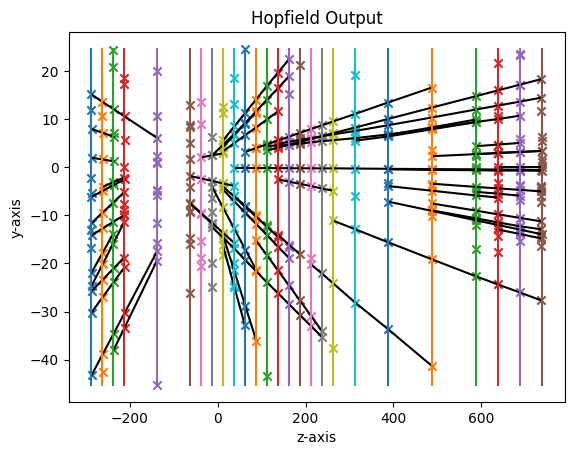

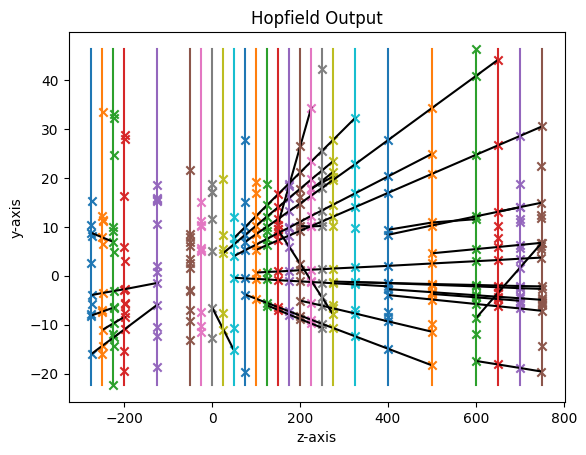

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_502

starting instance 1 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.70 seconds
energy: -294.92136751842514
energy: -249.7854456152027
energy: -281.09170181836777
energy: -257.26476800942845
energy: -307.8224323537331
energy: -271.2415030692198
energy: -266.4833890051016
energy: -253.2327563492036
energy: -253.15414459751952
energy: -278.4668816759745
[HOPFIELD] converged network by below_mean after 0 mins 28.13 seconds; (energy: -271.35)
energy: -191.8291319726981
energy: -189.42072106226718
energy: -186.50885191813953
energy: -181.05828932498483
energy: -178.6749611381066
energy: -184.1931619616223
energy: -166.10837029370714
energy: -158.82793735959854
energy: -176.37786985341708
energy: -177.16626045217083
[HOPFIELD] converged network by below_mean after 0 mins 13.17 seconds; (energy: -179.02)
[INFO] tracks extracted in 0 mins 0.04 seconds


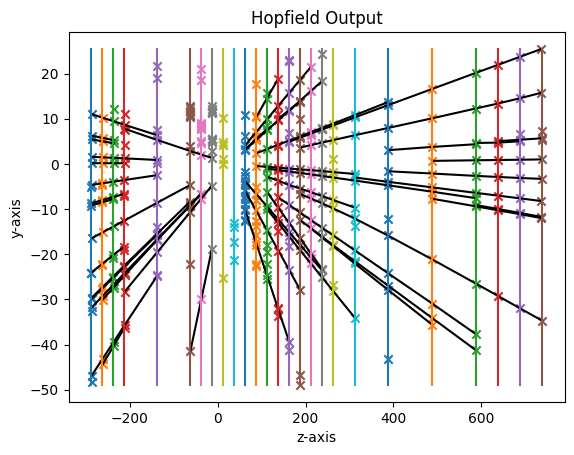

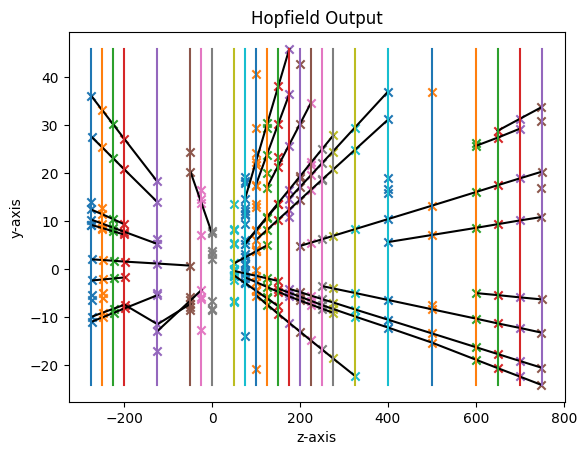

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_501

starting instance 2 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.57 seconds
energy: -397.74689890984166
energy: -348.8471931389533
energy: -389.2393615234951
energy: -371.7438926147595
energy: -371.04343047112616
energy: -383.8846972089088
energy: -413.9722346416091
energy: -383.61914968379455
energy: -382.3004088080484
energy: -348.51051445066213
[HOPFIELD] converged network by below_mean after 2 mins 17.80 seconds; (energy: -379.09)
energy: -411.0789770953485
energy: -401.958263230499
energy: -393.1201938647715
energy: -411.55648849069223
energy: -452.79553569044054
energy: -413.8903851525936
energy: -406.3963870380625
energy: -428.18221073709356
energy: -424.02318300394717
energy: -413.5032769725867
[HOPFIELD] converged network by below_mean after 2 mins 58.17 seconds; (energy: -415.65)
[INFO] tracks extracted in 0 mins 0.12 seconds


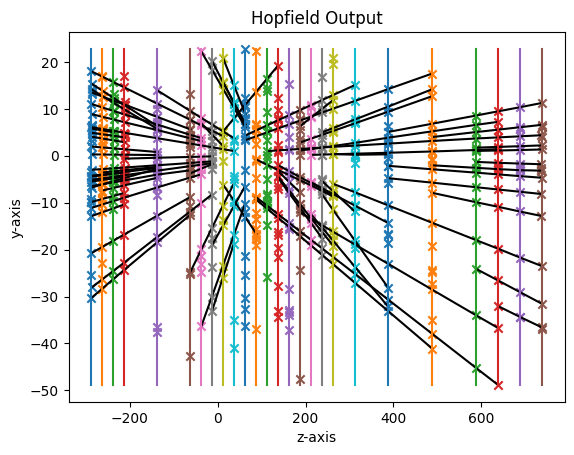

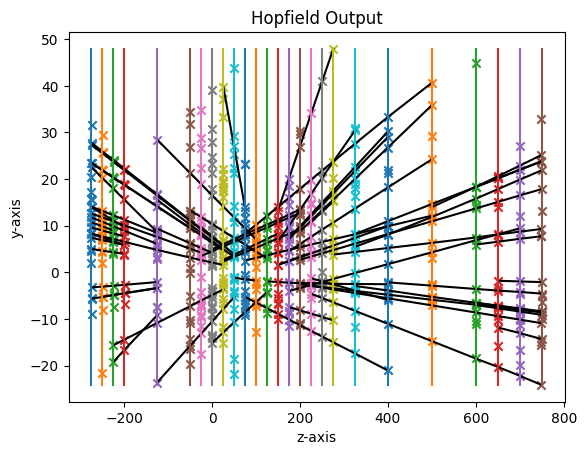

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_55

starting instance 3 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.33 seconds
energy: -556.1414149782182
energy: -527.4110072638155
energy: -563.1830131622422
energy: -554.3217278579666
energy: -533.7339315118664
energy: -532.1398119337497
energy: -554.2938694554405
energy: -463.239519398774
energy: -562.4044301873485
energy: -543.2821785999588
[HOPFIELD] converged network by below_mean after 7 mins 59.30 seconds; (energy: -539.02)
energy: -393.5838818768479
energy: -369.52153742671425
energy: -381.42816443887034
energy: -383.75031407183593
energy: -387.19591185279813
energy: -389.23750161458236
energy: -378.6638788997027
energy: -435.3024049702091
energy: -400.15309837445056
energy: -354.05850706981636
[HOPFIELD] converged network by below_mean after 4 mins 51.42 seconds; (energy: -387.29)
[INFO] tracks extracted in 0 mins 0.18 seconds


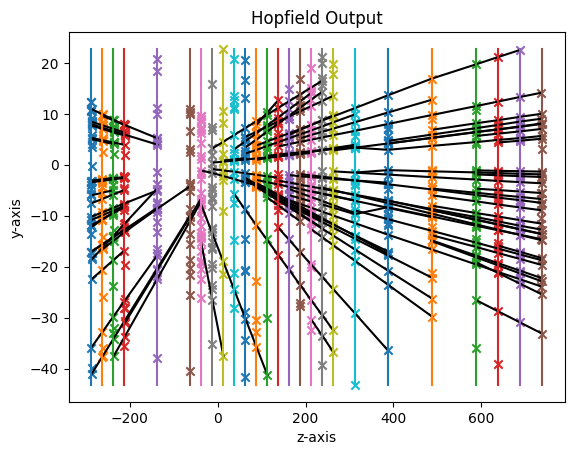

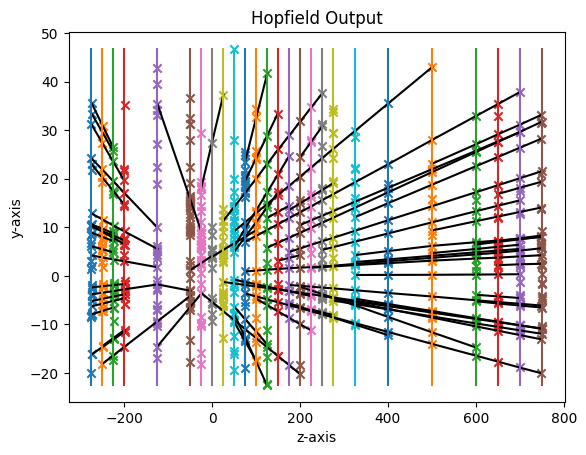

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_863

starting instance 4 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.44 seconds
energy: -393.6280841317548
energy: -428.13901424923534
energy: -399.03451776768634
energy: -438.49413861093615
energy: -416.9490990768222
energy: -432.37004846829393
energy: -421.03237320354657
energy: -396.0151821209198
energy: -419.38649822235067
energy: -407.9542333200203
[HOPFIELD] converged network by below_mean after 4 mins 0.17 seconds; (energy: -415.30)
energy: -483.29831577468786
energy: -445.6049468425974
energy: -525.8457614875798
energy: -499.4472680946367
energy: -408.0480712220168
energy: -476.4059093195989
energy: -396.50923593391116
energy: -462.415902269381
energy: -494.72152042329503
energy: -442.1730965675546
[HOPFIELD] converged network by below_mean after 2 mins 45.39 seconds; (energy: -463.45)
[INFO] tracks extracted in 0 mins 0.13 seconds


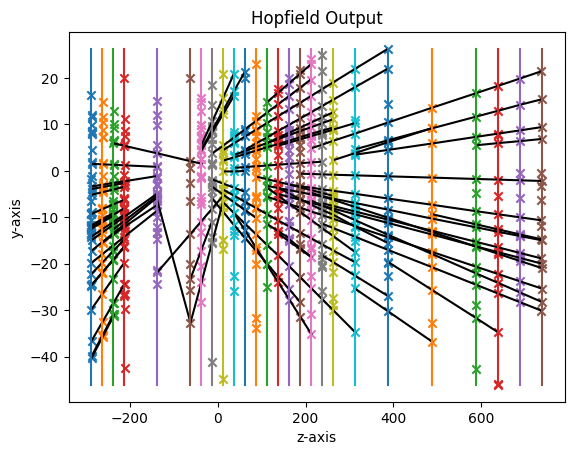

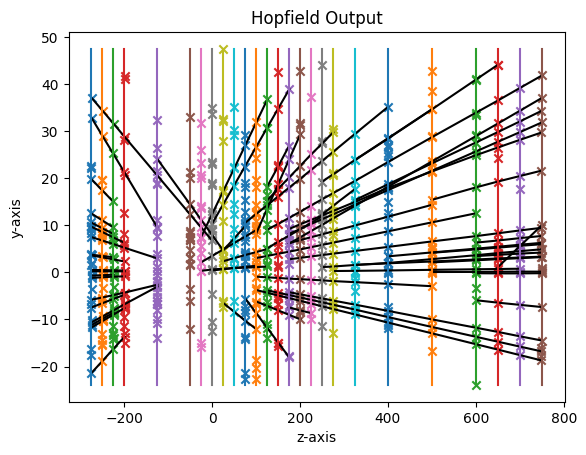

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_398

starting instance 5 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.97 seconds
energy: -535.340253613841
energy: -461.1989681245412
energy: -466.95731269471077
energy: -477.72767230349393
energy: -531.0977803570578
energy: -423.6477921085309
energy: -533.8303728453635
energy: -474.75442635379744
energy: -503.23603132872404
energy: -450.18893666328586
[HOPFIELD] converged network by below_mean after 9 mins 53.30 seconds; (energy: -485.80)
energy: -511.9687674814595
energy: -412.9453173591858
energy: -388.46280393414463
energy: -395.8971426373413
energy: -362.8738544305287
energy: -389.38081790577934
energy: -401.13276478127193
energy: -450.96257067604273
energy: -477.9515307231417
energy: -386.4468742220651
[HOPFIELD] converged network by below_mean after 7 mins 17.15 seconds; (energy: -417.80)
[INFO] tracks extracted in 0 mins 0.20 seconds


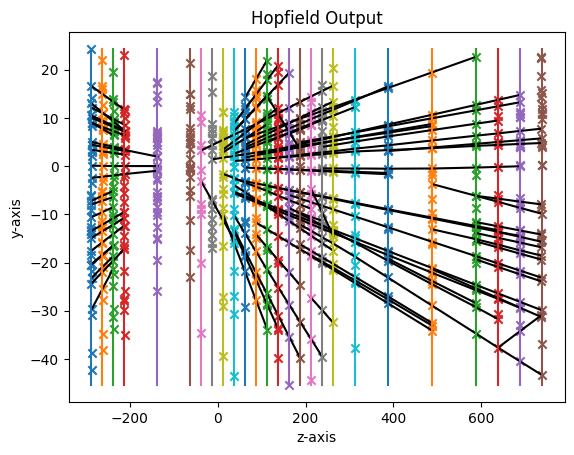

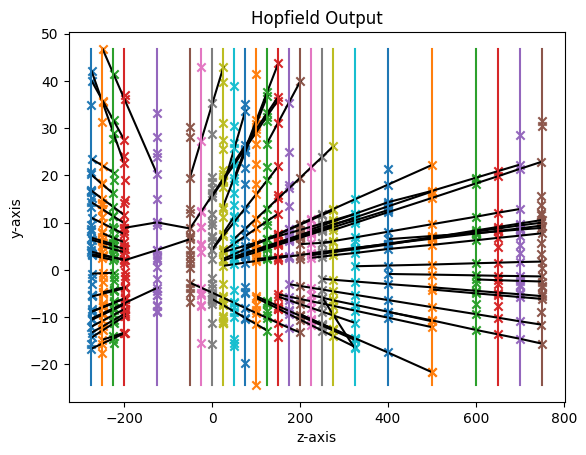

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_392
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_353
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_818
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_707
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_781
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_17

starting instance 6 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.74 seconds
energy: -520.5534676484664
energy: -580.7426327458091
energy: -539.3227254611631
energy: -602.7709302556846
energy: -417.48297564247235
energy: -480.776

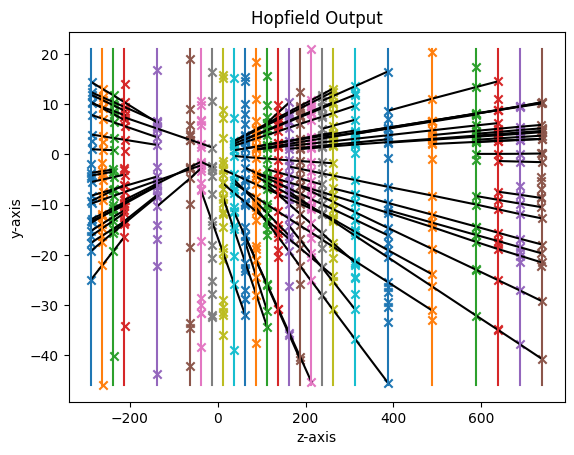

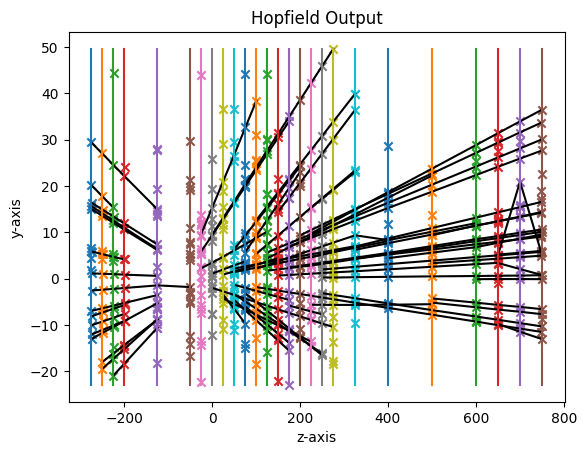

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_39

starting instance 7 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.42 seconds
energy: -156.4502356028257
energy: -159.73930866822764
energy: -158.1168703740307
energy: -170.44764707690877
energy: -175.37968586199466
energy: -171.6279925442303
energy: -156.12755336008212
energy: -175.25765783278638
energy: -148.44027136742864
energy: -154.42417929921072
[HOPFIELD] converged network by below_mean after 0 mins 12.02 seconds; (energy: -162.60)
energy: -153.90135061641772
energy: -147.1219374166546
energy: -160.5283134521323
energy: -143.66438082800835
energy: -149.5467802425204
energy: -162.3015112269242
energy: -147.7902348276438
energy: -148.09441205402715
energy: -144.0963674206475
energy: -157.94116077953927
[HOPFIELD] converged network by below_mean after 0 mins 5.51 seconds; (energy: -151.50)
[INFO] tracks extracted in 0 mins 0.03 seconds


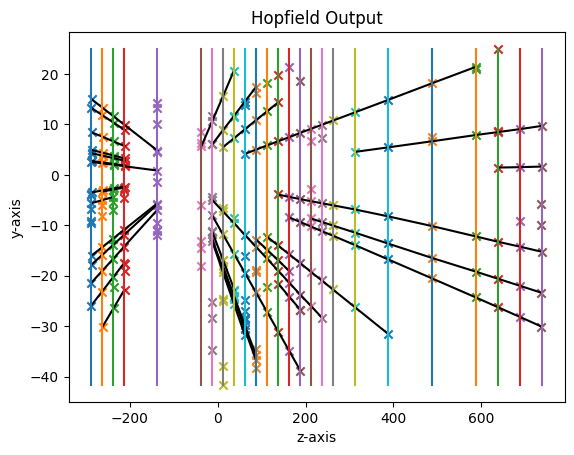

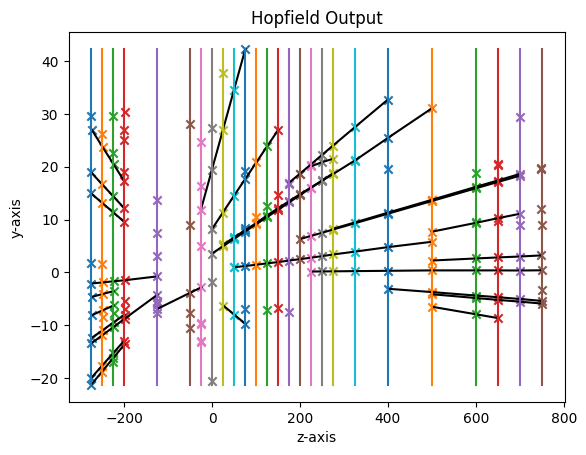

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_98

starting instance 8 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.96 seconds
energy: -250.52294711567504
energy: -243.97273704425024
energy: -254.1629926435373
energy: -239.17130129382662
energy: -219.3874641664335
energy: -233.933947555793
energy: -225.9552659534212
energy: -248.90671281916107
energy: -239.71050724366128
energy: -208.48672714807321
[HOPFIELD] converged network by below_mean after 0 mins 30.18 seconds; (energy: -236.42)
energy: -319.5159215154056
energy: -290.21012820751065
energy: -325.79985933588125
energy: -328.93216884411254
energy: -333.45752836421605
energy: -309.4212293845531
energy: -281.4551982456565
energy: -297.3189813028033
energy: -305.35406746751596
energy: -309.54853997094074
[HOPFIELD] converged network by below_mean after 0 mins 38.03 seconds; (energy: -310.10)
[INFO] tracks extracted in 0 mins 0.08 seconds


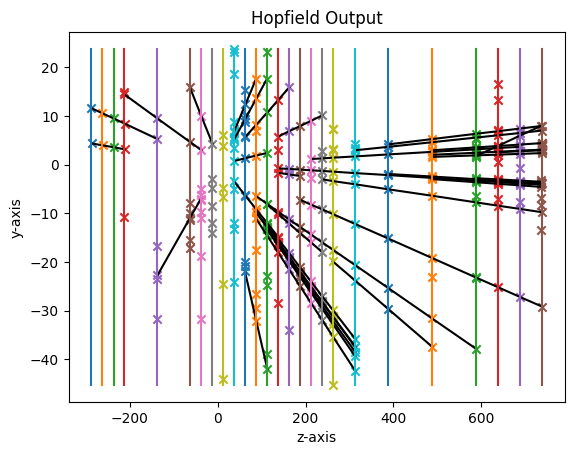

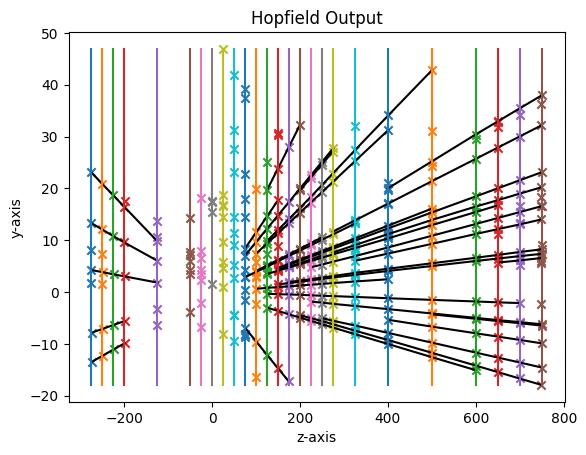

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_105
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_594
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_229
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_939
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_76
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_609

starting instance 9 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.78 seconds
energy: -439.1212950231538
energy: -529.0060798000665
energy: -487.9688049475742
energy: -464.2595650396987
energy: -436.86223745876197
energy: -421.537

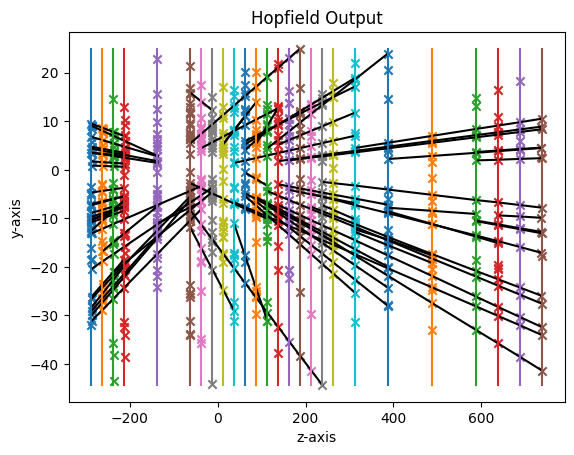

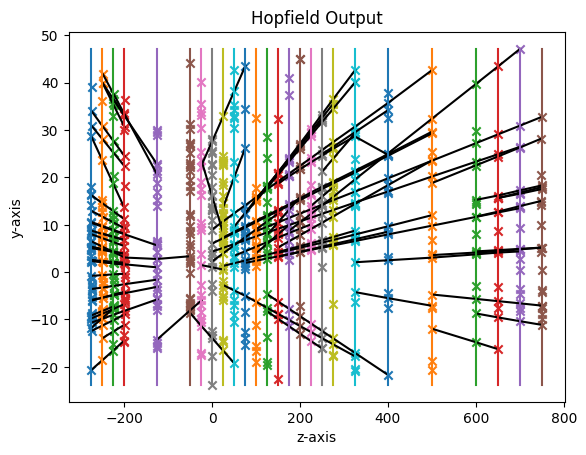

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_361
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_620

starting instance 10 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.37 seconds
energy: -275.7258738131447
energy: -255.23911261459125
energy: -247.81478478694538
energy: -272.72123882912695
energy: -273.3996629737877
energy: -276.73528893173886
energy: -249.19385827782284
energy: -262.89822453569514
energy: -275.08078196791723
energy: -276.63821371104393
[HOPFIELD] converged network by below_mean after 0 mins 49.07 seconds; (energy: -266.54)
energy: -406.8777276211367
energy: -434.75233883543825
energy: -409.8720165158408
energy: -376.30385687251584
energy: -431.31786290398003
energy: -381.74398145976164
energy: -415.42077943636014
energy: -371.7333323473898
energy: -359.3485027010755
energy: -374.77715918854744
[HOPFIELD] 

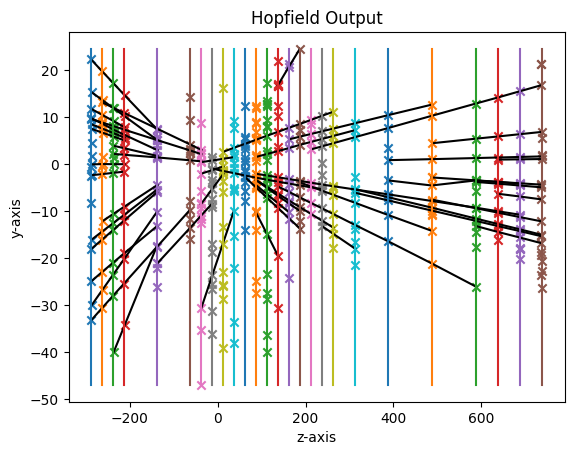

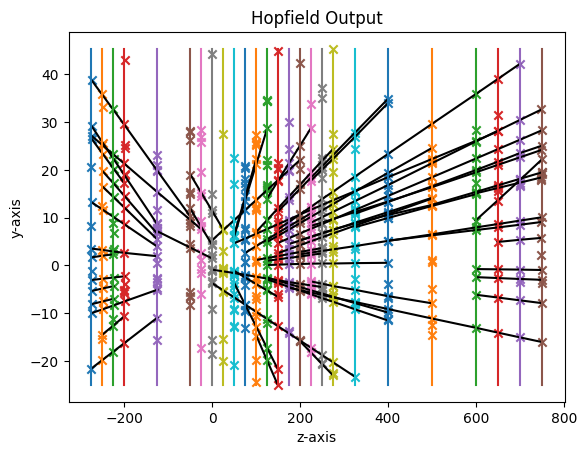

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_414

starting instance 11 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.54 seconds
energy: -449.6971805302527
energy: -308.1878957522673
energy: -353.7959801098261
energy: -452.06899850271003
energy: -420.09661475599046
energy: -395.21200881449533
energy: -371.6753983273701
energy: -314.783835731534
energy: -349.9409283351762
energy: -320.4693265107067
[HOPFIELD] converged network by below_mean after 6 mins 47.99 seconds; (energy: -373.59)
energy: -400.56934433288984
energy: -416.4589005218064
energy: -399.6173287929231
energy: -429.0666994243823
energy: -379.65030619223126
energy: -382.9703115950515
energy: -412.75930665504137
energy: -403.61456930975294
energy: -352.7929579045938
energy: -393.3300142656958
[HOPFIELD] converged network by below_mean after 2 mins 46.11 seconds; (energy: -397.08)
[INFO] tracks extracted in 0 mins 0.16 seconds


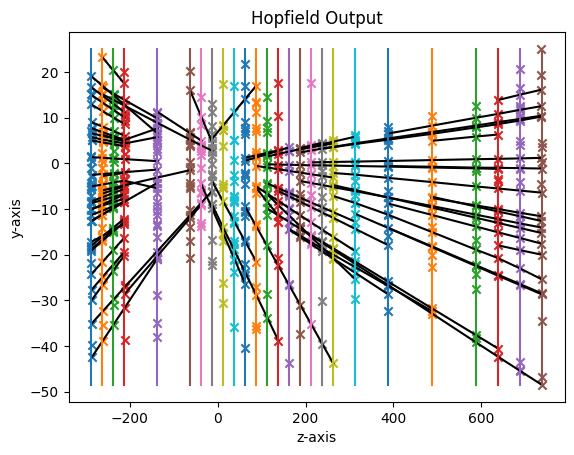

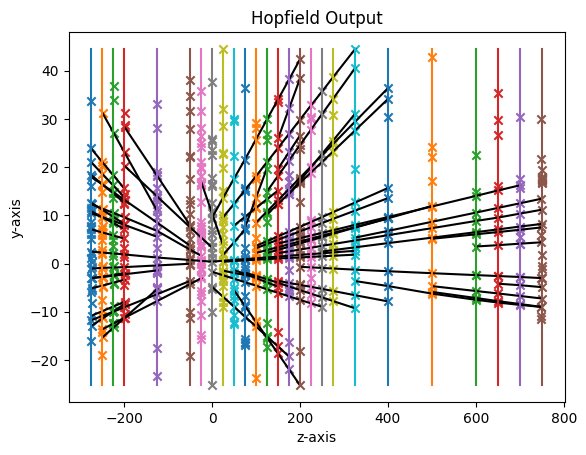

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_411

starting instance 12 out of 100

[INFO] Hopfield Networks initialized in 0 mins 9.13 seconds
energy: -444.18548840228635
energy: -434.20399440260564
energy: -416.4256195141292
energy: -430.1568549475653
energy: -466.6547448057106
energy: -408.6769743582612
energy: -392.62977862250676
energy: -432.8940273763392
energy: -432.72463365035554
energy: -495.2087843700921
[HOPFIELD] converged network by below_mean after 6 mins 1.94 seconds; (energy: -435.38)
energy: -514.3810010775684
energy: -516.9238827301835
energy: -460.71289367190934
energy: -451.12321505292425
energy: -522.1920619355511
energy: -500.28379889506186
energy: -518.7893724755546
energy: -441.30118432049335
energy: -516.5364509443739
energy: -497.77418383495217
[HOPFIELD] converged network by below_mean after 8 mins 43.02 seconds; (energy: -494.00)
[INFO] tracks extracted in 0 mins 0.19 seconds


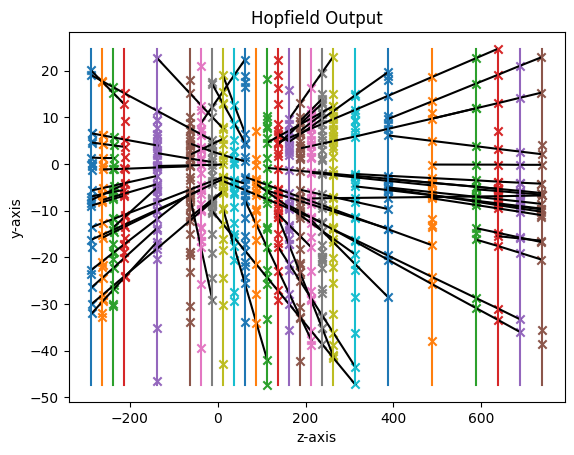

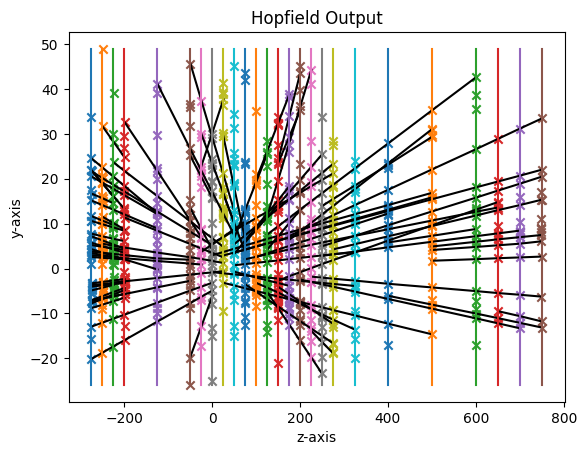

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_717
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_544

starting instance 13 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.62 seconds
energy: -332.33160153723486
energy: -332.6973638912476
energy: -369.60089279229663
energy: -343.7146477950444
energy: -426.1592423813242
energy: -346.3926375978087
energy: -363.99291426099785
energy: -373.18118653699884
energy: -406.59474711656605
energy: -384.1921036028492
[HOPFIELD] converged network by below_mean after 1 mins 42.73 seconds; (energy: -367.89)
energy: -353.66724960705864
energy: -409.28904475964515
energy: -336.6255727058005
energy: -352.44338523131387
energy: -330.61242071827996
energy: -362.152010875201
energy: -345.53405817060275
energy: -319.0959200991789
energy: -360.3658099396872
energy: -415.3594061667872
[HOPFIELD] conve

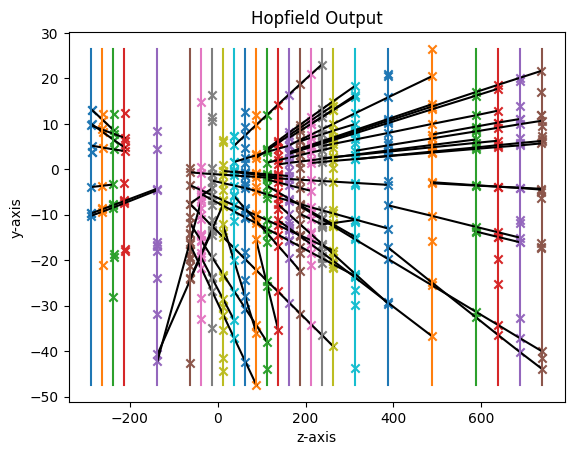

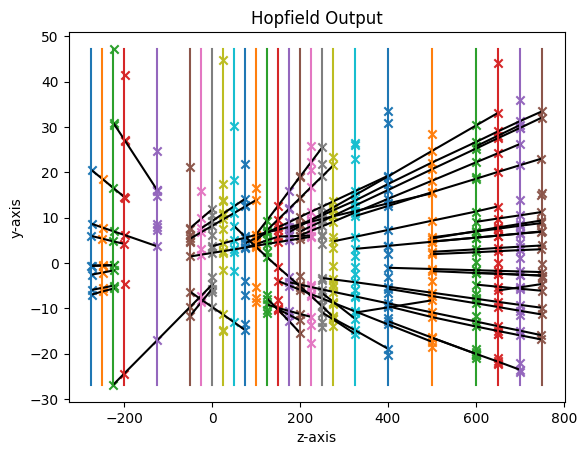

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_358
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_158
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_581

starting instance 14 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.70 seconds
energy: -318.5980167500806
energy: -330.2537943492953
energy: -320.04482616656986
energy: -353.41352962632874
energy: -340.0651129956461
energy: -349.76187996755164
energy: -345.3410574677804
energy: -330.0161892299247
energy: -338.36201664777
energy: -301.418784326977
[HOPFIELD] converged network by below_mean after 0 mins 22.91 seconds; (energy: -332.73)
energy: -205.53291994342075
energy: -213.8675968135766
energy: -186.78071112662664
energy: -210.87820967269448
energy: -216.4005127106374
energy: -223.0053274188341
ener

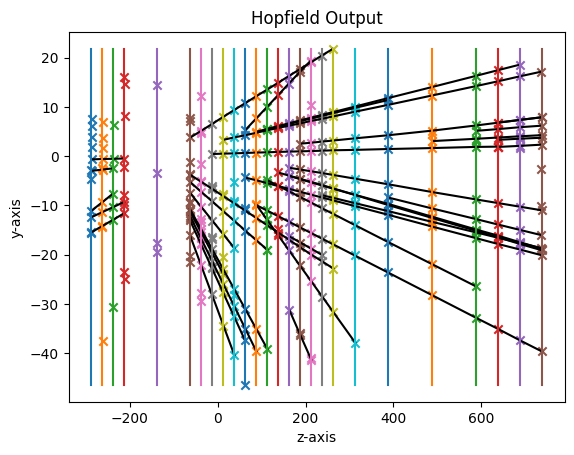

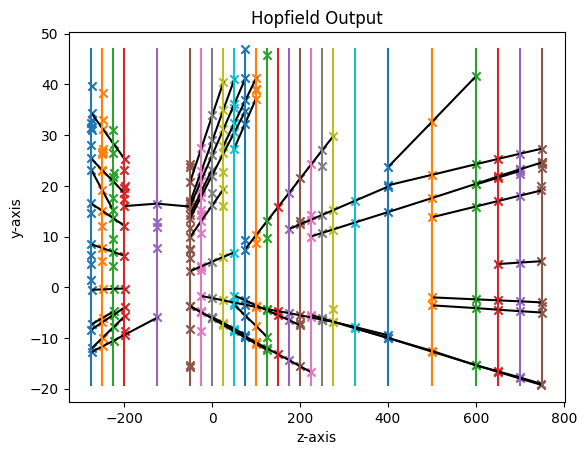

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_970

starting instance 15 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.54 seconds
energy: -389.3994222559454
energy: -484.07454202635046
energy: -380.4147363504439
energy: -387.50314807054724
energy: -381.4510965837285
energy: -384.73205429138324
energy: -383.47045950884643
energy: -404.2327557514356
energy: -451.20985593722963
energy: -458.88123911083846
[HOPFIELD] converged network by below_mean after 4 mins 29.12 seconds; (energy: -410.54)
energy: -501.63000975272735
energy: -652.6948518191625
energy: -534.6170704821108
energy: -479.3761064896779
energy: -536.8556470471974
energy: -479.09166398822344
energy: -486.1983911863698
energy: -551.9307425971537
energy: -448.9949117911651
energy: -501.1221954742146
[HOPFIELD] converged network by below_mean after 6 mins 9.81 seconds; (energy: -517.25)
[INFO] tracks extracted in 0 mins 0.21 seconds


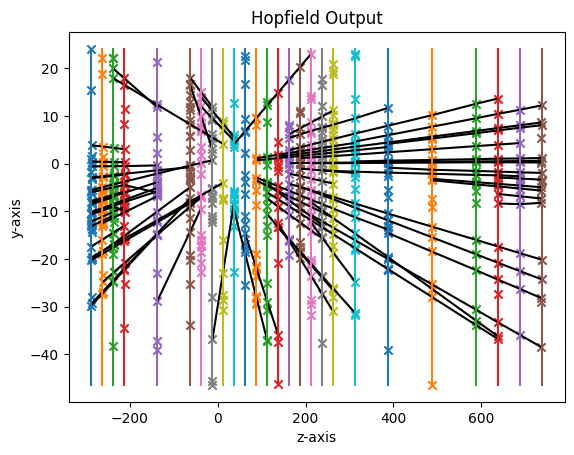

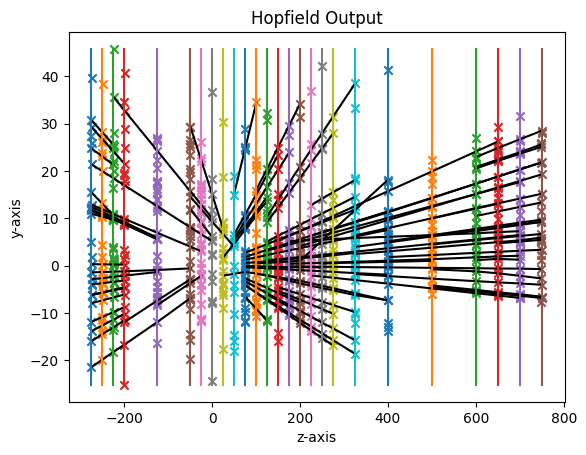

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_376

starting instance 16 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.21 seconds
energy: -439.69855215080554
energy: -437.1699970645087
energy: -407.19438750581594
energy: -336.05572062478143
energy: -366.6717231013104
energy: -360.39582015177217
energy: -428.02526059307496
energy: -334.8415087444604
energy: -415.3405210271438
energy: -450.4134791072025
[HOPFIELD] converged network by below_mean after 2 mins 7.73 seconds; (energy: -397.58)
energy: -366.06837646826443
energy: -341.29540097586823
energy: -336.1829049282463
energy: -346.2276078636154
energy: -347.46368838121396
energy: -348.13257232429044
energy: -358.6975515085805
energy: -362.31223150091245
energy: -334.13093628272406
energy: -327.06829901490505
[HOPFIELD] converged network by below_mean after 1 mins 42.37 seconds; (energy: -346.76)
[INFO] tracks extracted in 0 mins 0.11 seconds


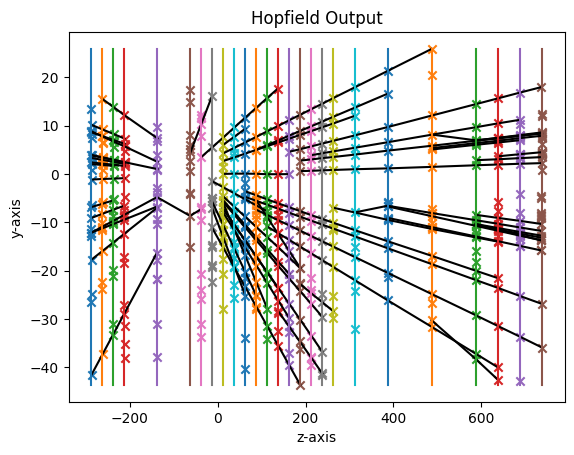

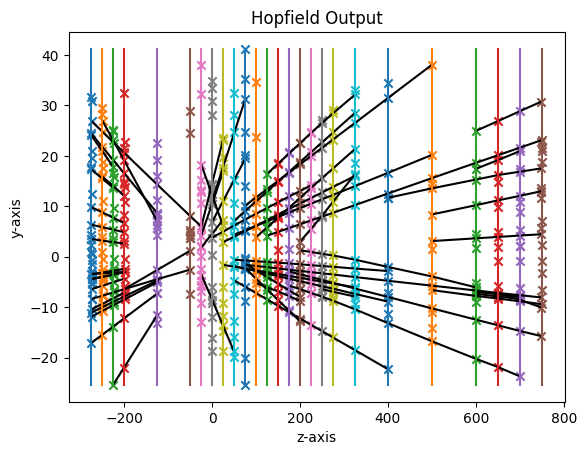

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_78
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_778

starting instance 17 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.22 seconds
energy: -348.76180304930193
energy: -339.5070838163298
energy: -336.6649221247312
energy: -341.6625067837257
energy: -336.44408451425744
energy: -330.51069886281687
energy: -329.5700275781463
energy: -336.6253404289173
energy: -340.4077574950203
energy: -359.6584950427177
[HOPFIELD] converged network by below_mean after 0 mins 59.57 seconds; (energy: -339.98)
energy: -479.9320227208508
energy: -423.8966938932791
energy: -409.11507782051063
energy: -433.90577304764605
energy: -376.28175683431687
energy: -431.2604498767721
energy: -438.3982307284782
energy: -427.3051451838544
energy: -451.36659325053444
energy: -407.86443351897765
[HOPFIELD] converg

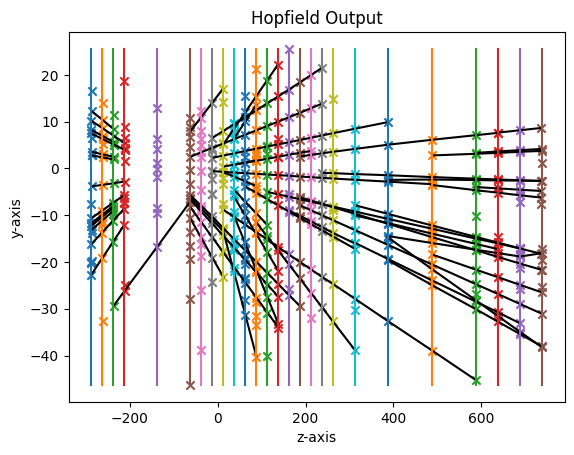

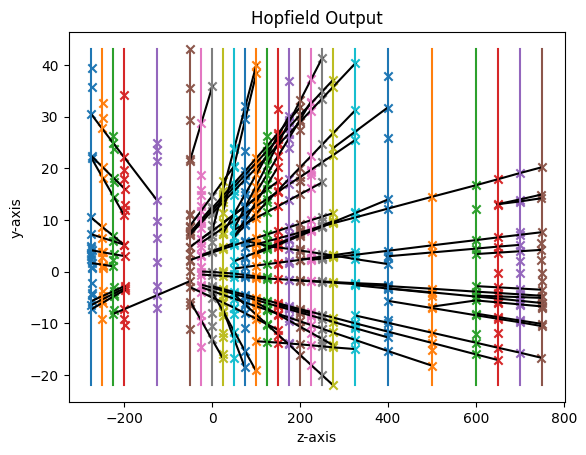

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_79

starting instance 18 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.22 seconds
energy: -356.7630563942769
energy: -357.44215555488944
energy: -407.3695193455837
energy: -441.9438777749922
energy: -377.8604030585036
energy: -371.2126759012829
energy: -375.3570368891187
energy: -423.3190942436088
energy: -364.0132955809993
energy: -388.9140284598096
[HOPFIELD] converged network by below_mean after 6 mins 38.14 seconds; (energy: -386.42)
energy: -337.1846010668467
energy: -365.37100525221854
energy: -337.89568236954506
energy: -394.44689594281255
energy: -454.1824708941325
energy: -386.93487131586653
energy: -386.11576719451307
energy: -332.17236359283766
energy: -324.06976176971506
energy: -358.11518109721374
[HOPFIELD] converged network by below_mean after 7 mins 2.24 seconds; (energy: -367.65)
[INFO] tracks extracted in 0 mins 0.17 seconds


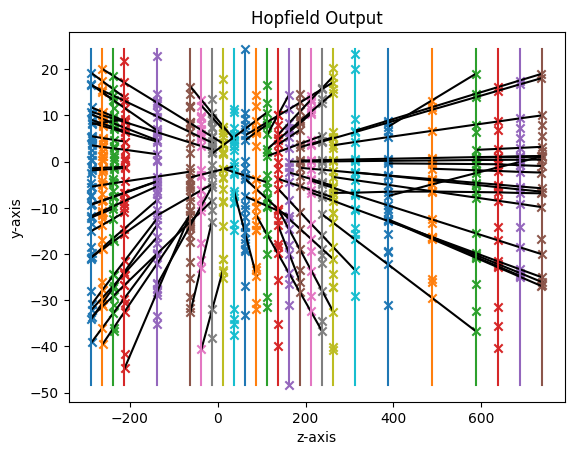

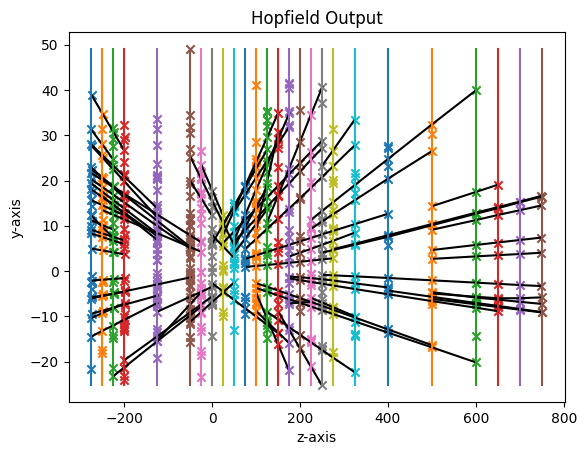

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_476
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_70

starting instance 19 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.25 seconds
energy: -168.96259674532854
energy: -152.65440943640033
energy: -155.91956604083632
energy: -154.5511229337203
energy: -154.8157821738068
energy: -152.7055021870293
energy: -148.63336420420342
energy: -143.30810672203316
energy: -154.59964827474047
energy: -155.0461599814702
[HOPFIELD] converged network by below_mean after 0 mins 8.27 seconds; (energy: -154.12)
energy: -67.65095474616116
energy: -68.36916531400438
energy: -71.15416493484673
energy: -71.62482065120274
energy: -65.36000088029881
energy: -64.80259913760999
energy: -71.61276369441721
energy: -63.83521898826647
energy: -69.04245046409348
energy: -64.72433537257865
[HOPFIELD] converged 

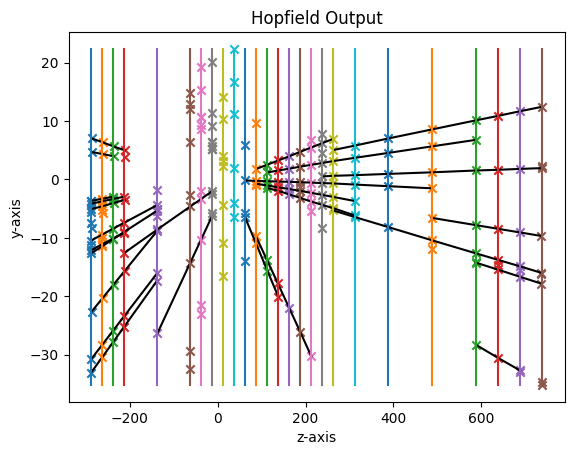

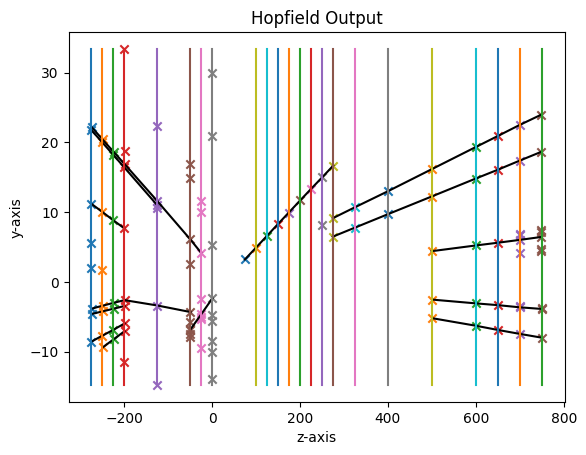

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_59

starting instance 20 out of 100

[INFO] Hopfield Networks initialized in 0 mins 12.58 seconds
energy: -643.0935547465497
energy: -659.9060484524358
energy: -627.2435485618831
energy: -691.1076196027019
energy: -728.306854039832
energy: -687.3674826546585
energy: -852.0970578084558
energy: -692.3924334510114
energy: -666.7954293736724
energy: -664.6417178552041
[HOPFIELD] converged network by below_mean after 16 mins 53.01 seconds; (energy: -691.30)
energy: -485.9706422292381
energy: -516.3498163498755
energy: -602.4879023916899
energy: -516.1315181581007
energy: -461.97118823181256
energy: -453.32007477453146
energy: -496.9601908070126
energy: -486.45115246597766
energy: -482.4561442634235
energy: -546.5904486573318
[HOPFIELD] converged network by below_mean after 8 mins 32.72 seconds; (energy: -504.87)
[INFO] tracks extracted in 0 mins 0.26 seconds


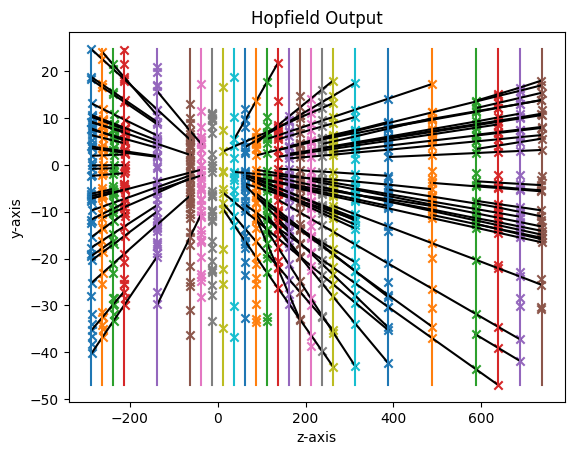

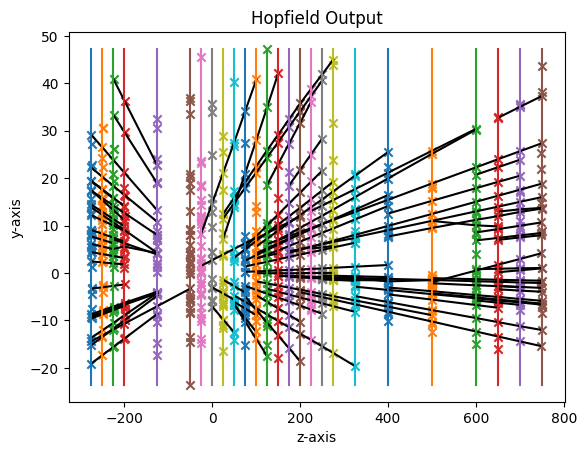

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_341

starting instance 21 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.31 seconds
energy: -174.96963256319472
energy: -163.14255885287903
energy: -156.06210211650298
energy: -163.28413716823638
energy: -162.36413472888614
energy: -179.35134697376313
energy: -161.1437459040916
energy: -165.36326912568384
energy: -153.01594060457467
energy: -162.56157890512154
[HOPFIELD] converged network by below_mean after 0 mins 10.03 seconds; (energy: -164.13)
energy: -131.44641100148317
energy: -136.0724128520625
energy: -142.50517099541858
energy: -133.71779220910048
energy: -140.49764975080964
energy: -145.97667436474683
energy: -129.56465740802474
energy: -126.85229226419983
energy: -132.69658994795643
energy: -138.34039286139648
[HOPFIELD] converged network by below_mean after 0 mins 4.58 seconds; (energy: -135.77)
[INFO] tracks extracted in 0 mins 0.02 second

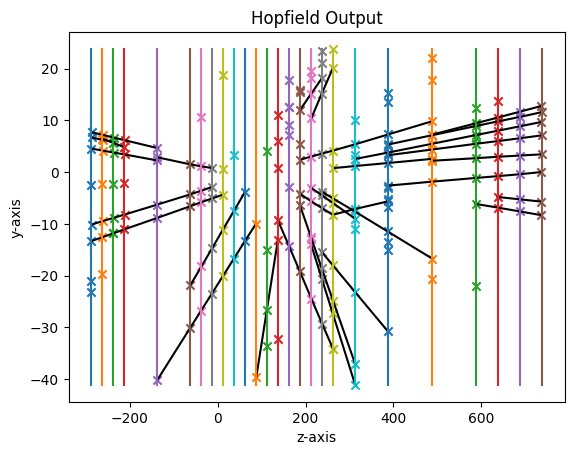

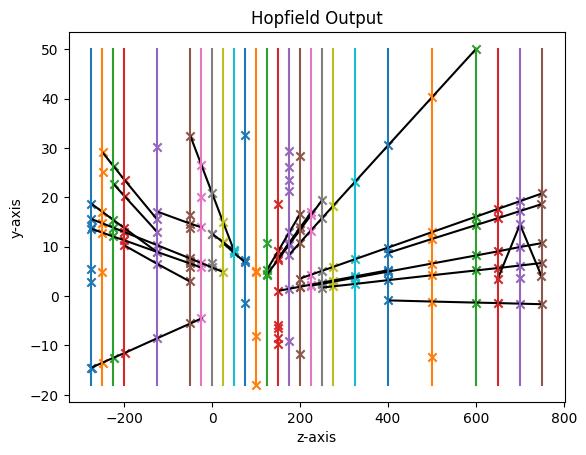

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_10
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_430
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_169

starting instance 22 out of 100

[INFO] Hopfield Networks initialized in 0 mins 12.00 seconds
energy: -435.301348427682
energy: -418.85263760896083
energy: -518.8500930747329
energy: -517.3376483492763
energy: -443.6200351042828
energy: -556.960858046257
energy: -514.7953576464633
energy: -567.0856650057025
energy: -567.6170594009328
energy: -468.1720306459459
[HOPFIELD] converged network by below_mean after 7 mins 52.54 seconds; (energy: -500.86)
energy: -591.8075740740219
energy: -426.57526920267236
energy: -449.80023473628074
energy: -512.5448748839366
energy: -548.5607813552674
energy: -517.7486096733212
energy

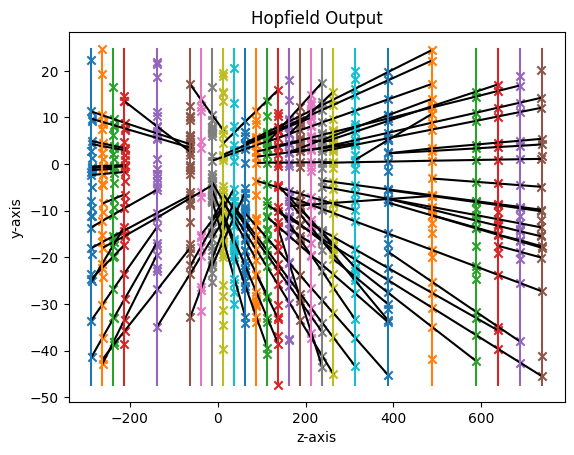

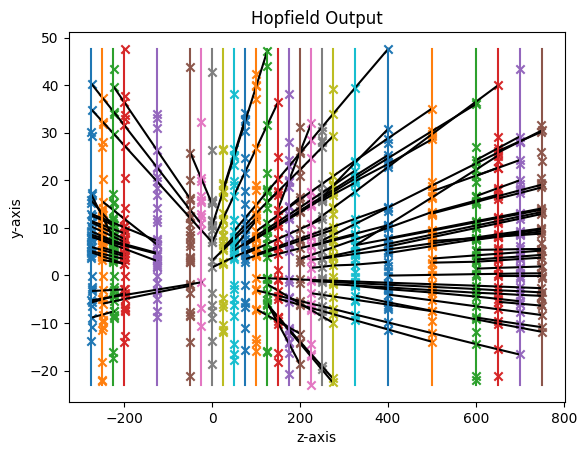

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_350

starting instance 23 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.07 seconds
energy: -278.3362163746035
energy: -249.36864918814425
energy: -274.8208554776594
energy: -278.28185406006645
energy: -272.6651972886432
energy: -279.28219140958777
energy: -257.9511593074205
energy: -256.28860935835786
energy: -291.4817154024201
energy: -244.9909885288045
[HOPFIELD] converged network by below_mean after 0 mins 44.01 seconds; (energy: -268.35)
energy: -393.1542598940943
energy: -411.88338149980785
energy: -355.96211729277763
energy: -391.3800585457169
energy: -396.67592884942553
energy: -352.3181160140724
energy: -373.73959166730924
energy: -394.2174076185489
energy: -402.8109529349286
energy: -373.7987381564577
[HOPFIELD] converged network by below_mean after 1 mins 42.28 seconds; (energy: -384.59)
[INFO] tracks extracted in 0 mins 0.08 seconds


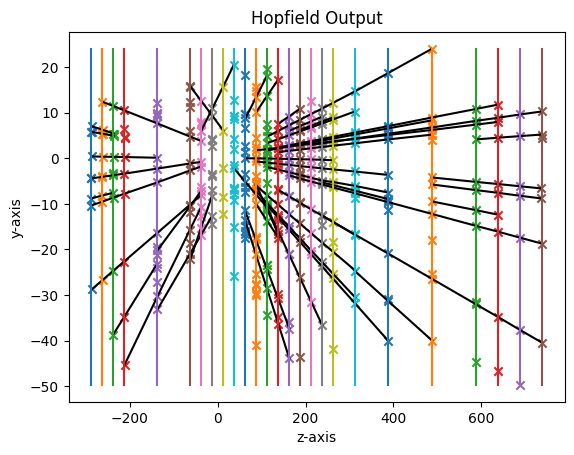

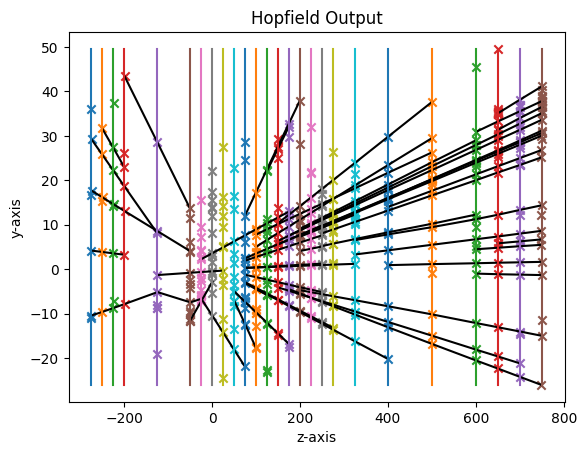

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_155

starting instance 24 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.02 seconds
energy: -509.8671038703355
energy: -524.5582184664975
energy: -543.5794866462115
energy: -570.3613379427493
energy: -534.2943354594196
energy: -560.769544580202
energy: -489.1472362326411
energy: -547.7548348656879
energy: -545.8248296364021
energy: -575.551727391881
[HOPFIELD] converged network by below_mean after 10 mins 45.50 seconds; (energy: -540.17)
energy: -355.76166268505875
energy: -558.4418844549875
energy: -416.63681820863206
energy: -435.2720083199827
energy: -380.53649234500523
energy: -376.1521108973202
energy: -394.5060166285873
energy: -440.0496519364203
energy: -394.7325088952655
energy: -517.6672509049732
[HOPFIELD] converged network by below_mean after 9 mins 55.09 seconds; (energy: -426.98)
[INFO] tracks extracted in 0 mins 0.21 seconds


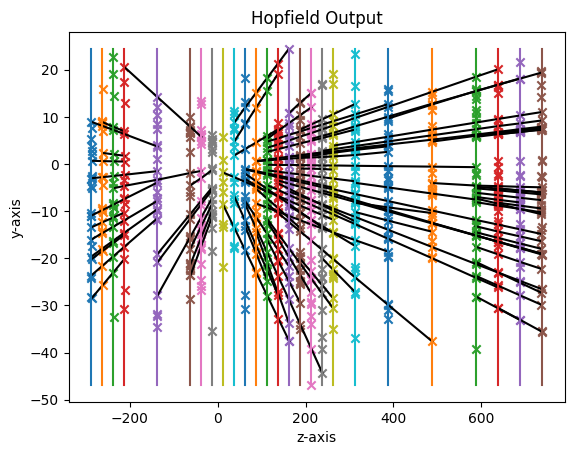

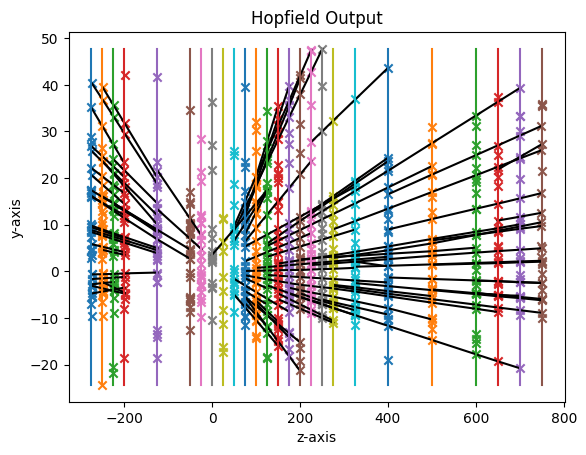

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_500
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_584

starting instance 25 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.52 seconds
energy: -282.79286596389863
energy: -290.7359863671155
energy: -247.30375943397547
energy: -311.3436127429293
energy: -277.3639670952658
energy: -295.7602083988226
energy: -371.3018706322283
energy: -280.8750978995402
energy: -308.4160425683993
energy: -292.06326368913693
[HOPFIELD] converged network by below_mean after 1 mins 4.20 seconds; (energy: -295.80)
energy: -467.7449652245325
energy: -467.32872960505284
energy: -571.3623988297543
energy: -601.5037659532406
energy: -467.77477615886187
energy: -493.5162222788829
energy: -566.4753264335924
energy: -451.39964460385636
energy: -552.3396888465669
energy: -576.0160496055333
[HOPFIELD] converged

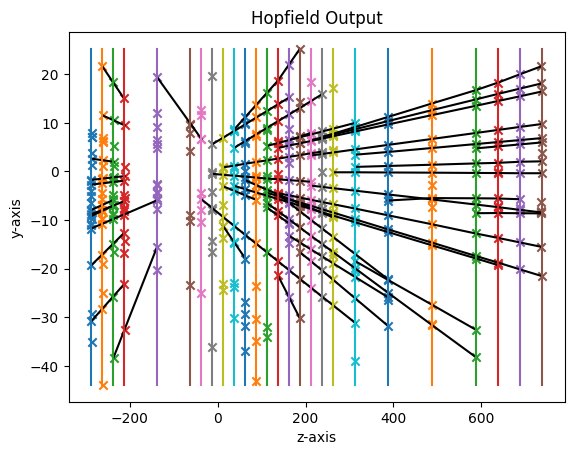

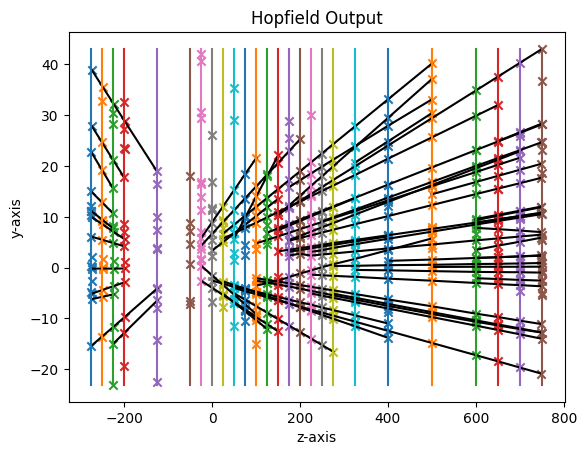

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_186
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_445
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_313
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_949
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_757
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_538

starting instance 26 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.87 seconds
energy: -563.1904351501728
energy: -521.7855007456933
energy: -556.138395967668
energy: -547.6449771473816
energy: -493.620237615155
energy: -552.4935

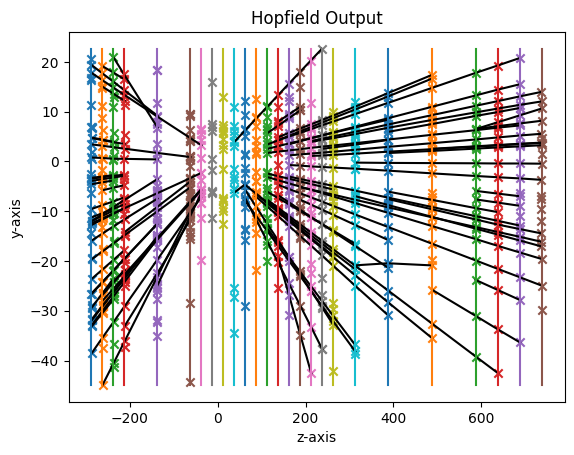

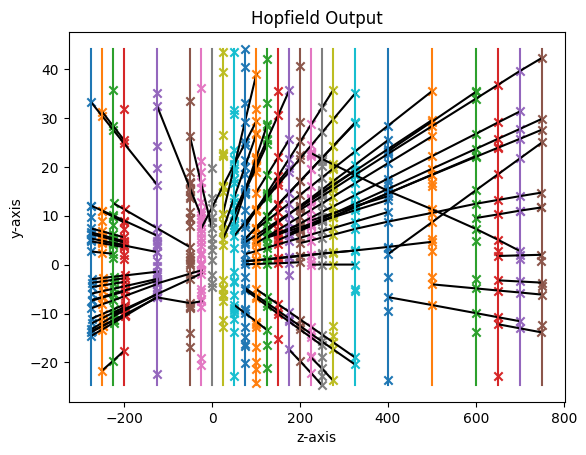

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_519
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_511
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_928
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_906
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_342

starting instance 27 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.60 seconds
energy: -319.4847233488221
energy: -318.68604032028486
energy: -304.87640356979324
energy: -322.06817800264764
energy: -326.90961670740126
energy: -304.46715893179686
energy: -300.5147690201987
energy: -317.26940422588655
energy: -306.631833445339
energy: -312.9215364345951
[

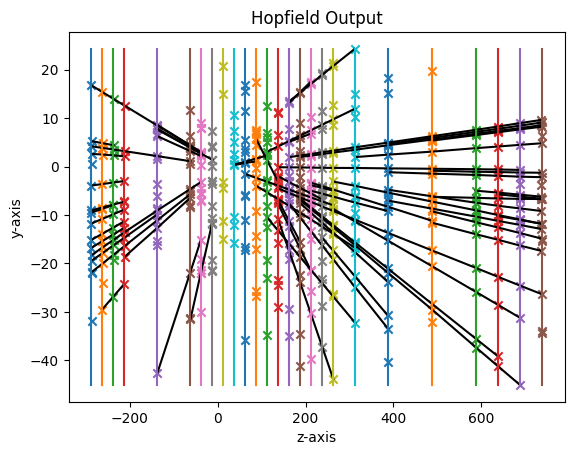

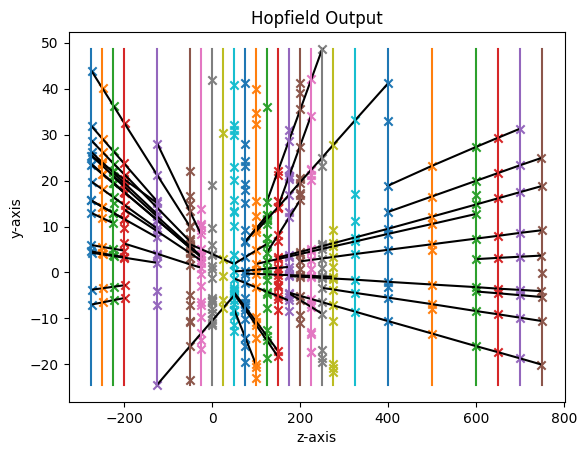

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_701
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_448

starting instance 28 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.16 seconds
energy: -508.2861826132953
energy: -470.0374986098841
energy: -468.75631215682483
energy: -412.13928261467
energy: -434.5824172834611
energy: -452.52912822965664
energy: -452.7493325576134
energy: -487.90151308764484
energy: -408.9125024954323
energy: -429.93622783186527
[HOPFIELD] converged network by below_mean after 4 mins 51.84 seconds; (energy: -452.58)
energy: -347.74413276980545
energy: -332.86562475274104
energy: -345.8750551432271
energy: -362.92348218233894
energy: -372.22421873836123
energy: -282.91948335483477
energy: -343.92178504582154
energy: -373.56714631615483
energy: -286.9325338547718
energy: -359.09170322077136
[HOPFIELD] conv

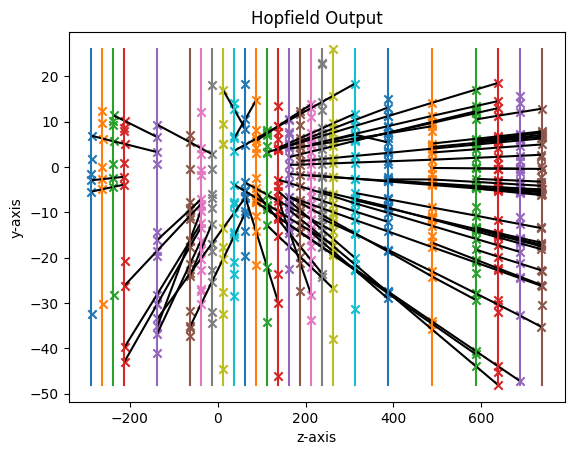

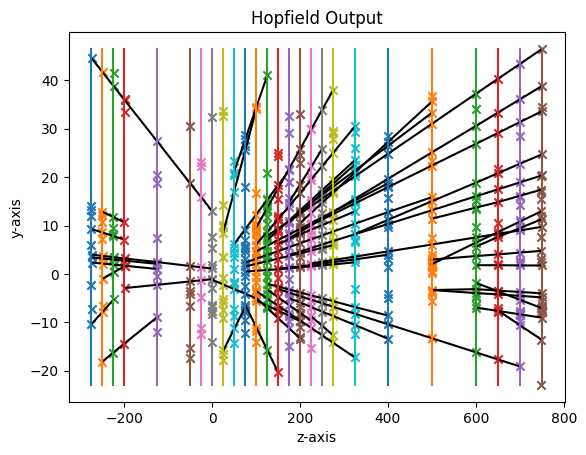

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_183

starting instance 29 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.19 seconds
energy: -332.3719574245368
energy: -300.3684007945039
energy: -302.69267322202137
energy: -285.59644240157655
energy: -310.2394290611569
energy: -293.13639335531036
energy: -307.6632123087394
energy: -303.2859440962634
energy: -275.20302788074383
energy: -281.7201847813248
[HOPFIELD] converged network by below_mean after 0 mins 53.67 seconds; (energy: -299.23)
energy: -322.4671667480289
energy: -269.45487397998284
energy: -284.33990917439496
energy: -337.4791398570992
energy: -314.75499874257883
energy: -314.3202355355294
energy: -345.1840348857034
energy: -329.23419484418207
energy: -318.9299955564279
energy: -307.8745204622753
[HOPFIELD] converged network by below_mean after 0 mins 55.66 seconds; (energy: -314.40)
[INFO] tracks extracted in 0 mins 0.07 seconds


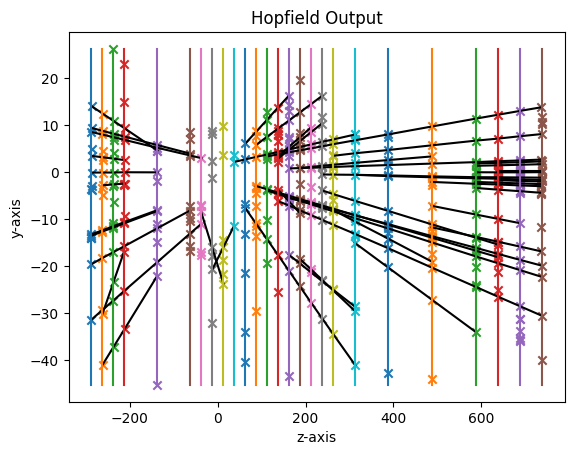

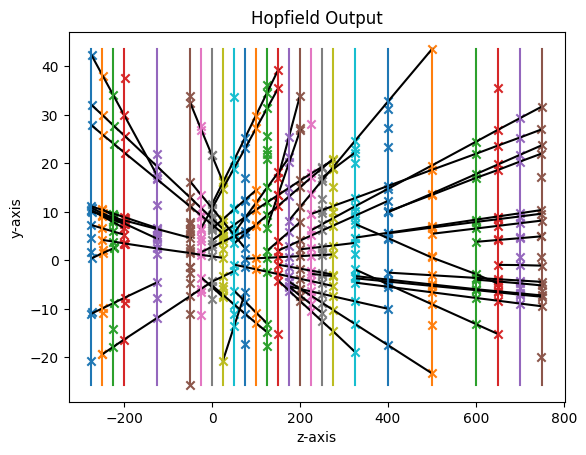

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_28

starting instance 30 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.51 seconds
energy: -408.3234304607292
energy: -425.59092370566634
energy: -383.5870039473746
energy: -381.52245658309863
energy: -422.60246882896024
energy: -393.9872079115709
energy: -424.5625242887534
energy: -421.78741154523186
energy: -467.71331410598566
energy: -373.5044550715078
[HOPFIELD] converged network by below_mean after 2 mins 22.76 seconds; (energy: -410.32)
energy: -515.6819239481844
energy: -477.4080226145103
energy: -475.5022985574453
energy: -517.5567339705714
energy: -513.7618403726341
energy: -628.9991688721324
energy: -548.750787723645
energy: -481.1344541834478
energy: -579.7796221751008
energy: -521.7596863095262
[HOPFIELD] converged network by below_mean after 5 mins 20.02 seconds; (energy: -526.03)
[INFO] tracks extracted in 0 mins 0.16 seconds


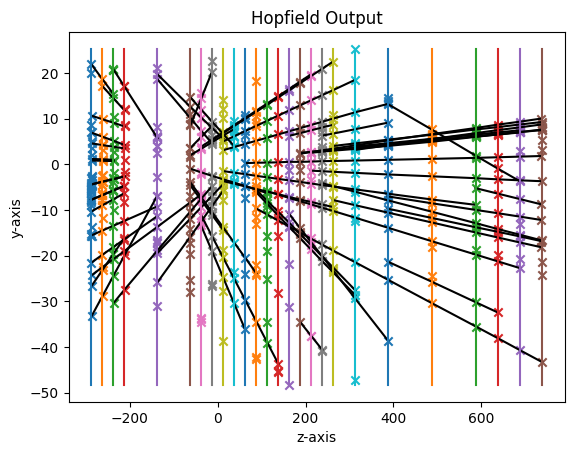

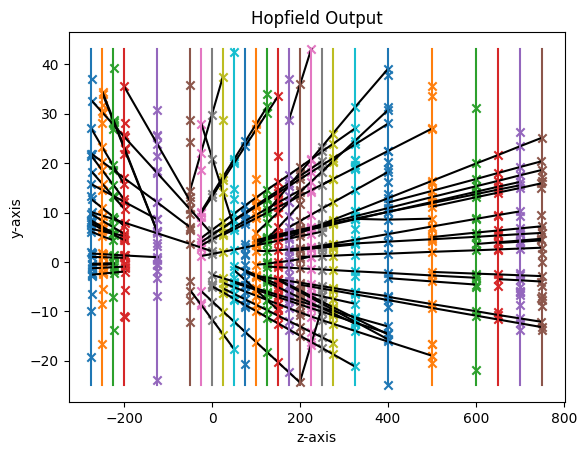

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_156
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_95
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_172
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_889

starting instance 31 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.16 seconds
energy: -257.216084838777
energy: -256.9758607749399
energy: -266.0954939018701
energy: -249.13499527249652
energy: -245.56176474637383
energy: -262.11539916298744
energy: -268.09539622232194
energy: -257.59384460459626
energy: -240.53409311515398
energy: -244.48668178160872
[HOPFIELD] converged network by below_mean after 0 mins 45.73 seconds; (energy: -254.78)
energy: -184.69289174552802
energy: -2

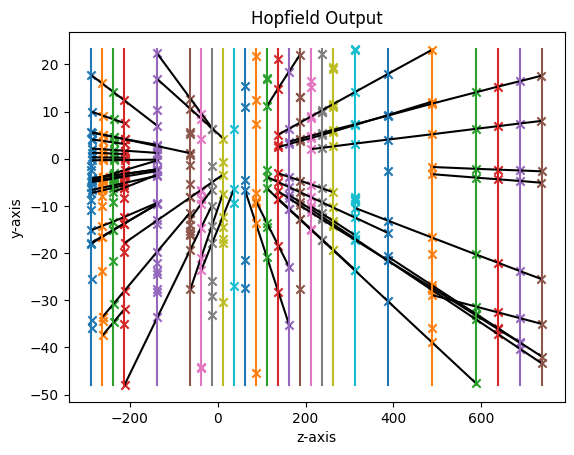

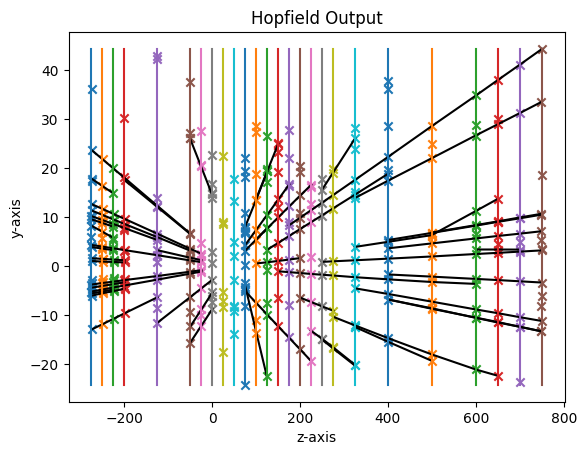

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_397
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_523
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_767

starting instance 32 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.81 seconds
energy: -575.6606479794137
energy: -529.7418444758049
energy: -467.7942199462108
energy: -531.29265848901
energy: -541.8049773033724
energy: -532.6106620151679
energy: -608.6317441851742
energy: -501.7387112549207
energy: -489.9159504835847
energy: -505.89804303824064
[HOPFIELD] converged network by below_mean after 8 mins 12.26 seconds; (energy: -528.51)
energy: -483.2229893081067
energy: -562.264803266159
energy: -519.3429768210599
energy: -506.6108569537496
energy: -499.35942886878786
energy: -671.8682995156104
energy:

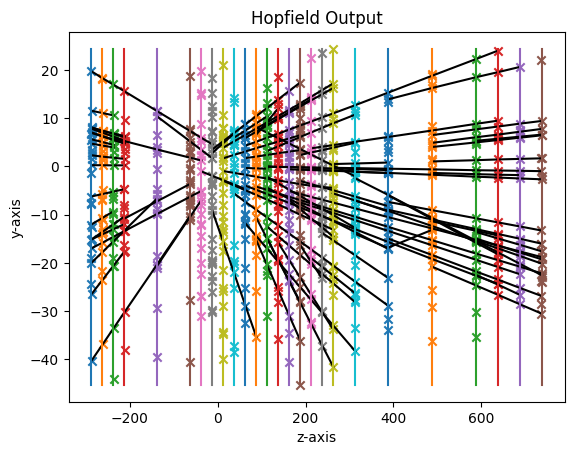

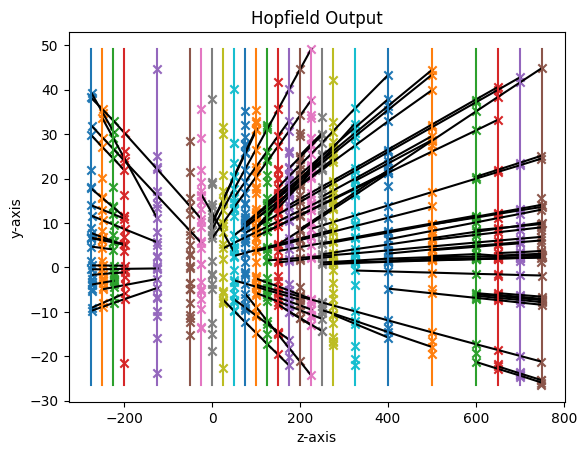

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_314

starting instance 33 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.81 seconds
energy: -181.3605746796621
energy: -187.6030862768034
energy: -196.47102362221509
energy: -166.66477451514004
energy: -184.876475738513
energy: -196.24134931476334
energy: -191.04427600692063
energy: -206.63851160501585
energy: -201.64497184695753
energy: -186.7494521393651
[HOPFIELD] converged network by below_mean after 0 mins 12.57 seconds; (energy: -189.93)
energy: -184.4861460606998
energy: -189.940514845122
energy: -183.8831168903924
energy: -157.63888072269563
energy: -165.55933448848012
energy: -178.5807415262283
energy: -174.481416334049
energy: -182.03542097951467
energy: -173.04220559744186
energy: -186.48494337503192
[HOPFIELD] converged network by below_mean after 0 mins 20.22 seconds; (energy: -177.61)
[INFO] tracks extracted in 0 mins 0.04 seconds


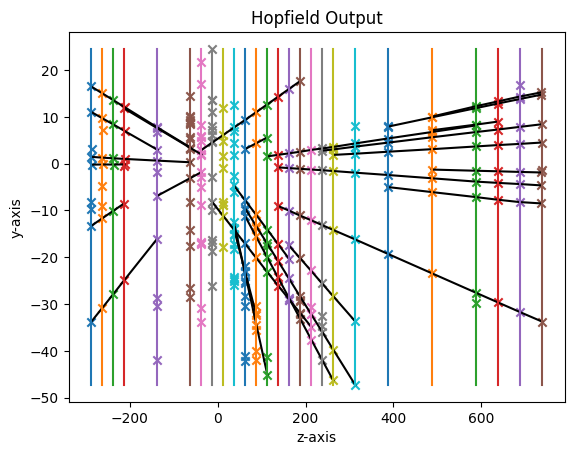

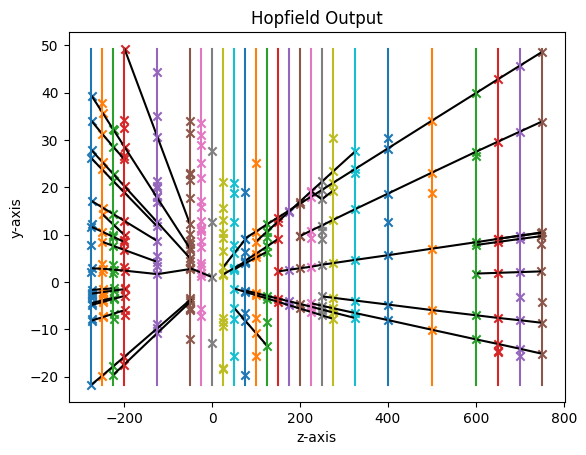

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_752
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_895

starting instance 34 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.55 seconds
energy: -214.24663305111835
energy: -217.44239042253403
energy: -205.62920921725572
energy: -196.1758759328366
energy: -206.57340756902548
energy: -222.08091970676716
energy: -212.22896715781917
energy: -216.64411142027473
energy: -208.3680670849297
energy: -213.3201904470727
[HOPFIELD] converged network by below_mean after 0 mins 14.75 seconds; (energy: -211.27)
energy: -275.00681953109216
energy: -277.7804329501311
energy: -289.1730286679441
energy: -279.7420794676728
energy: -263.6549892378723
energy: -284.66171725522
energy: -272.4281217246333
energy: -260.14145549123407
energy: -282.26177706453745
energy: -264.2129201577672
[HOPFIELD] conver

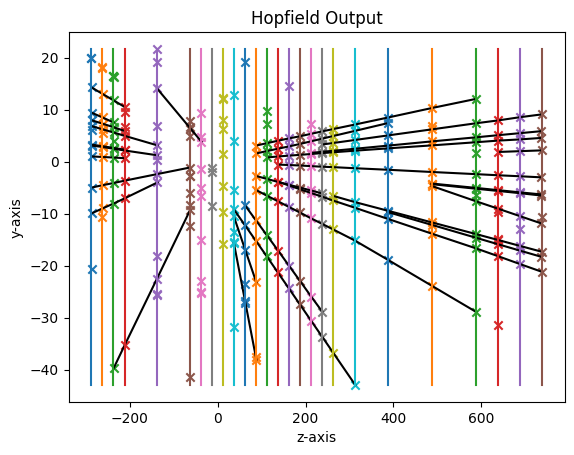

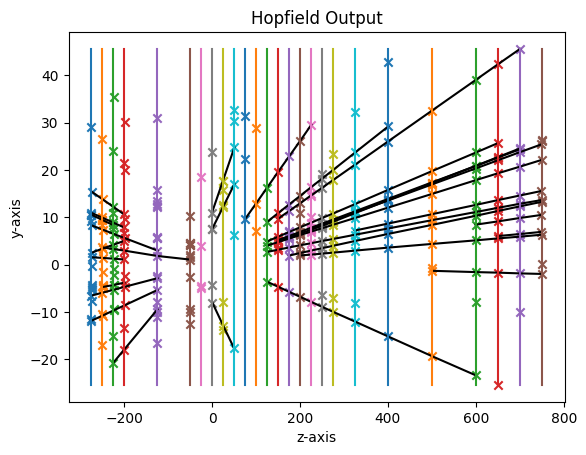

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_390
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_266
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_935

starting instance 35 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.87 seconds
energy: -428.45754995600896
energy: -427.66104884301603
energy: -434.63480185940716
energy: -321.20552703825433
energy: -427.4033801256203
energy: -421.45368499892584
energy: -440.0436216661885
energy: -345.339901253222
energy: -375.58445819149216
energy: -380.50457901013795
[HOPFIELD] converged network by below_mean after 3 mins 28.56 seconds; (energy: -400.23)
energy: -401.6901777259718
energy: -360.1988672148046
energy: -539.1388202233157
energy: -455.75896894259154
energy: -490.0569670282242
energy: -433.7044706670069


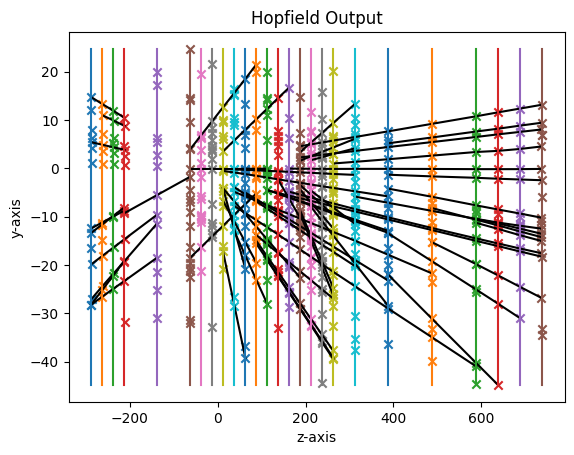

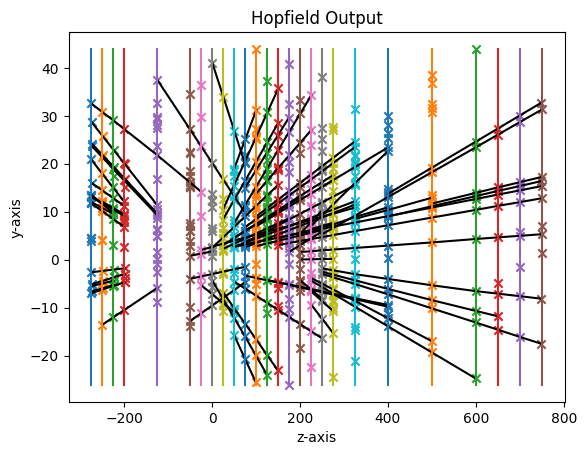

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_43

starting instance 36 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.29 seconds
energy: -452.80553193907593
energy: -459.8408554714177
energy: -514.7806505883806
energy: -420.7361560773695
energy: -477.25822409708974
energy: -451.9721190714604
energy: -509.43929293321264
energy: -457.2486698339576
energy: -476.06960883578665
energy: -454.73106353831184
[HOPFIELD] converged network by below_mean after 5 mins 47.28 seconds; (energy: -467.49)
energy: -469.83897118110275
energy: -438.23114105525906
energy: -393.08488537186935
energy: -412.39815564118084
energy: -356.8773230863171
energy: -370.68193335162135
energy: -400.08094728725086
energy: -437.97238451501596
energy: -364.9529074128542
energy: -367.63816459278365
[HOPFIELD] converged network by below_mean after 2 mins 7.47 seconds; (energy: -401.18)
[INFO] tracks extracted in 0 mins 0.17 seconds


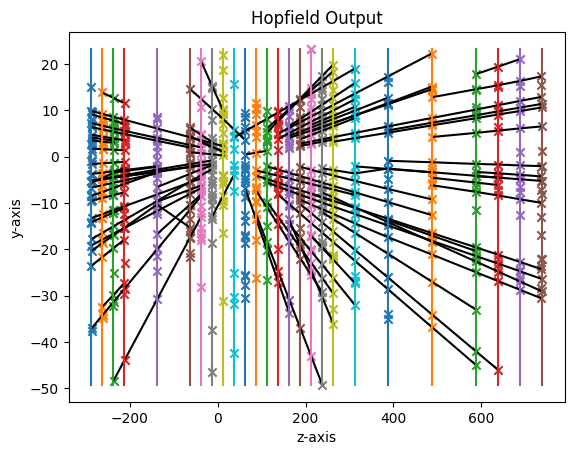

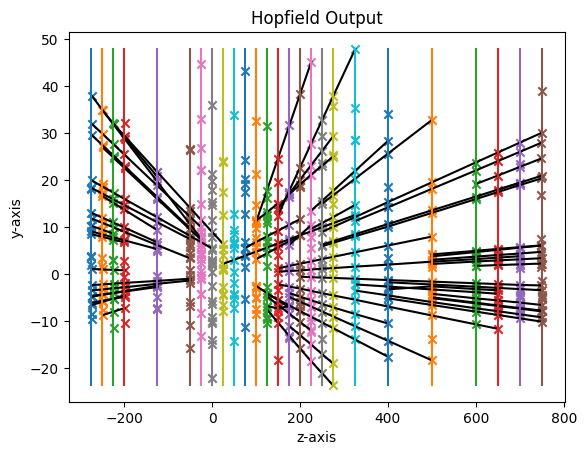

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_340
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_130
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_1
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_373
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_550
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_988
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_452

starting instance 37 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.81 seconds
energy: -454.2850337392593

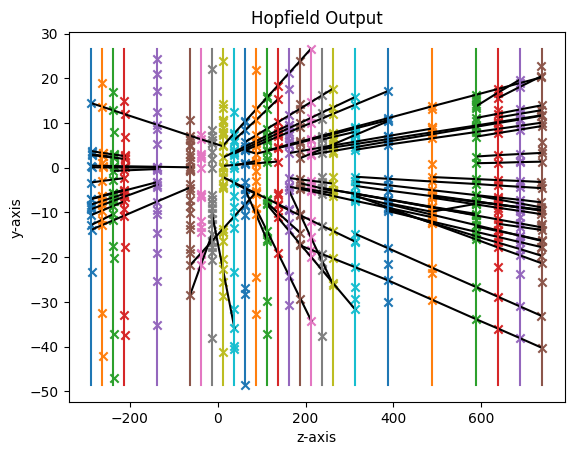

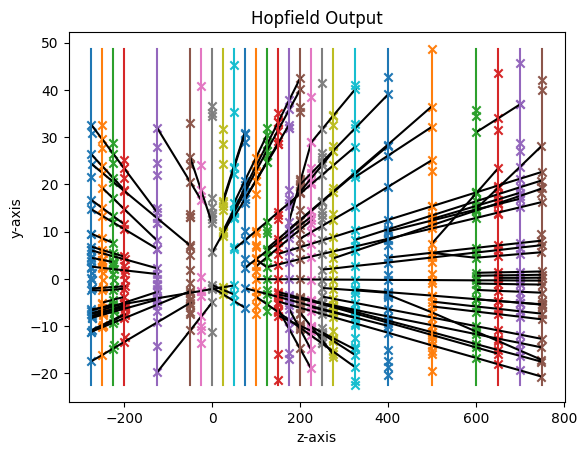

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_285
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_983

starting instance 38 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.18 seconds
energy: -540.6635436986548
energy: -541.3902610202757
energy: -480.08574259602153
energy: -614.2090798217544
energy: -494.45144185719136
energy: -512.3965821037048
energy: -468.6582713000533
energy: -473.88067789020306
energy: -508.24415862694985
energy: -460.08796290698183
[HOPFIELD] converged network by below_mean after 14 mins 14.07 seconds; (energy: -509.41)
energy: -402.2320235902432
energy: -381.53874334544713
energy: -367.5326197723805
energy: -422.70379417490267
energy: -442.6151141127856
energy: -464.8551291619052
energy: -361.306827122005
energy: -423.2630850359858
energy: -428.38683475947533
energy: -343.1782374963811
[HOPFIELD] conve

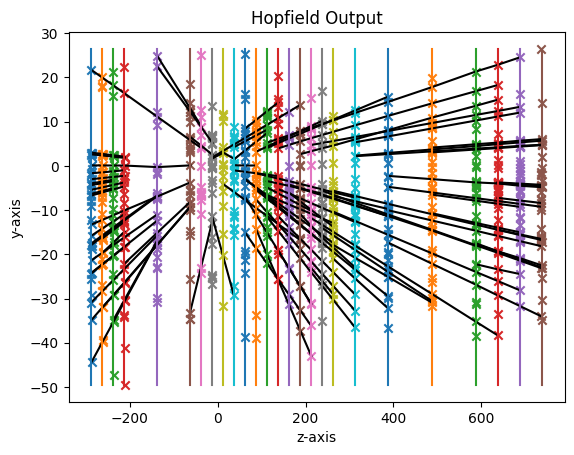

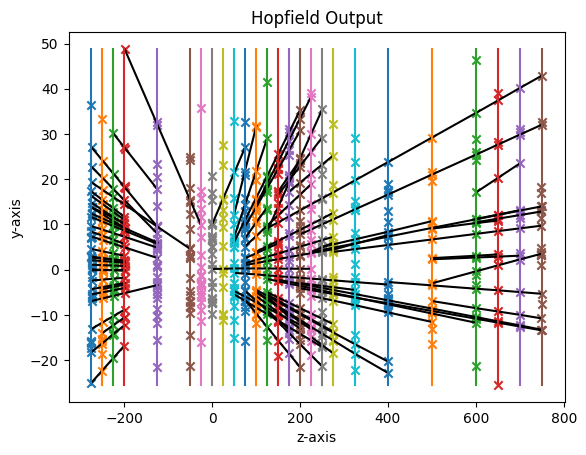

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_682
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_936
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_797
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_44
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_492

starting instance 39 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.19 seconds
energy: -132.58233753506457
energy: -137.80897940857008
energy: -157.07154006337615
energy: -138.1161763107131
energy: -138.84596287001622
energy: -129.69494679426606
energy: -134.89808661283757
energy: -129.69494679426606
energy: -133.6771835452188
energy: -139.76120186251268

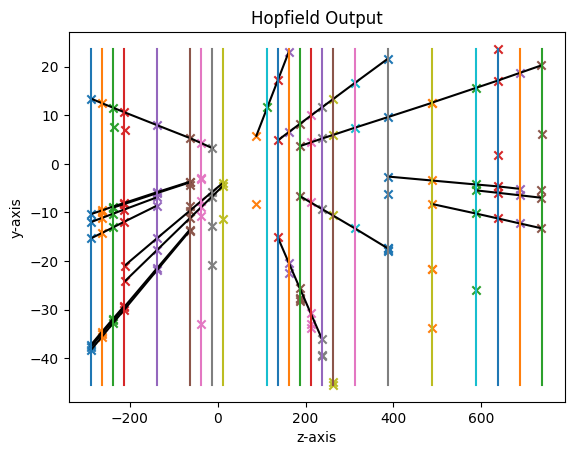

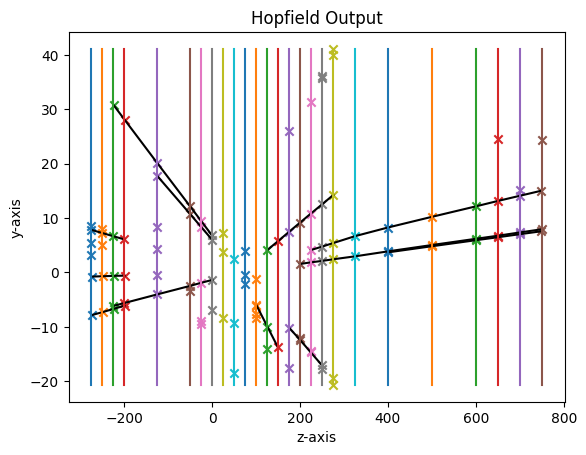

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_302

starting instance 40 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.11 seconds
energy: -237.28122876543256
energy: -237.65557650179625
energy: -230.66878811008553
energy: -245.34006642971377
energy: -231.55823336964752
energy: -251.13250320517275
energy: -238.60138088713637
energy: -239.99984495306654
energy: -241.28599620524562
energy: -233.6835342665352
[HOPFIELD] converged network by below_mean after 0 mins 18.92 seconds; (energy: -238.72)
energy: -348.7769533169324
energy: -310.3179304968677
energy: -313.9518394847368
energy: -315.92126123204406
energy: -310.323504632835
energy: -336.02022199904627
energy: -320.3690172458929
energy: -339.8578151566433
energy: -331.4000308334553
energy: -334.6144228022473
[HOPFIELD] converged network by below_mean after 0 mins 30.20 seconds; (energy: -326.16)
[INFO] tracks extracted in 0 mins 0.06 seconds


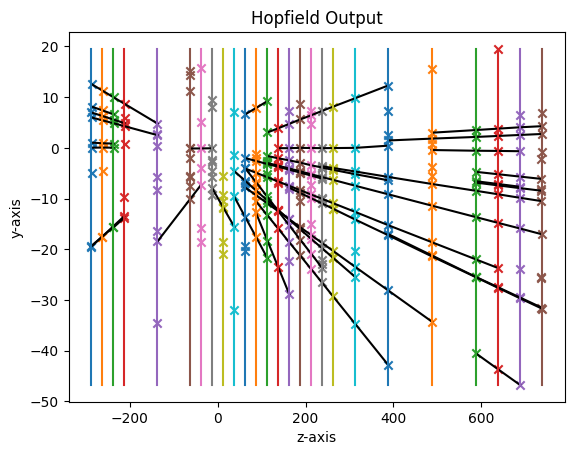

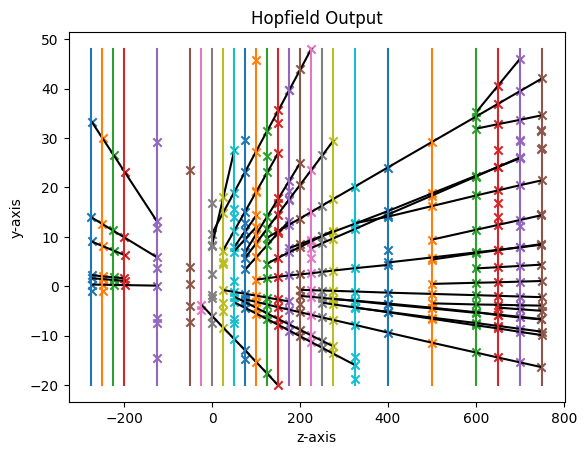

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_792
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_681
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_706

starting instance 41 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.55 seconds
energy: -338.5897176348154
energy: -329.80806959778874
energy: -304.21177702077074
energy: -314.94985300023393
energy: -262.09242617898326
energy: -339.8194984081207
energy: -308.9710365263825
energy: -273.1176449877197
energy: -282.1094020459193
energy: -346.85444616300333
[HOPFIELD] converged network by below_mean after 0 mins 57.48 seconds; (energy: -310.05)
energy: -288.2233099465998
energy: -286.8340196145028
energy: -270.9487939596453
energy: -279.050345353032
energy: -315.6634306184853
energy: -317.79019919989145
en

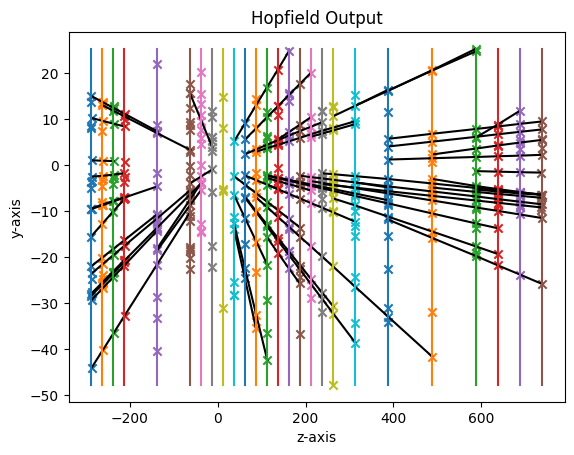

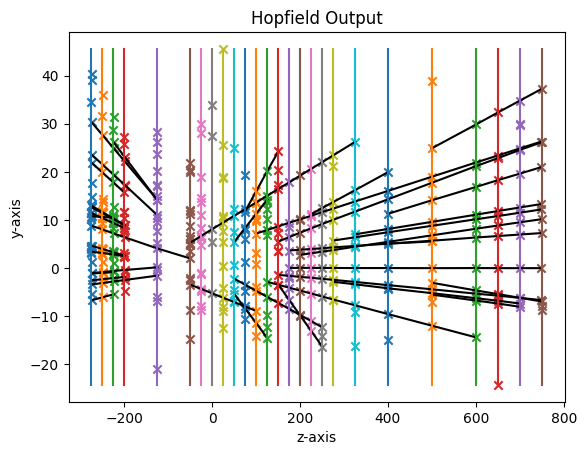

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_237

starting instance 42 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.79 seconds
energy: -328.00197340782023
energy: -344.4423514525202
energy: -374.1122898106618
energy: -364.0323285637343
energy: -324.80049778464075
energy: -280.1747992552183
energy: -319.08575395709676
energy: -297.69574391087275
energy: -287.28880615489305
energy: -349.14682243974767
[HOPFIELD] converged network by below_mean after 2 mins 57.48 seconds; (energy: -326.88)
energy: -332.1882166140344
energy: -333.82666129699214
energy: -321.7413191814123
energy: -354.75673651776435
energy: -357.2425872642336
energy: -359.2887648468485
energy: -343.776891459506
energy: -365.3705354456155
energy: -329.4739771921829
energy: -338.75195645532887
[HOPFIELD] converged network by below_mean after 2 mins 17.55 seconds; (energy: -343.64)
[INFO] tracks extracted in 0 mins 0.11 seconds


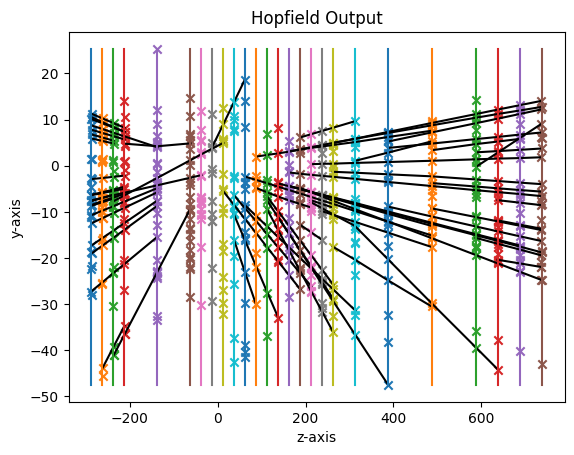

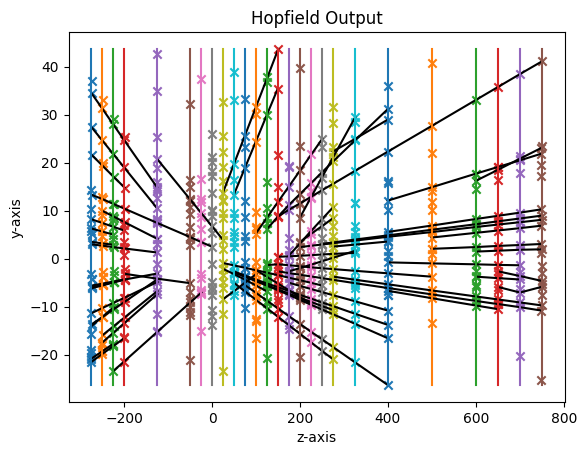

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_787
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_844

starting instance 43 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.22 seconds
energy: -123.48880082604131
energy: -129.33215294343745
energy: -128.812941646991
energy: -129.4632185696707
energy: -129.90475650261212
energy: -127.4970083245168
energy: -131.46839943309678
energy: -123.56407497047701
energy: -127.23539148570654
energy: -128.53048082829037
[HOPFIELD] converged network by below_mean after 0 mins 4.63 seconds; (energy: -127.93)
energy: -193.09316480613376
energy: -196.25481557530205
energy: -212.2588208572985
energy: -209.14418783077238
energy: -205.74386078727127
energy: -214.20004004987166
energy: -198.26741824246395
energy: -191.60844856890034
energy: -207.08731213726273
energy: -200.9449316317336
[HOPFIELD] c

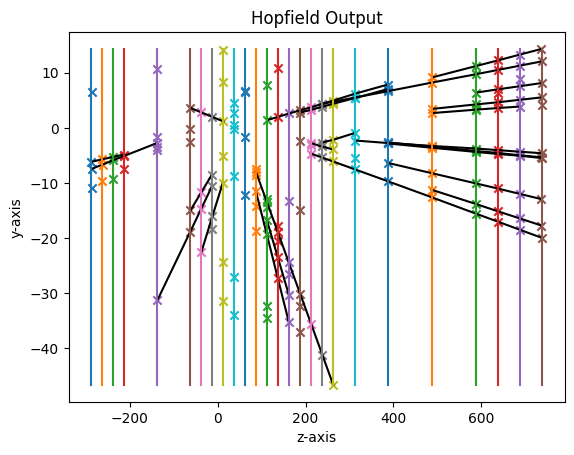

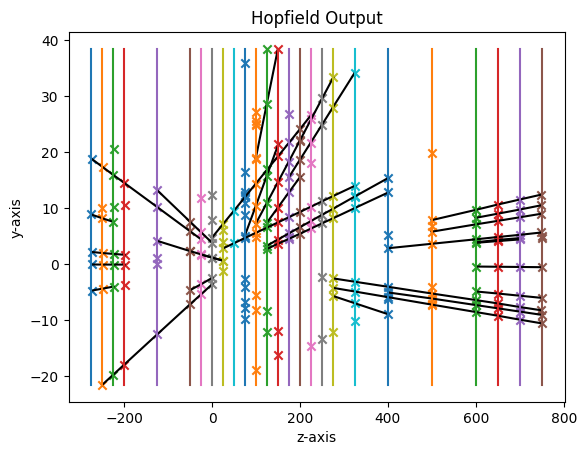

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_887
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_330
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_880

starting instance 44 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.86 seconds
energy: -437.1127841375524
energy: -436.1634451859113
energy: -463.83288644614254
energy: -405.4671253481588
energy: -430.6153923619501
energy: -464.683198616332
energy: -448.2309852275197
energy: -446.86238491296916
energy: -421.85005151240324
energy: -412.99168800538405
[HOPFIELD] converged network by below_mean after 2 mins 30.98 seconds; (energy: -436.78)
energy: -590.7799153923773
energy: -602.8662171160897
energy: -586.2388245420331
energy: -555.7559052227131
energy: -501.3098674156135
energy: -716.4698233741435
ener

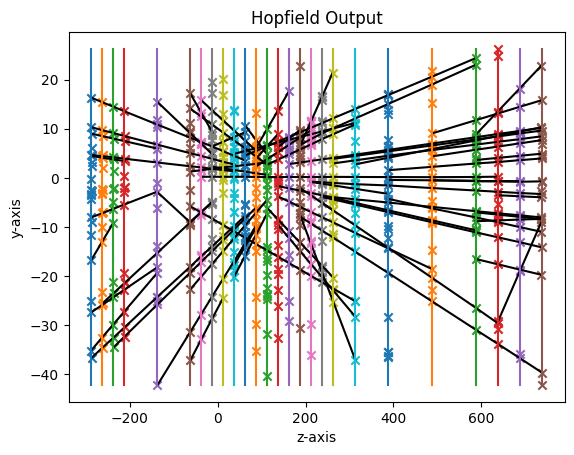

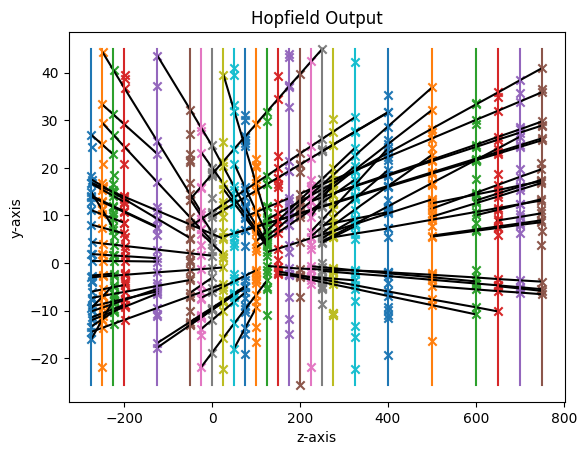

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_831
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_515

starting instance 45 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.86 seconds
energy: -270.67963515293326
energy: -320.94440553397493
energy: -283.48724500507024
energy: -257.4349092411448
energy: -299.4485072578651
energy: -294.0785229826715
energy: -289.65853057843105
energy: -332.58200727346684
energy: -302.1188373524874
energy: -284.09108933127214
[HOPFIELD] converged network by below_mean after 1 mins 2.90 seconds; (energy: -293.45)
energy: -352.4607752346705
energy: -378.09443595198724
energy: -377.2807983512625
energy: -351.20368377320267
energy: -351.03048954114223
energy: -381.47366875638596
energy: -342.1941713333137
energy: -365.8042675754414
energy: -399.3327204087884
energy: -392.6805031016887
[HOPFIELD] conve

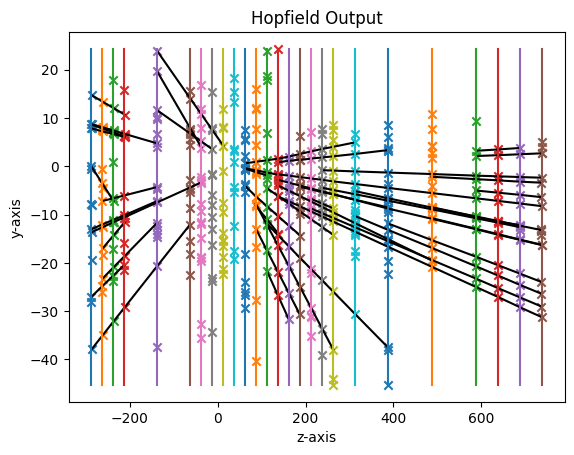

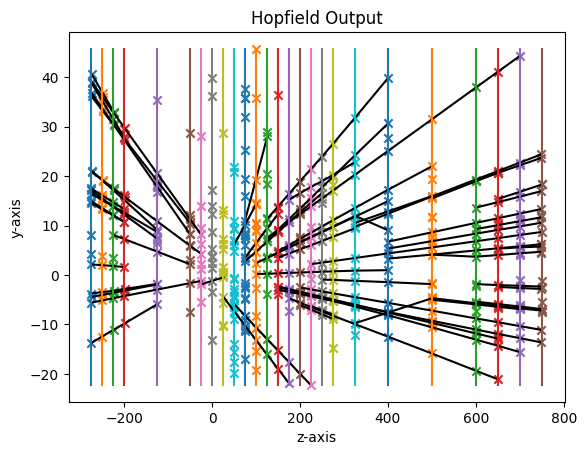

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_684

starting instance 46 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.55 seconds
energy: -348.73633612026265
energy: -360.732802074385
energy: -332.4032661649273
energy: -382.9902461808408
energy: -367.73845014460113
energy: -348.9122465409889
energy: -332.2359391463726
energy: -374.8395414081248
energy: -347.9875442911678
energy: -335.5605367262664
[HOPFIELD] converged network by below_mean after 1 mins 48.18 seconds; (energy: -353.21)
energy: -309.44706836443834
energy: -281.6378089910872
energy: -273.1775124746967
energy: -270.7666670846644
energy: -282.8113093395668
energy: -281.9469141557798
energy: -300.62369841198824
energy: -319.78948976944974
energy: -326.79897193222587
energy: -283.26381552637855
[HOPFIELD] converged network by below_mean after 0 mins 43.28 seconds; (energy: -293.03)
[INFO] tracks extracted in 0 mins 0.10 seconds


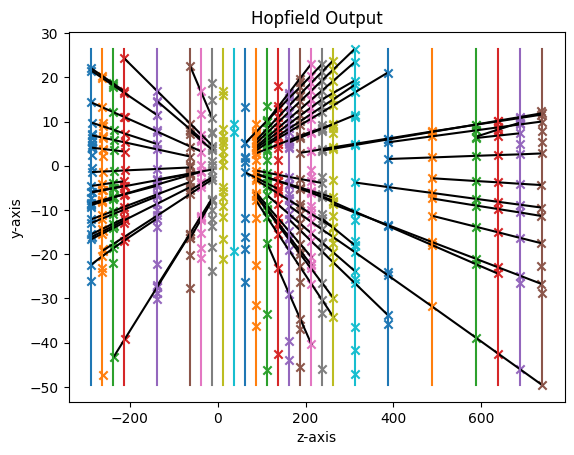

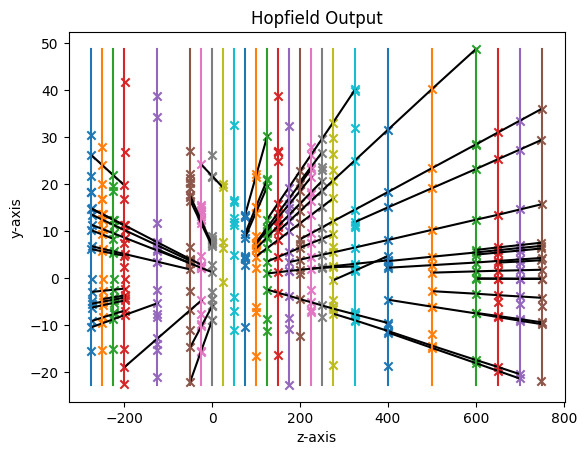

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_354

starting instance 47 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.81 seconds
energy: -279.5957237442415
energy: -264.40816237934695
energy: -316.22611606708574
energy: -267.3775426409839
energy: -299.1771287604942
energy: -303.48336876380415
energy: -321.30166291587096
energy: -296.8671682506236
energy: -277.49344539007075
energy: -257.9931672784816
[HOPFIELD] converged network by below_mean after 1 mins 3.60 seconds; (energy: -288.39)
energy: -264.80677683470884
energy: -292.5553979336391
energy: -250.16911790344312
energy: -264.7044873942084
energy: -265.03123536838564
energy: -224.65879929237818
energy: -292.63665423635734
energy: -296.21132812751245
energy: -279.6744379024518
energy: -305.9940219745722
[HOPFIELD] converged network by below_mean after 1 mins 21.15 seconds; (energy: -273.64)
[INFO] tracks extracted in 0 mins 0.07 seconds


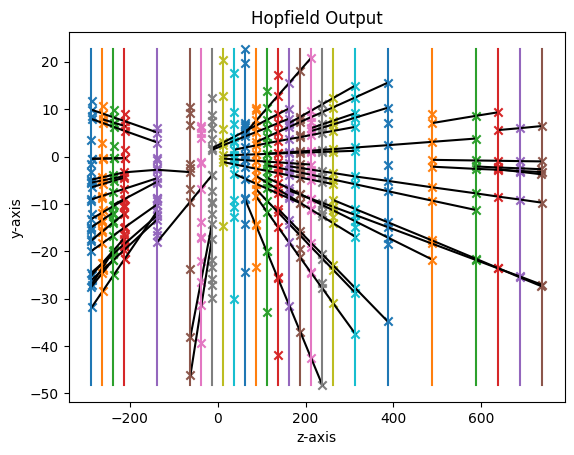

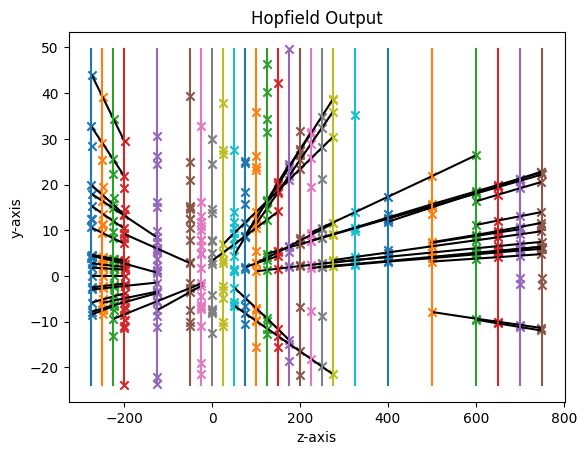

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_485

starting instance 48 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.91 seconds
energy: -134.98948348577437
energy: -152.57621761590315
energy: -143.4450203033402
energy: -132.07582777338462
energy: -146.11637691520423
energy: -154.035678334225
energy: -153.4269882007747
energy: -124.49999926976459
energy: -143.28355319773465
energy: -137.2506973909924
[HOPFIELD] converged network by below_mean after 0 mins 5.02 seconds; (energy: -142.17)
energy: -194.99590676156902
energy: -180.23932404737045
energy: -188.91519184576356
energy: -195.50998713646334
energy: -201.6935843166963
energy: -199.4507319567587
energy: -195.5287644921174
energy: -193.74332967748038
energy: -188.91473447460393
energy: -182.55032007464
[HOPFIELD] converged network by below_mean after 0 mins 22.65 seconds; (energy: -192.15)
[INFO] tracks extracted in 0 mins 0.05 seconds


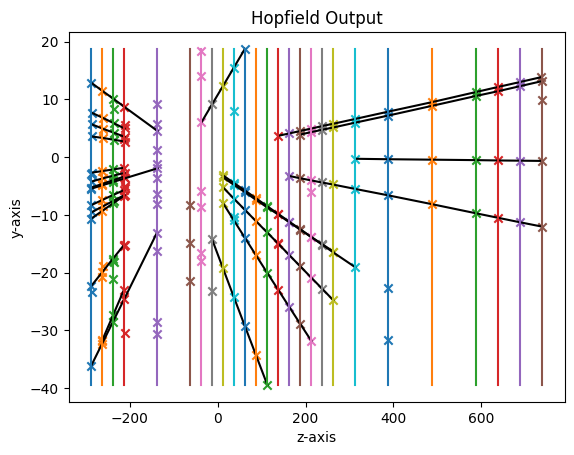

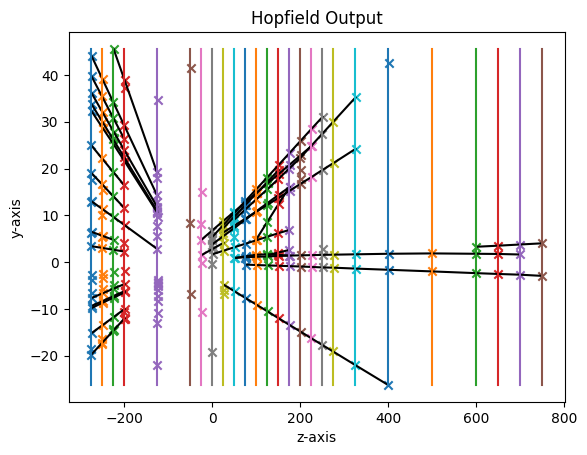

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_85
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_331
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_368
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_592

starting instance 49 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.55 seconds
energy: -379.35899348440853
energy: -423.6322072891466
energy: -430.7406269835573
energy: -409.55768127614493
energy: -408.7421185524999
energy: -410.2368731847005
energy: -421.3557444850247
energy: -393.37050486040863
energy: -404.9306890626757
energy: -411.8826438468639
[HOPFIELD] converged network by below_mean after 5 mins 41.69 seconds; (energy: -409.38)
energy: -428.0967405466331
energy: -516.4

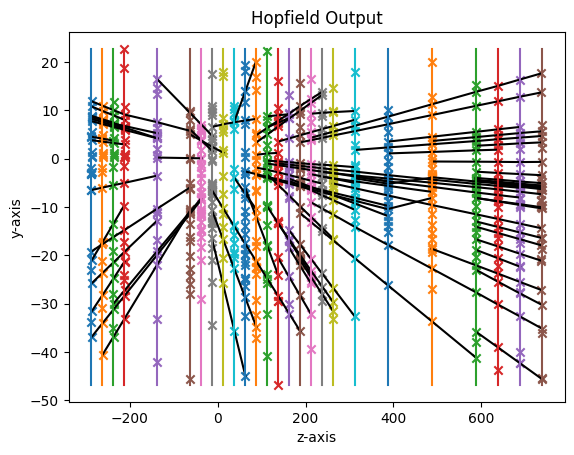

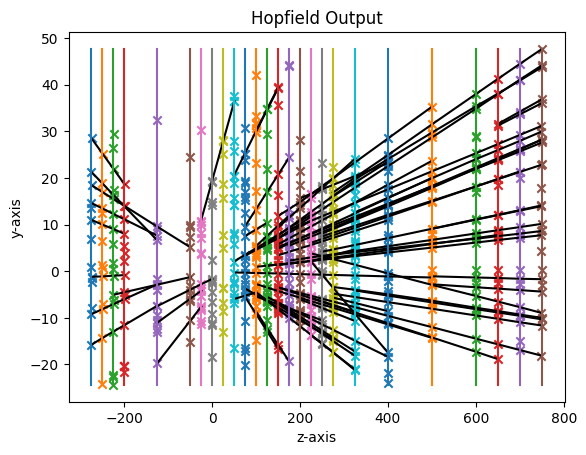

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_981
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_177

starting instance 50 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.01 seconds
energy: -278.4900320822775
energy: -309.98257210403824
energy: -311.6860378842684
energy: -296.82144873967945
energy: -314.589702674342
energy: -331.794013286066
energy: -325.8796542225898
energy: -321.1751918836288
energy: -347.7357432392876
energy: -309.5644955690739
[HOPFIELD] converged network by below_mean after 0 mins 48.28 seconds; (energy: -314.77)
energy: -305.42065003149764
energy: -311.7860072462578
energy: -290.91498383280765
energy: -301.22582892045307
energy: -289.4638743032133
energy: -266.7069417865991
energy: -307.7145002360286
energy: -297.8310654249036
energy: -302.3007808877899
energy: -283.1041308933642
[HOPFIELD] converged n

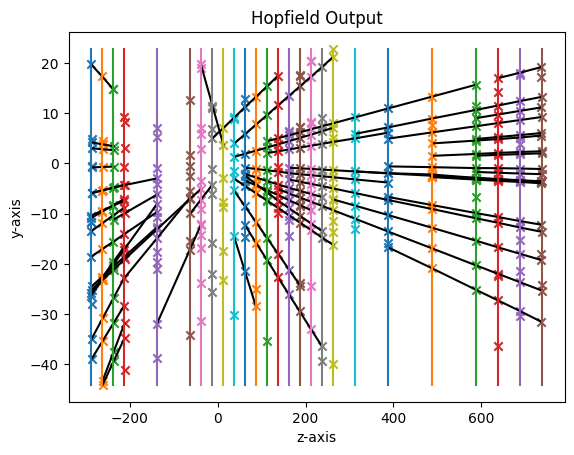

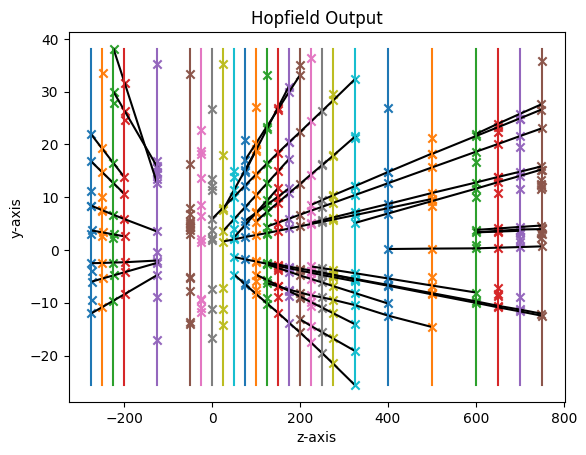

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_853

starting instance 51 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.82 seconds
energy: -234.19533711761812
energy: -241.6011540197444
energy: -232.1108770455044
energy: -218.00050507972952
energy: -239.63843288816085
energy: -241.3041591779806
energy: -252.7067553843289
energy: -237.83833626857654
energy: -245.30929808633704
energy: -245.5035439278812
[HOPFIELD] converged network by below_mean after 0 mins 21.40 seconds; (energy: -238.82)
energy: -400.4478058153856
energy: -369.46575910041463
energy: -389.51505465849635
energy: -297.54053775342226
energy: -296.6012362946997
energy: -270.44754828767236
energy: -330.2336537118334
energy: -306.238774619677
energy: -293.34031136628005
energy: -306.01045685001566
[HOPFIELD] converged network by below_mean after 1 mins 16.97 seconds; (energy: -325.98)
[INFO] tracks extracted in 0 mins 0.05 seconds


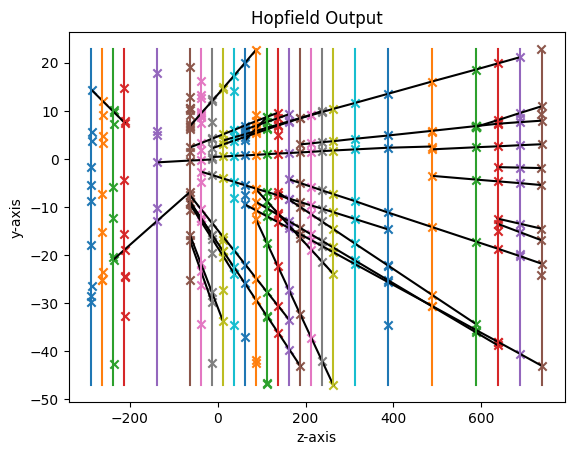

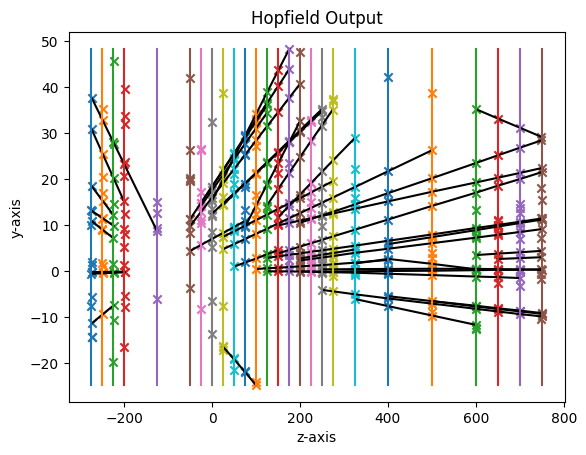

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_391

starting instance 52 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.22 seconds
energy: -123.92792393403691
energy: -121.87598460593951
energy: -121.86815999084477
energy: -122.27787521211415
energy: -121.92061083980478
energy: -123.72936734549556
energy: -124.15247873058969
energy: -120.81339242371708
energy: -113.73820901419103
energy: -122.33523893042205
[HOPFIELD] converged network by below_mean after 0 mins 1.87 seconds; (energy: -121.66)
energy: -108.10357526304378
energy: -110.09240381586847
energy: -113.70540379619601
energy: -106.41722925406339
energy: -110.89683181721608
energy: -113.49215846612987
energy: -109.4812402473662
energy: -105.49592765174597
energy: -115.14743082612631
energy: -110.9016351417043
[HOPFIELD] converged network by below_mean after 0 mins 3.03 seconds; (energy: -110.37)
[INFO] tracks extracted in 0 mins 0.01 seconds

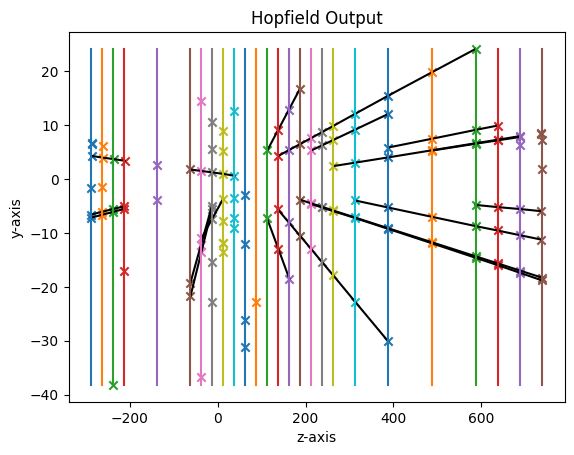

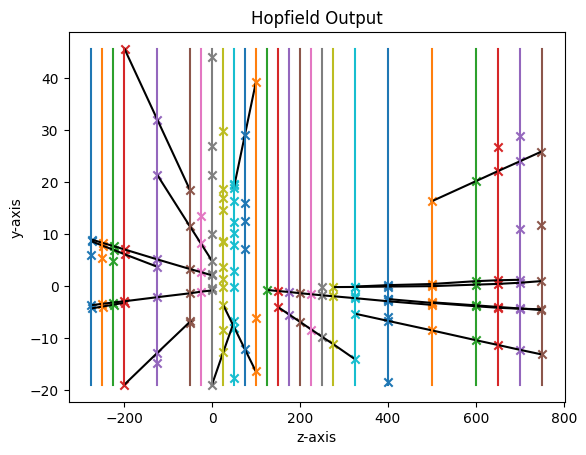

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_666

starting instance 53 out of 100

[INFO] Hopfield Networks initialized in 0 mins 6.60 seconds
energy: -318.9519958241775
energy: -301.34963146529003
energy: -284.66181587417054
energy: -253.5839776615468
energy: -358.8027145561645
energy: -273.8154178566436
energy: -315.2221290081328
energy: -346.40080044108686
energy: -303.2498272582183
energy: -346.6116775378291
[HOPFIELD] converged network by below_mean after 4 mins 7.82 seconds; (energy: -310.26)
energy: -492.25112817325055
energy: -485.3541583513383
energy: -471.26875825459206
energy: -459.5913468052839
energy: -476.45190939445433
energy: -548.5330659244213
energy: -476.28401361134945
energy: -440.05219104089645
energy: -436.745512182693
energy: -492.47170208320944
[HOPFIELD] converged network by below_mean after 6 mins 5.16 seconds; (energy: -477.90)
[INFO] tracks extracted in 0 mins 0.15 seconds


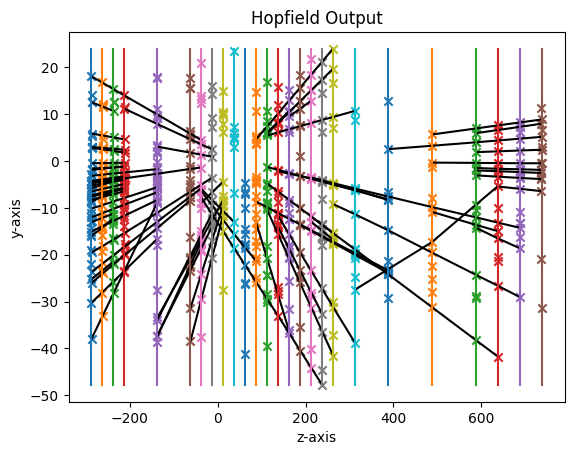

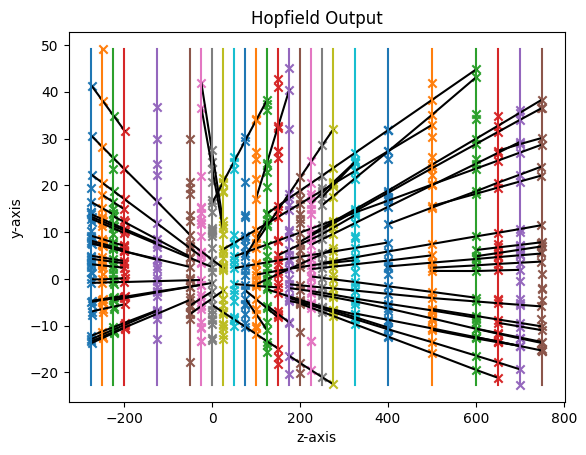

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_548

starting instance 54 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.06 seconds
energy: -314.1737088271166
energy: -315.5704870292311
energy: -306.21381884015227
energy: -307.5994919251656
energy: -308.7474269045265
energy: -309.02503607986165
energy: -308.20019597909646
energy: -303.71389352778533
energy: -318.18224952937345
energy: -291.0322914141373
[HOPFIELD] converged network by below_mean after 0 mins 58.62 seconds; (energy: -308.25)
energy: -284.45525976622054
energy: -303.37697055127444
energy: -279.75384465659806
energy: -302.2443044942878
energy: -266.4558991663428
energy: -311.7440806276719
energy: -305.3813768410844
energy: -278.0747900030873
energy: -326.75437652094763
energy: -305.9104528881764
[HOPFIELD] converged network by below_mean after 0 mins 56.15 seconds; (energy: -296.42)
[INFO] tracks extracted in 0 mins 0.08 seconds


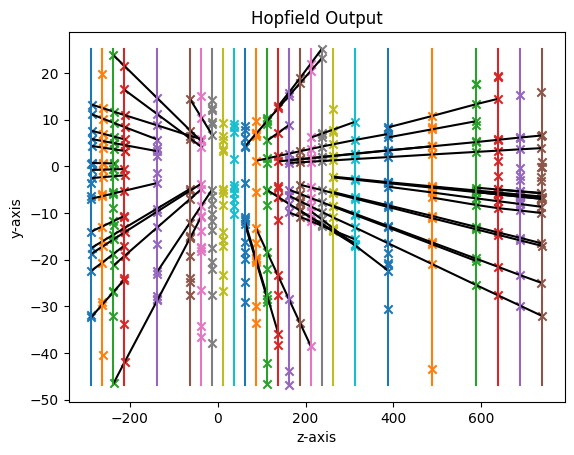

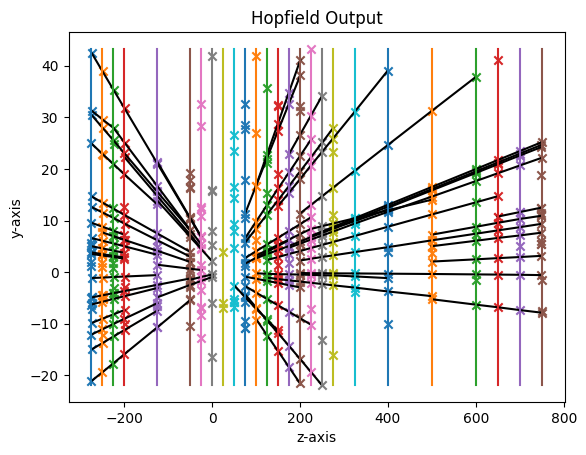

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_242
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_952
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_703
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_413
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_585

starting instance 55 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.11 seconds
energy: -104.00121122555635
energy: -125.43913506760921
energy: -116.15071539903667
energy: -121.51663657026074
energy: -118.10647844580103
energy: -120.97649004181426
energy: -110.33493271391455
energy: -120.74043389519596
energy: -119.22990348900655
energy: -114.41912778855

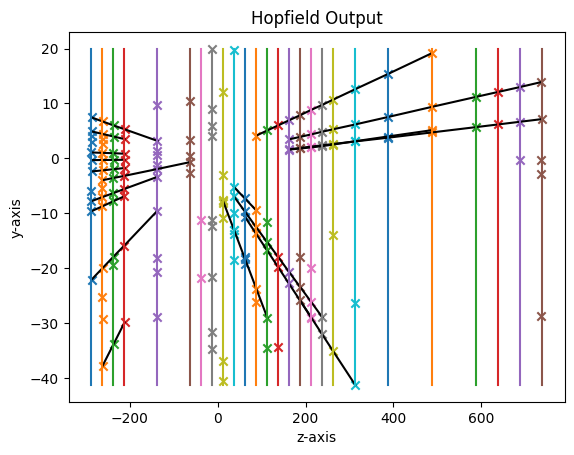

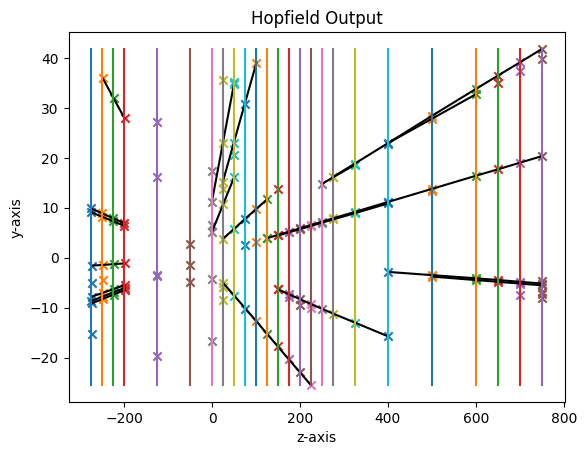

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_493
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_108
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_387
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_381
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_125

starting instance 56 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.23 seconds
energy: -144.0084949011509
energy: -149.25684488137296
energy: -140.82867212268607
energy: -148.27325716014164
energy: -142.68724320254273
energy: -142.13822281050204
energy: -149.86734193891033
energy: -132.5899869812525
energy: -140.4910137603473
energy: -142.48968412950208

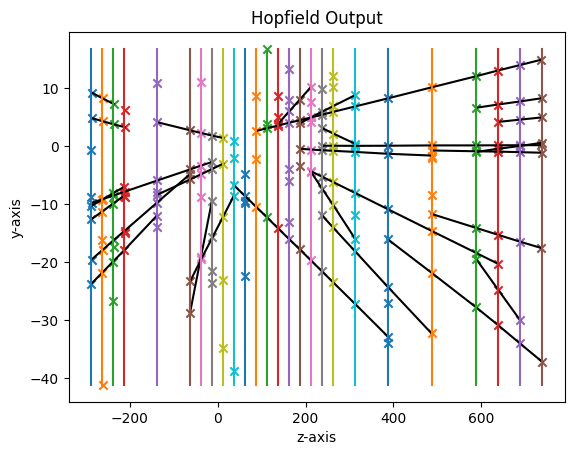

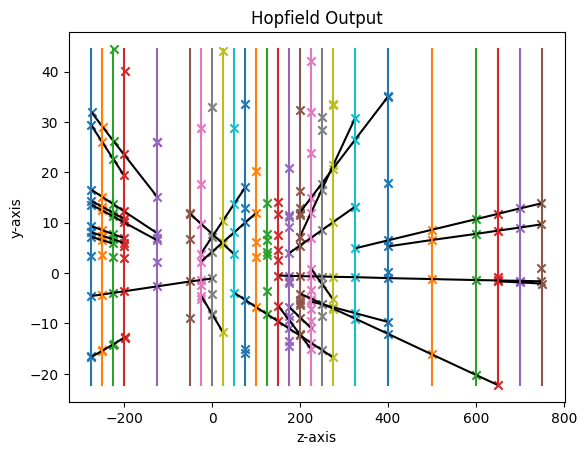

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_834
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_891

starting instance 57 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.51 seconds
energy: -239.7678394052106
energy: -234.42075345670162
energy: -225.8338830476495
energy: -227.03653378761004
energy: -232.72756042111368
energy: -220.8413661030529
energy: -200.12860924745104
energy: -228.1934926790176
energy: -241.53831509578583
energy: -233.97737649417303
[HOPFIELD] converged network by below_mean after 0 mins 26.44 seconds; (energy: -228.45)
energy: -131.93911073286085
energy: -137.90514488631487
energy: -130.4170674642363
energy: -134.6930896493531
energy: -131.64334742800386
energy: -133.60131431639127
energy: -126.0676760838036
energy: -133.205536552196
energy: -136.93353281167776
energy: -132.93145221910697
[HOPFIELD] con

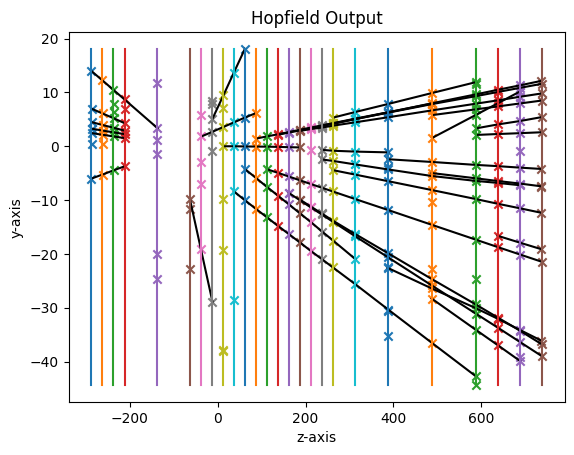

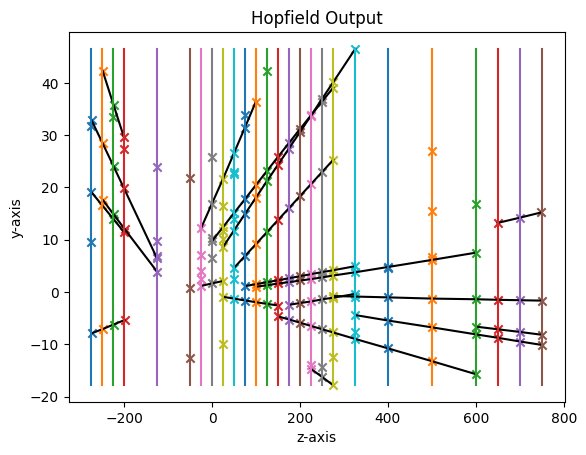

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_849
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_704
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_103
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_632
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_271
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_563

starting instance 58 out of 100

[INFO] Hopfield Networks initialized in 0 mins 13.58 seconds
energy: -503.13767790494774
energy: -452.5692577874852
energy: -507.90908411781487
energy: -492.28300199853817
energy: -488.590974498146
energy: -542

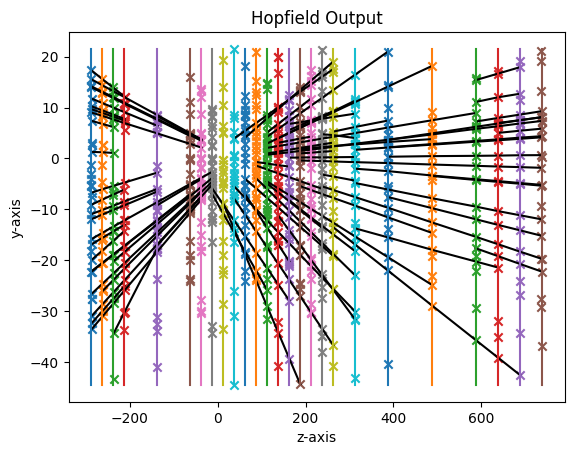

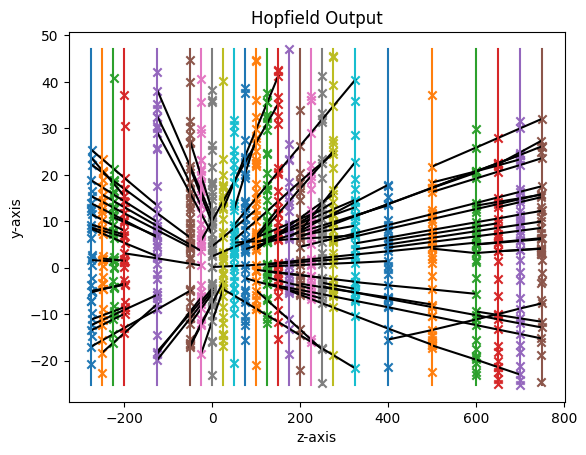

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_362

starting instance 59 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.43 seconds
energy: -415.5719841010519
energy: -443.75678720514986
energy: -421.0681536901297
energy: -477.83908188050987
energy: -510.12843778015883
energy: -429.1486029699791
energy: -439.7227282305748
energy: -453.5681118268112
energy: -444.6186685836421
energy: -415.33260863090084
[HOPFIELD] converged network by below_mean after 3 mins 22.57 seconds; (energy: -445.08)
energy: -490.81993990231774
energy: -387.1457345259505
energy: -360.20381902296975
energy: -368.09682961168556
energy: -367.76373754630043
energy: -358.00473974724866
energy: -395.6843795693446
energy: -463.4558403658145
energy: -400.2602333819279
energy: -395.2785808551067
[HOPFIELD] converged network by below_mean after 2 mins 18.56 seconds; (energy: -398.67)
[INFO] tracks extracted in 0 mins 0.12 seconds


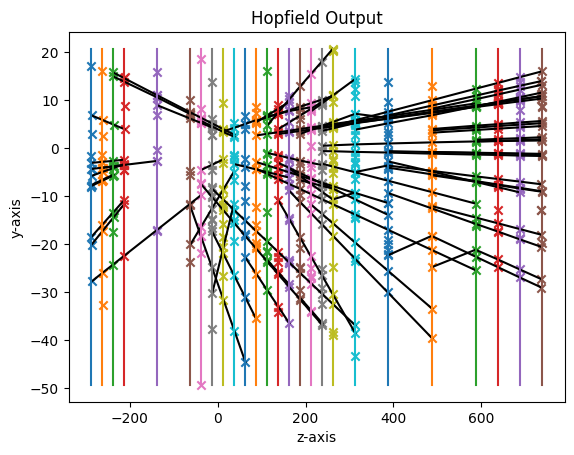

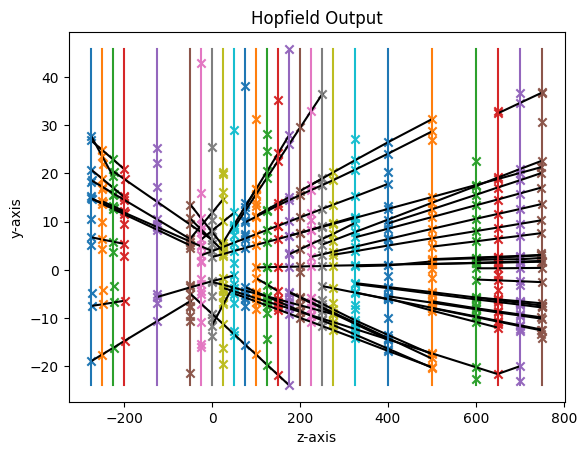

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_603
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_400
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_355

starting instance 60 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.67 seconds
energy: -235.43891864131646
energy: -248.29063899781568
energy: -238.8848686233024
energy: -250.4113476405412
energy: -244.6593141395142
energy: -244.77353965742424
energy: -244.0615622515359
energy: -237.72033938621567
energy: -236.0083181505506
energy: -244.86507479754192
[HOPFIELD] converged network by below_mean after 0 mins 25.16 seconds; (energy: -242.51)
energy: -252.47336287045403
energy: -262.1098333949455
energy: -233.0831664244596
energy: -252.18008740245034
energy: -236.98756144224092
energy: -239.3986962950217

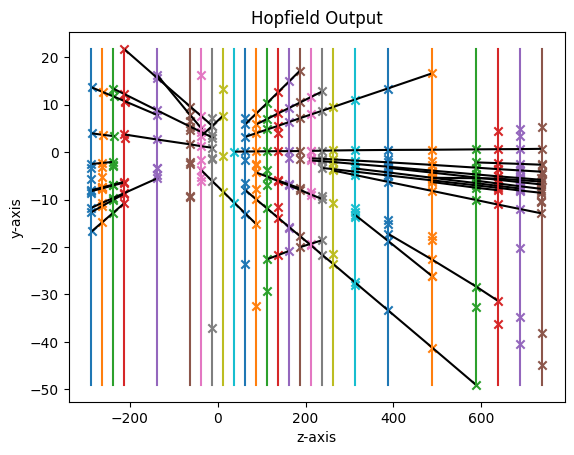

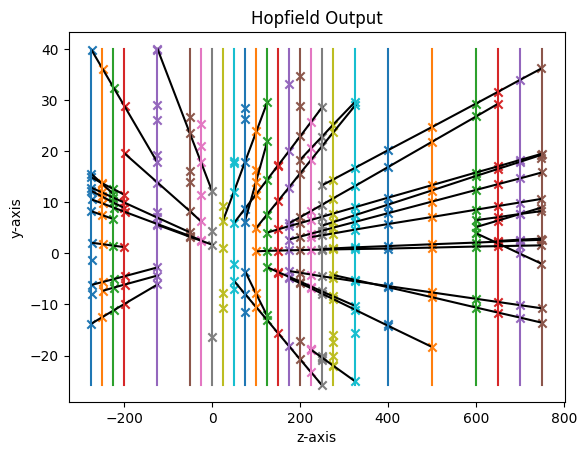

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_504
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_461

starting instance 61 out of 100

[INFO] Hopfield Networks initialized in 0 mins 9.49 seconds
energy: -556.9863585455477
energy: -408.143089909581
energy: -468.76667826609486
energy: -451.79344365419655
energy: -470.86824949028477
energy: -466.60958023107963
energy: -468.96392519024323
energy: -467.39246568177697
energy: -484.75824461093436
energy: -550.279610870301
[HOPFIELD] converged network by below_mean after 6 mins 27.75 seconds; (energy: -479.46)
energy: -462.2937767222758
energy: -402.11287439588216
energy: -441.19730490555924
energy: -502.3217542388238
energy: -390.7025381108776
energy: -440.6729450325154
energy: -454.1769619370866
energy: -369.3904410461171
energy: -445.17246032626133
energy: -465.57482115936733
[HOPFIELD] conve

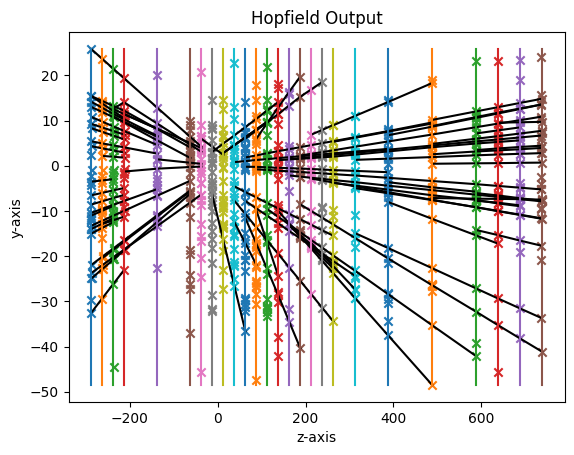

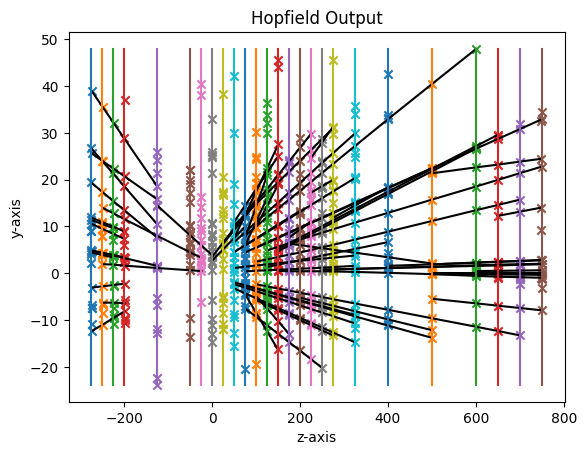

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_395
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_496
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_144

starting instance 62 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.41 seconds
energy: -511.6626141708659
energy: -567.0484461183102
energy: -488.75559416646985
energy: -577.046995419187
energy: -557.7186727215428
energy: -555.1162080317251
energy: -565.0713228185232
energy: -518.3601439080662
energy: -580.6259222864434
energy: -571.9801248621322
[HOPFIELD] converged network by below_mean after 14 mins 21.41 seconds; (energy: -549.34)
energy: -460.5172732793238
energy: -393.0619536619028
energy: -421.6135686880253
energy: -438.8984050333366
energy: -404.54132269961974
energy: -411.487426556591
energ

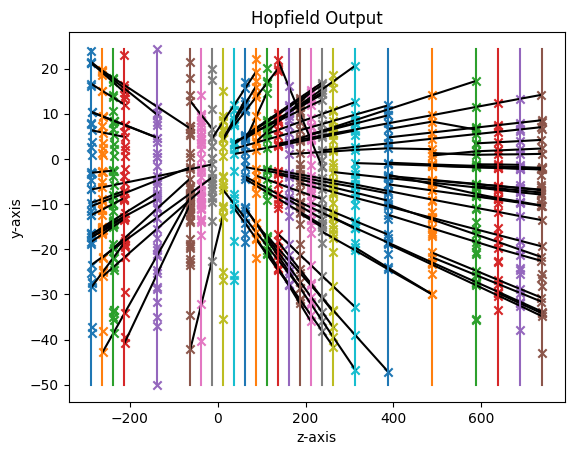

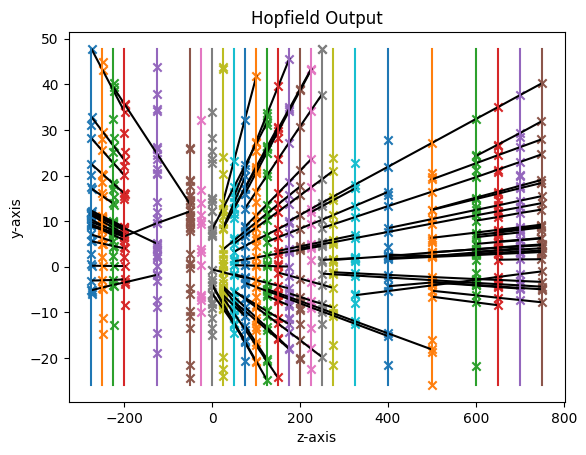

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_699

starting instance 63 out of 100

[INFO] Hopfield Networks initialized in 0 mins 9.60 seconds
energy: -462.15679767001524
energy: -473.89134778005405
energy: -446.526871538896
energy: -427.04241455344413
energy: -509.56780179391853
energy: -494.35101624115975
energy: -494.26135301568775
energy: -497.3112839266758
energy: -464.19870209603465
energy: -483.534508614104
[HOPFIELD] converged network by below_mean after 3 mins 54.95 seconds; (energy: -475.28)
energy: -583.4788971821549
energy: -523.4148046986161
energy: -583.7772560872444
energy: -504.14025933708695
energy: -608.3186329323034
energy: -550.4055722863485
energy: -540.9850540768725
energy: -533.5922262916948
energy: -539.4209067260555
energy: -607.1541633846302
[HOPFIELD] converged network by below_mean after 8 mins 21.23 seconds; (energy: -557.47)
[INFO] tracks extracted in 0 mins 0.19 seconds


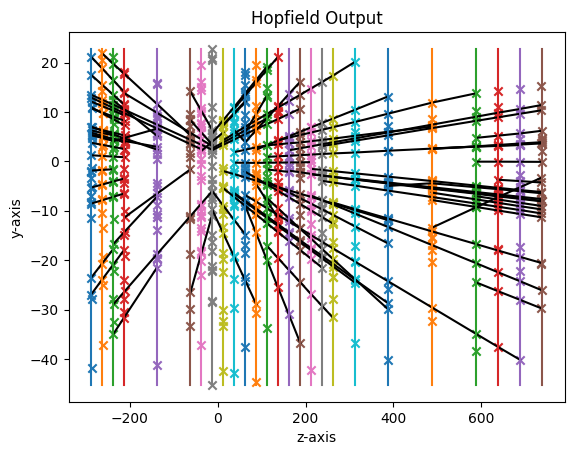

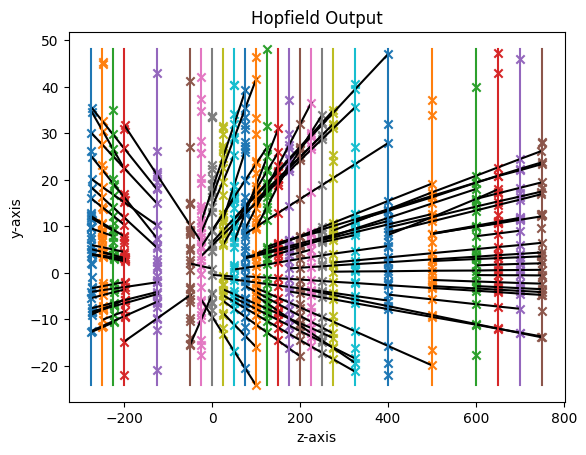

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_455
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_954

starting instance 64 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.32 seconds
energy: -292.317259403556
energy: -323.57250906933245
energy: -291.3009049436075
energy: -294.47521654547717
energy: -329.9655268951676
energy: -267.44835053914767
energy: -283.78835764654974
energy: -286.85627206815974
energy: -286.29580398397485
energy: -274.53985055356463
[HOPFIELD] converged network by below_mean after 1 mins 17.78 seconds; (energy: -293.06)
energy: -258.5341753529739
energy: -283.29885144491016
energy: -259.9326454676297
energy: -257.955480330138
energy: -260.58958450542264
energy: -266.10846119927606
energy: -250.04139583896563
energy: -258.99439400608526
energy: -252.69224242456144
energy: -244.07153994337264
[HOPFIELD] co

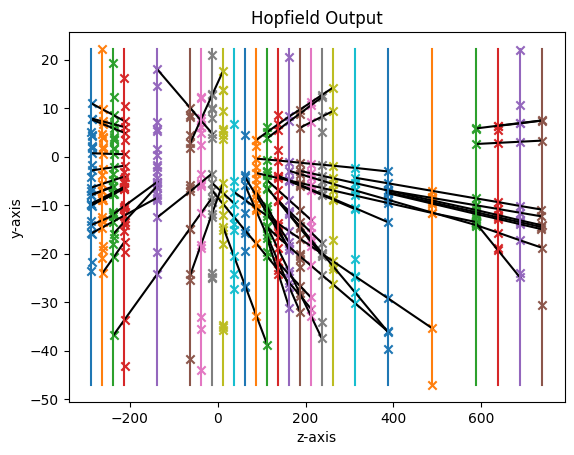

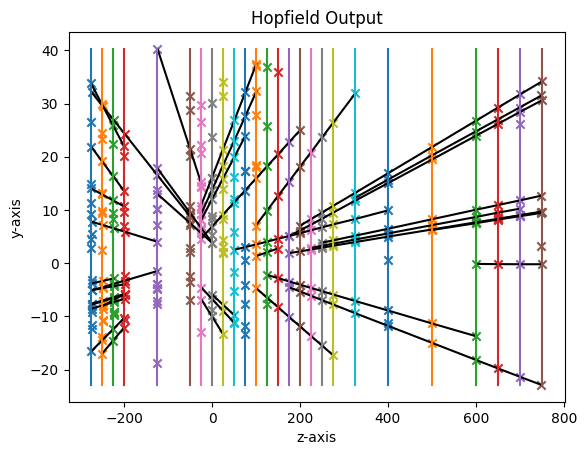

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_143

starting instance 65 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.01 seconds
energy: -302.0370954714662
energy: -268.0511746019572
energy: -283.3640005109443
energy: -303.1510179720625
energy: -302.53773518862454
energy: -293.5828399266027
energy: -310.9608349062763
energy: -311.250834802949
energy: -311.16828284541026
energy: -304.1505739235351
[HOPFIELD] converged network by below_mean after 1 mins 3.31 seconds; (energy: -299.03)
energy: -308.32414064786025
energy: -316.53435478823843
energy: -261.09459932326024
energy: -289.3115264565951
energy: -371.13817601286894
energy: -309.0182778638489
energy: -321.8941957369781
energy: -346.2365796565133
energy: -322.9162577231935
energy: -322.5962016901494
[HOPFIELD] converged network by below_mean after 1 mins 34.71 seconds; (energy: -316.91)
[INFO] tracks extracted in 0 mins 0.09 seconds


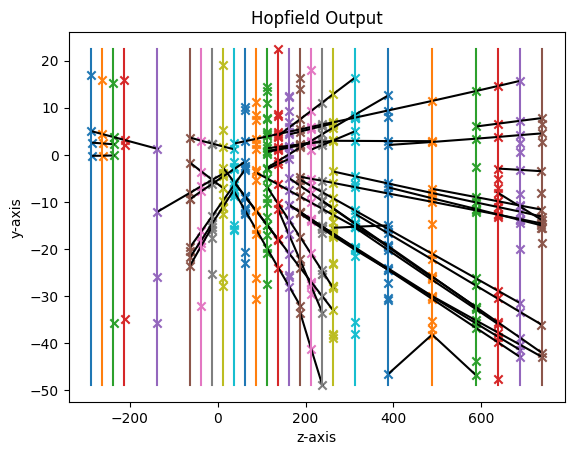

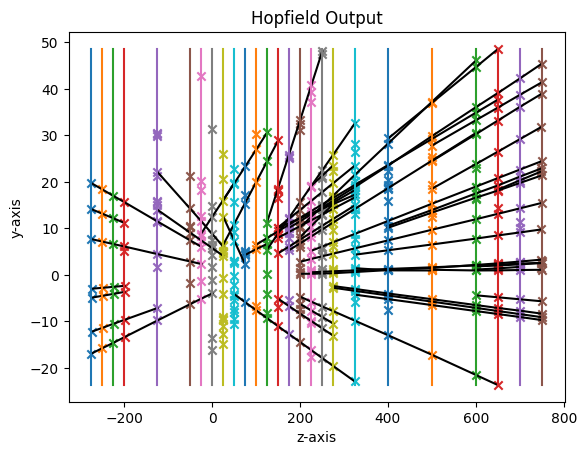

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_614
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_189
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_547
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_716
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_506
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_649

starting instance 66 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.97 seconds
energy: -417.8503545354339
energy: -449.301786775683
energy: -502.28677342101713
energy: -495.95113068495107
energy: -525.8730517896602
energy: -430.7

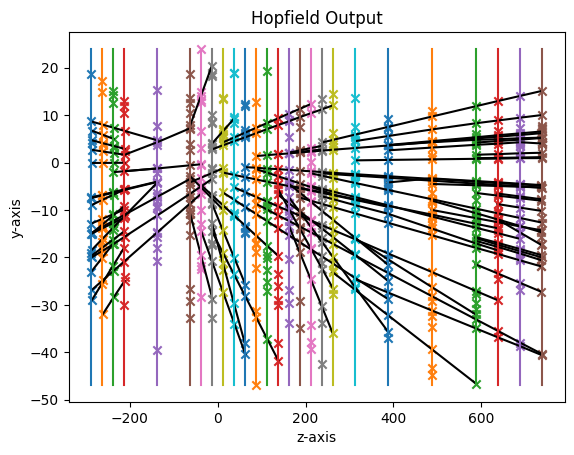

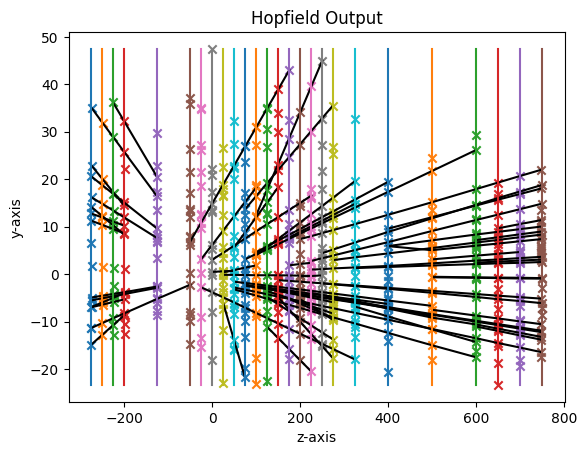

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_886
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_804

starting instance 67 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.25 seconds
energy: -371.26749150165307
energy: -376.2941027293981
energy: -482.60506602575106
energy: -427.8309815268305
energy: -444.87475615358795
energy: -468.8865207312291
energy: -324.55143857012
energy: -359.70364476467705
energy: -396.64664959417115
energy: -468.25350682478586
[HOPFIELD] converged network by below_mean after 6 mins 39.87 seconds; (energy: -412.09)
energy: -439.5209823624836
energy: -454.73200511948886
energy: -393.1965692305457
energy: -524.4897866105209
energy: -420.4017135005685
energy: -349.75218012250446
energy: -433.94057382480764
energy: -408.9354862315012
energy: -427.2381979173929
energy: -427.1847291133976
[HOPFIELD] converg

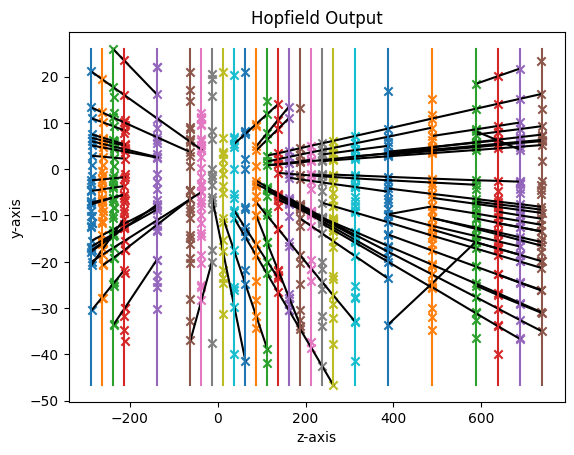

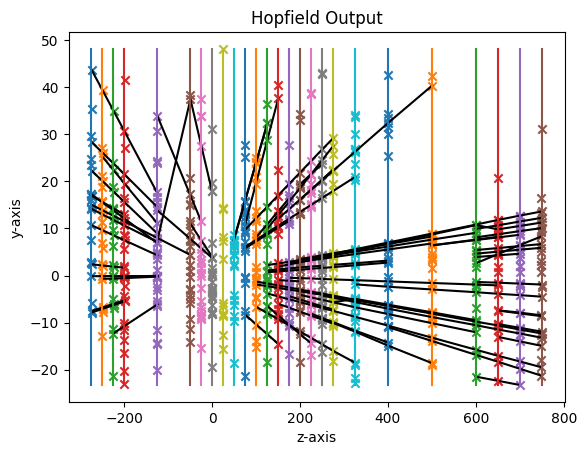

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_554

starting instance 68 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.01 seconds
energy: -273.1484492987969
energy: -304.1521183377787
energy: -351.1644194030338
energy: -301.87385584851233
energy: -279.13641215285304
energy: -301.8578135703704
energy: -361.4209655088226
energy: -313.7230297971449
energy: -308.1774665903141
energy: -329.05432062454054
[HOPFIELD] converged network by below_mean after 0 mins 41.99 seconds; (energy: -312.37)
energy: -162.24398419778467
energy: -176.68478151046548
energy: -165.3913093484472
energy: -174.0475523828343
energy: -174.18797401230566
energy: -173.58227199872834
energy: -164.6008648008016
energy: -159.82349605169753
energy: -159.395155403686
energy: -160.05109643103884
[HOPFIELD] converged network by below_mean after 0 mins 5.40 seconds; (energy: -167.00)
[INFO] tracks extracted in 0 mins 0.04 seconds


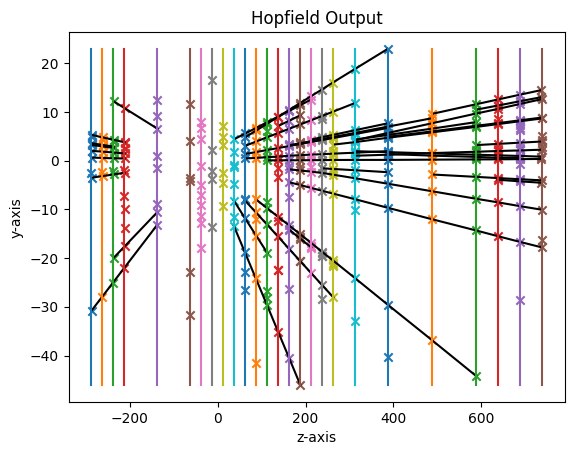

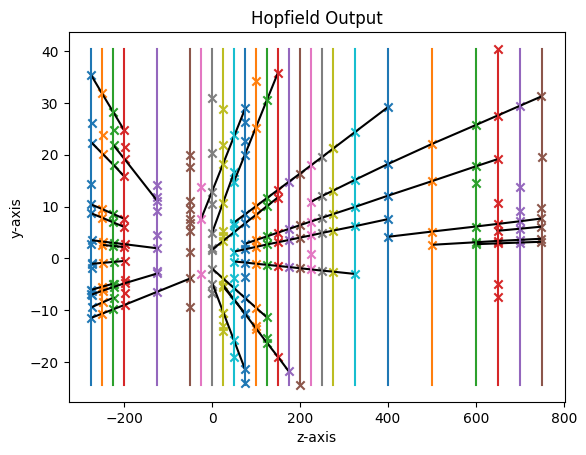

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_771
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_438
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_941

starting instance 69 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.66 seconds
energy: -350.9862412790686
energy: -370.95525962829487
energy: -379.51517337492527
energy: -363.28829835851786
energy: -310.9731727462141
energy: -368.0142631968311
energy: -357.43847887854093
energy: -384.99412774473404
energy: -381.19847433505885
energy: -387.6897052076068
[HOPFIELD] converged network by below_mean after 1 mins 38.04 seconds; (energy: -365.51)
energy: -289.7214495898612
energy: -301.7019843840805
energy: -288.98425751141633
energy: -259.7585620087515
energy: -268.4651055000639
energy: -268.0724773599074


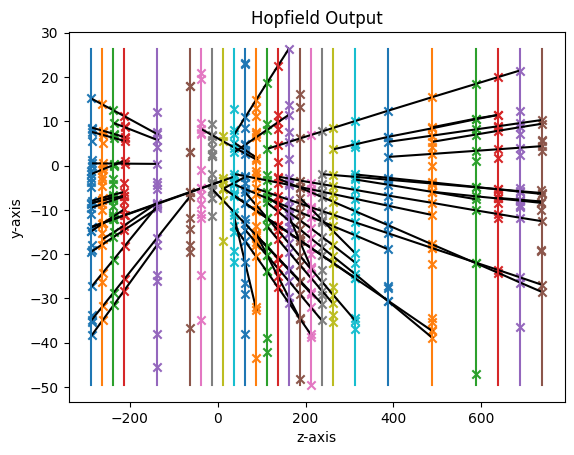

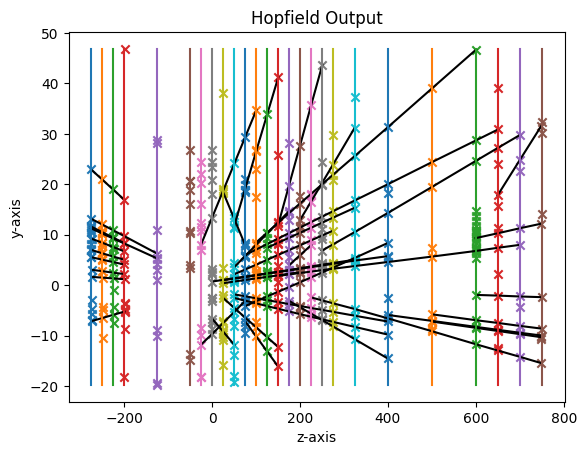

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_100

starting instance 70 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.49 seconds
energy: -392.04500405537163
energy: -379.5960775136962
energy: -363.16773187020056
energy: -335.84255364920926
energy: -399.5079554922216
energy: -376.3778732190918
energy: -307.2661413195483
energy: -314.33327702006693
energy: -332.2712312050289
energy: -362.7614945176069
[HOPFIELD] converged network by below_mean after 2 mins 2.48 seconds; (energy: -356.32)
energy: -328.33521352446746
energy: -326.3538071648837
energy: -332.71495154544266
energy: -337.46775811355184
energy: -337.4159060459792
energy: -387.42598112432336
energy: -347.52177986752105
energy: -366.0906639181254
energy: -355.00529091727645
energy: -421.5440922737222
[HOPFIELD] converged network by below_mean after 2 mins 37.21 seconds; (energy: -353.99)
[INFO] tracks extracted in 0 mins 0.11 seconds


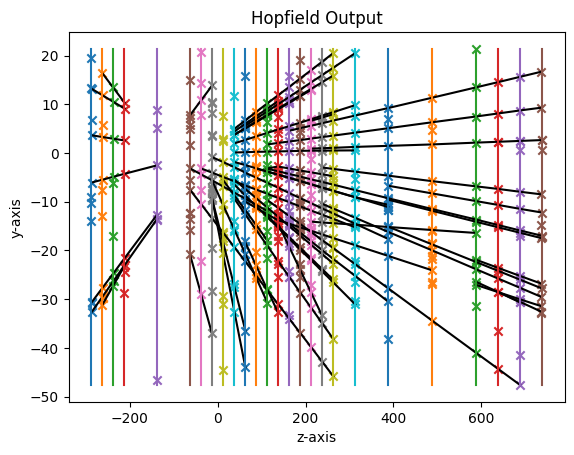

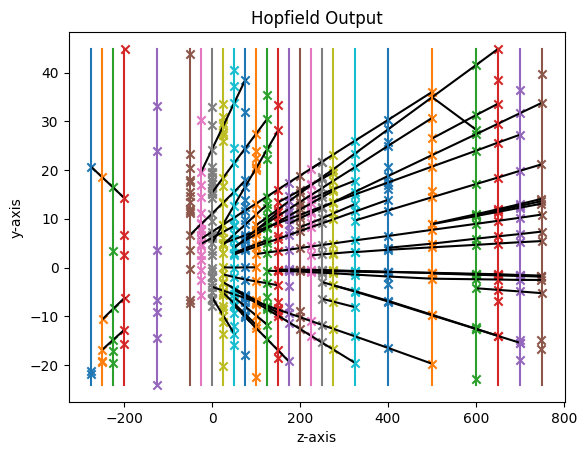

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_510
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_854
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_770
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_909

starting instance 71 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.49 seconds
energy: -284.76481736175754
energy: -313.1128124833847
energy: -316.2756199216546
energy: -297.0287912967888
energy: -299.87970418528164
energy: -298.8660446327502
energy: -303.20473888006717
energy: -299.6759166933497
energy: -297.94081972013424
energy: -305.00938169042746
[HOPFIELD] converged network by below_mean after 1 mins 6.49 seconds; (energy: -301.58)
energy: -300.7503394558088
energy: -229

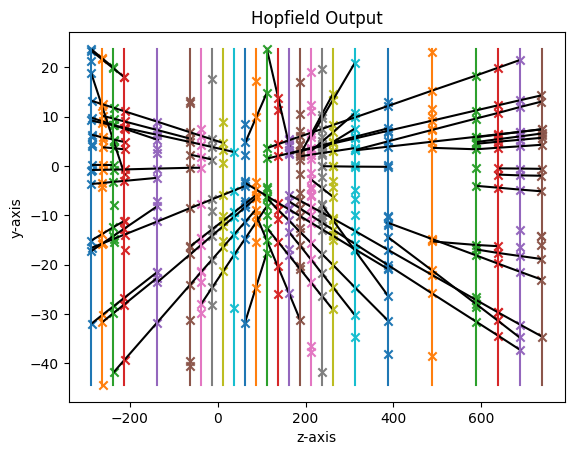

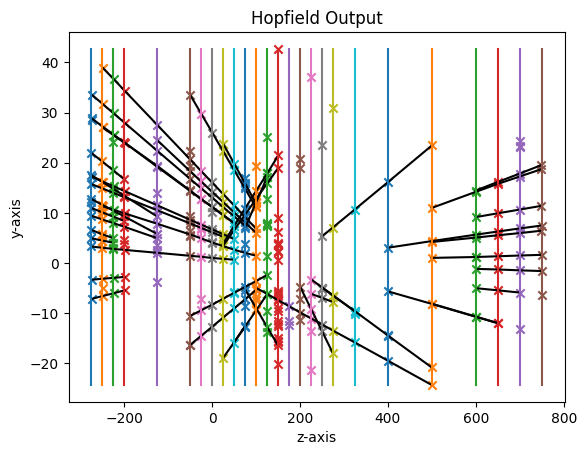

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_851

starting instance 72 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.81 seconds
energy: -391.40948868906077
energy: -396.1620966571124
energy: -349.08411579443685
energy: -415.5438885921761
energy: -382.1438979280047
energy: -367.459178469876
energy: -383.3660413157651
energy: -382.42108364233917
energy: -429.3923008378411
energy: -393.45034038160304
[HOPFIELD] converged network by below_mean after 2 mins 29.43 seconds; (energy: -389.04)
energy: -431.84754972641076
energy: -330.7544947941553
energy: -330.1800758498497
energy: -352.0085438388029
energy: -358.31041382862844
energy: -336.9272984641726
energy: -386.3837563636631
energy: -334.8063019803046
energy: -449.05761101158913
energy: -327.9923890382292
[HOPFIELD] converged network by below_mean after 3 mins 0.04 seconds; (energy: -363.83)
[INFO] tracks extracted in 0 mins 0.14 seconds


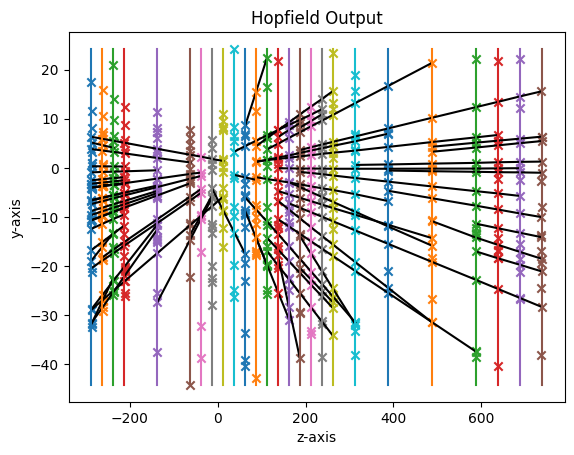

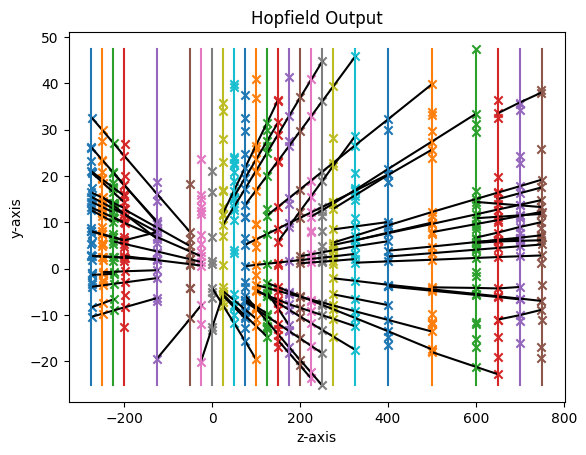

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_196

starting instance 73 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.83 seconds
energy: -320.56165470683226
energy: -276.2509703506624
energy: -286.74080516347726
energy: -252.0944184020369
energy: -333.8395493280666
energy: -284.6082468102805
energy: -277.3255312221674
energy: -316.82126352115523
energy: -316.7092604803419
energy: -307.2676150767592
[HOPFIELD] converged network by below_mean after 1 mins 7.21 seconds; (energy: -297.22)
energy: -333.383917151059
energy: -294.06799557868317
energy: -301.59138688917193
energy: -293.24330085394485
energy: -327.14016107178753
energy: -290.80688397087056
energy: -330.74955445606645
energy: -283.2660356355844
energy: -258.9013522819787
energy: -314.62911243309657
[HOPFIELD] converged network by below_mean after 2 mins 46.50 seconds; (energy: -302.78)
[INFO] tracks extracted in 0 mins 0.09 seconds


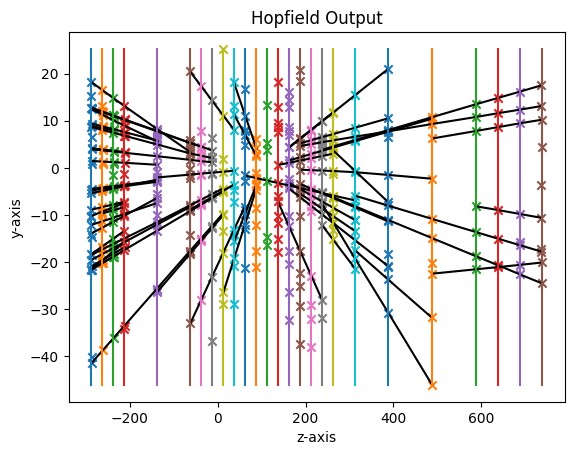

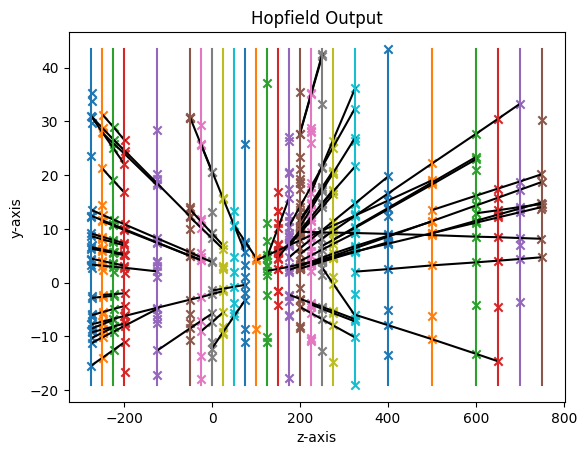

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_673

starting instance 74 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.74 seconds
energy: -138.4055657765682
energy: -151.5184218159957
energy: -143.91611376861727
energy: -137.91127656888102
energy: -139.25856667179391
energy: -155.97397395938685
energy: -142.38852322685375
energy: -130.810852673807
energy: -133.8557319695888
energy: -147.7783735126402
[HOPFIELD] converged network by below_mean after 0 mins 7.60 seconds; (energy: -142.18)
energy: -209.52306683583754
energy: -219.6664484173317
energy: -190.35841348088522
energy: -202.44640520686158
energy: -207.0767214433134
energy: -206.11099663697516
energy: -216.09793864402343
energy: -203.17000383243288
energy: -200.8942648032066
energy: -226.11021348531816
[HOPFIELD] converged network by below_mean after 0 mins 19.91 seconds; (energy: -208.15)
[INFO] tracks extracted in 0 mins 0.03 seconds


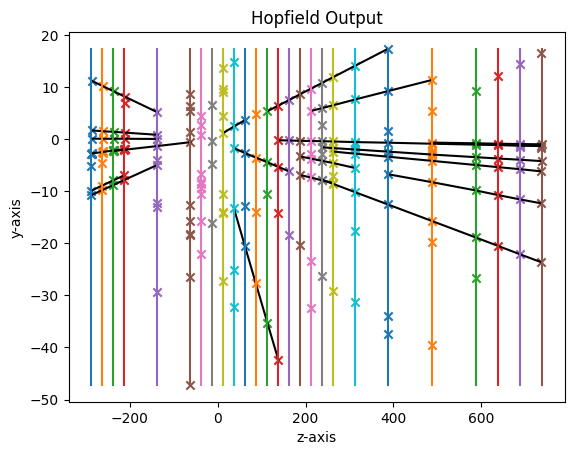

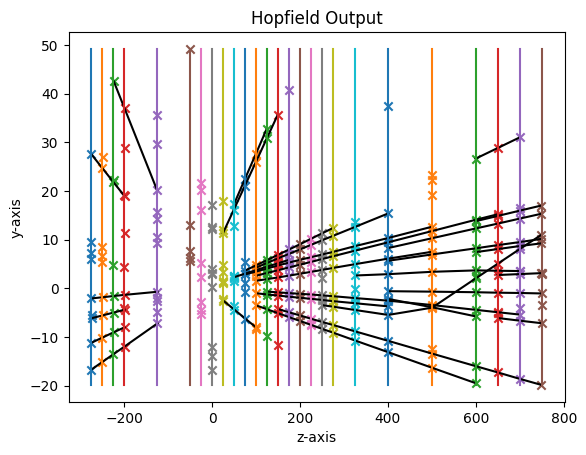

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_23

starting instance 75 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.98 seconds
energy: -510.0401974247064
energy: -495.00561463207544
energy: -471.5750543071132
energy: -464.2226074027743
energy: -460.00303343339914
energy: -484.042883693654
energy: -442.50124561692576
energy: -461.04779597702554
energy: -490.58242836954184
energy: -463.05178237795513
[HOPFIELD] converged network by below_mean after 8 mins 50.30 seconds; (energy: -474.21)
energy: -371.15880327713734
energy: -400.0331808366974
energy: -399.4475123399268
energy: -365.2704100274238
energy: -398.88184714177476
energy: -416.8300918380204
energy: -420.8607460787629
energy: -382.9891064896491
energy: -464.23277216856195
energy: -372.0895880102152
[HOPFIELD] converged network by below_mean after 9 mins 54.45 seconds; (energy: -399.18)
[INFO] tracks extracted in 0 mins 0.17 seconds


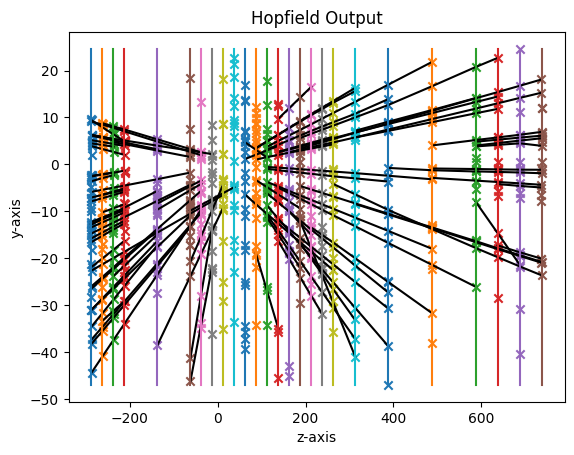

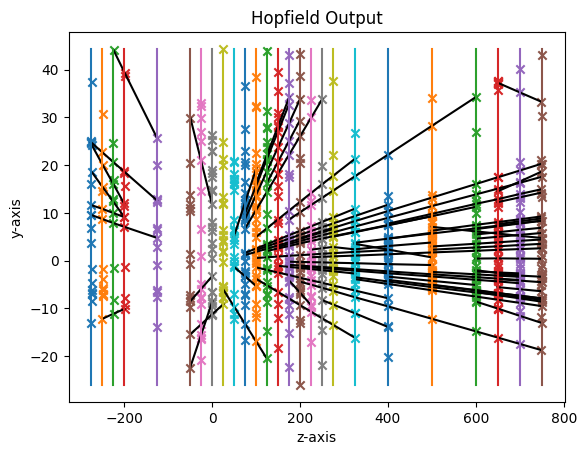

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_753
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_899
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_104

starting instance 76 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.20 seconds
energy: -503.67971428883044
energy: -500.1834541973243
energy: -530.9416416941194
energy: -542.5189464609041
energy: -539.1901039470872
energy: -544.0300492815089
energy: -561.2471052655665
energy: -535.3093872338277
energy: -627.1470278221348
energy: -626.0344502855751
[HOPFIELD] converged network by below_mean after 6 mins 15.92 seconds; (energy: -551.03)
energy: -295.8960300687624
energy: -319.8992436644427
energy: -328.6678290154263
energy: -359.3217041494803
energy: -377.4332692965837
energy: -375.7159344060494
energy

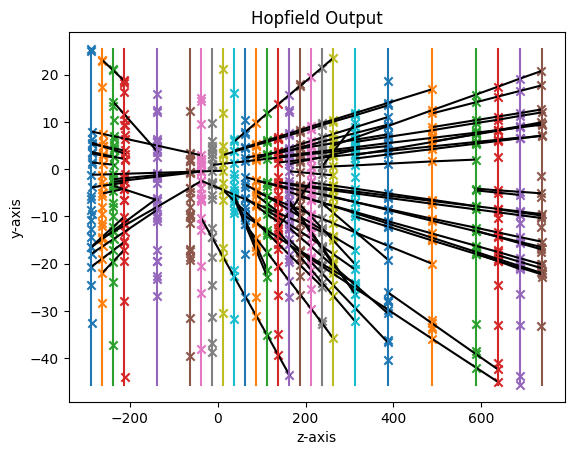

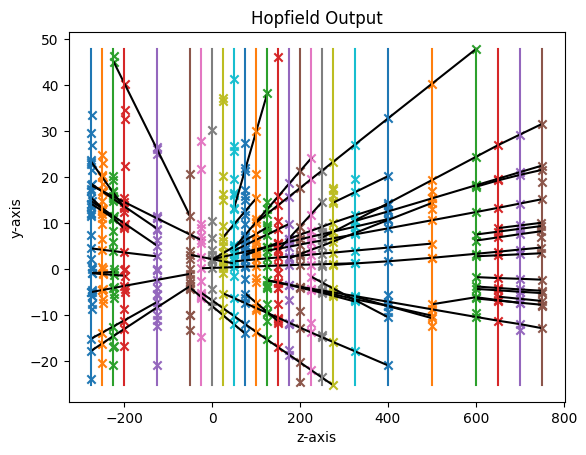

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_33
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_714

starting instance 77 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.14 seconds
energy: -128.79609406548118
energy: -130.2203874676762
energy: -124.7569709037611
energy: -129.36309756431748
energy: -126.99819657961903
energy: -132.2889827729596
energy: -129.95499430623556
energy: -126.54739080829451
energy: -136.23674986129478
energy: -129.2601640449557
[HOPFIELD] converged network by below_mean after 0 mins 2.52 seconds; (energy: -129.44)
energy: -55.795169619693176
energy: -59.62368511834878
energy: -59.62368511834878
energy: -59.910681840233174
energy: -58.81023552089436
energy: -55.795169619693176
energy: -59.62368511834878
energy: -59.62368511834878
energy: -59.62368511834878
energy: -59.62368511834878
[HOPFIELD] converg

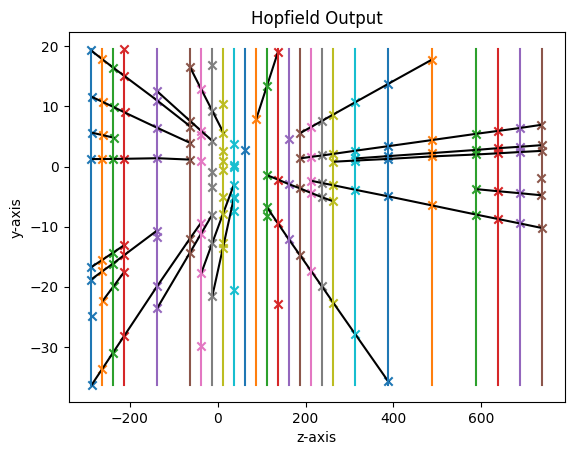

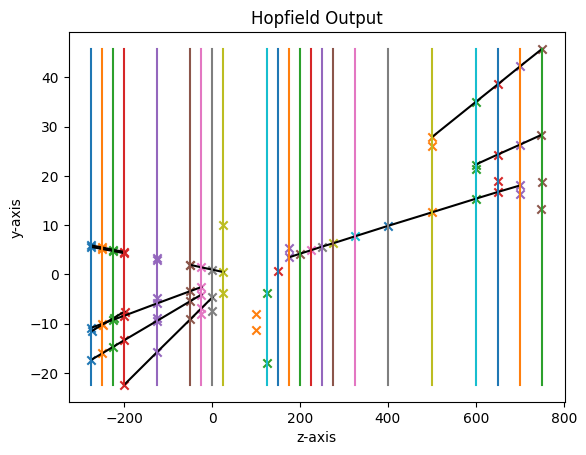

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_363
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_733

starting instance 78 out of 100

[INFO] Hopfield Networks initialized in 0 mins 2.28 seconds
energy: -324.71032147245285
energy: -320.54150857389595
energy: -335.41766514111276
energy: -339.799066697602
energy: -328.00663567242003
energy: -399.38574194637357
energy: -334.1458057123014
energy: -335.2308760130299
energy: -305.2298355027435
energy: -333.6578174818304
[HOPFIELD] converged network by below_mean after 1 mins 0.55 seconds; (energy: -335.61)
energy: -290.37539005682464
energy: -314.88493090673103
energy: -339.6066431029475
energy: -300.0093098348676
energy: -299.5755406478132
energy: -281.8568625916502
energy: -355.99431663424394
energy: -339.9620392663245
energy: -349.44300540101113
energy: -281.5819929595733
[HOPFIELD] converg

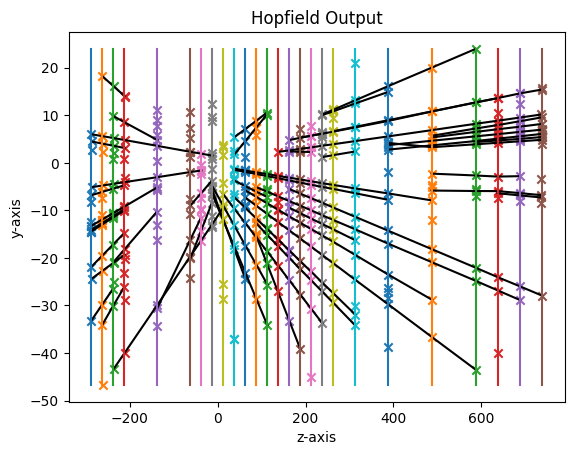

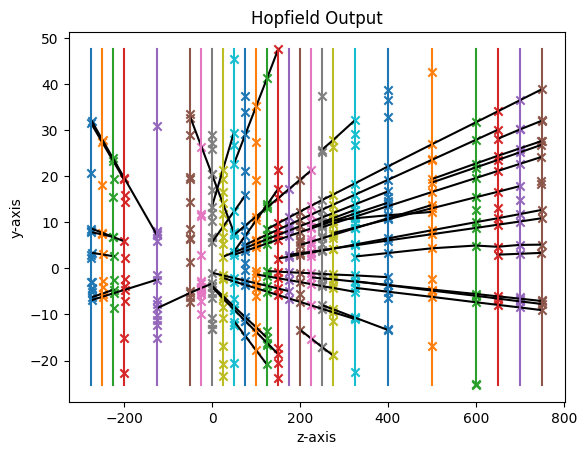

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_727
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_20

starting instance 79 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.99 seconds
energy: -231.93564135246874
energy: -251.97598150696345
energy: -230.07899287834624
energy: -241.48434729401285
energy: -247.53824578024066
energy: -209.27611493842005
energy: -202.33383190240392
energy: -244.68396397029144
energy: -250.21173626997586
energy: -203.9596459712733
[HOPFIELD] converged network by below_mean after 0 mins 40.22 seconds; (energy: -231.35)
energy: -245.64598896714057
energy: -253.81247548162264
energy: -277.10367053344726
energy: -244.27799928357481
energy: -269.4758530330438
energy: -238.89726838014707
energy: -270.0546898785575
energy: -254.75601563440523
energy: -256.47527376037726
energy: -244.79902717046986
[HOPFIELD

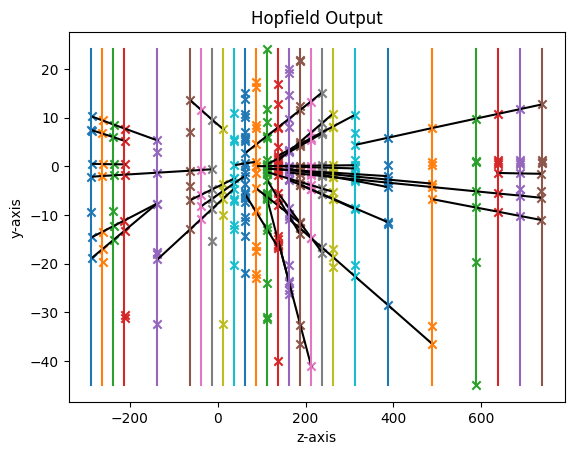

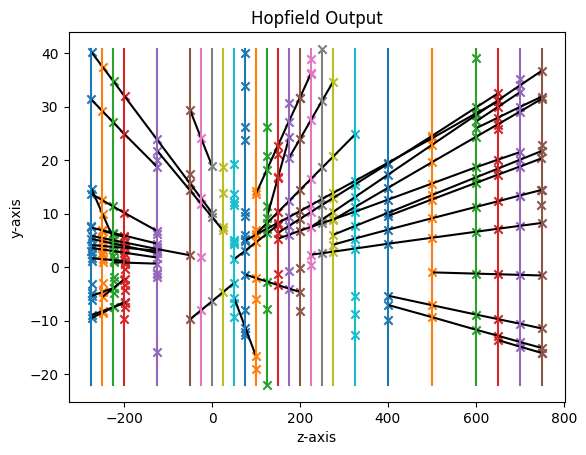

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_372
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_424
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_572

starting instance 80 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.77 seconds
energy: -407.3479621025727
energy: -383.0321662264892
energy: -438.4851708669227
energy: -355.6872569029566
energy: -389.8929911561888
energy: -355.08759415948043
energy: -399.65215453481255
energy: -424.0245406539665
energy: -433.8519975655143
energy: -386.7585690571036
[HOPFIELD] converged network by below_mean after 2 mins 11.31 seconds; (energy: -397.38)
energy: -425.8310273210954
energy: -380.4072400775202
energy: -366.05522681999753
energy: -362.7235943230387
energy: -375.8486718679869
energy: -340.4464671757787
ener

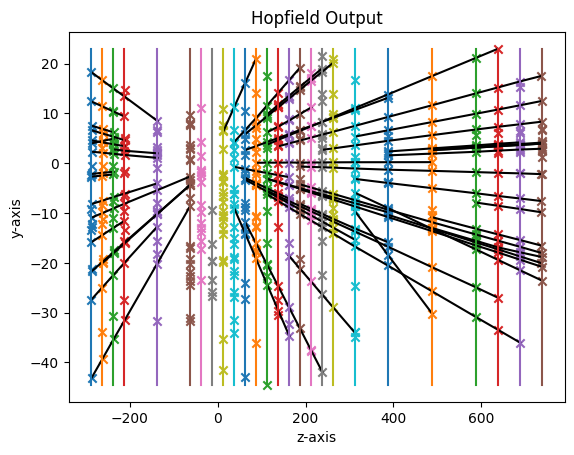

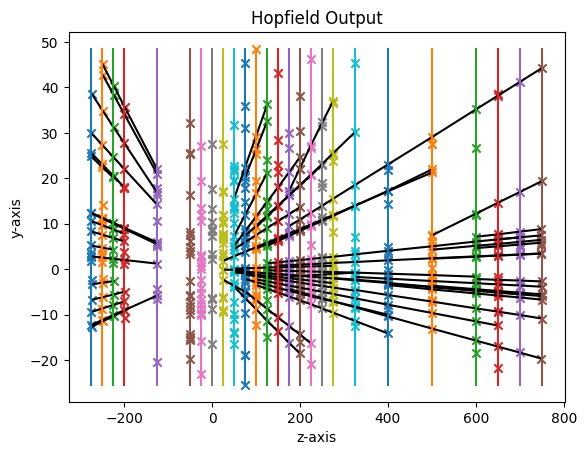

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_484
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_201

starting instance 81 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.48 seconds
energy: -196.50580809571073
energy: -189.98280921082926
energy: -193.07445038659924
energy: -179.5154626649246
energy: -185.8069565804484
energy: -189.2014310654494
energy: -197.0412233271868
energy: -186.32852564551402
energy: -186.37127171049076
energy: -203.61717146927023
[HOPFIELD] converged network by below_mean after 0 mins 17.11 seconds; (energy: -190.74)
energy: -189.2136175058985
energy: -193.14047771107101
energy: -202.48831318453006
energy: -200.82529417031398
energy: -191.1511260499184
energy: -194.55537741872993
energy: -190.45999929662824
energy: -193.7666747567289
energy: -201.24081316793172
energy: -195.66300568602986
[HOPFIELD] c

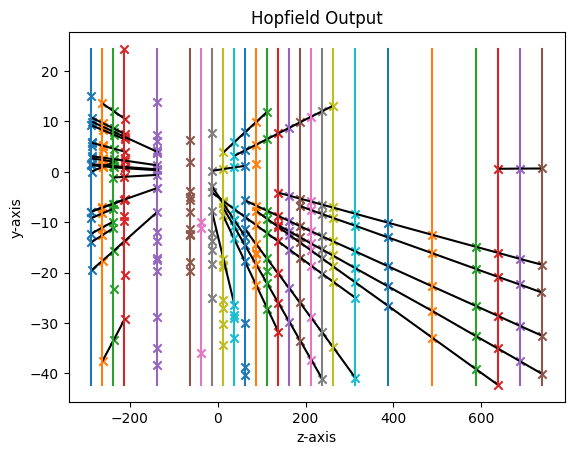

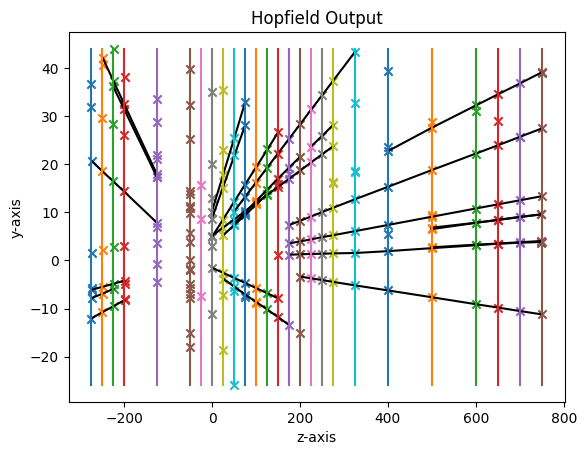

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_629
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_961
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_534
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_336
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_178
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_281
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_388
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_ev

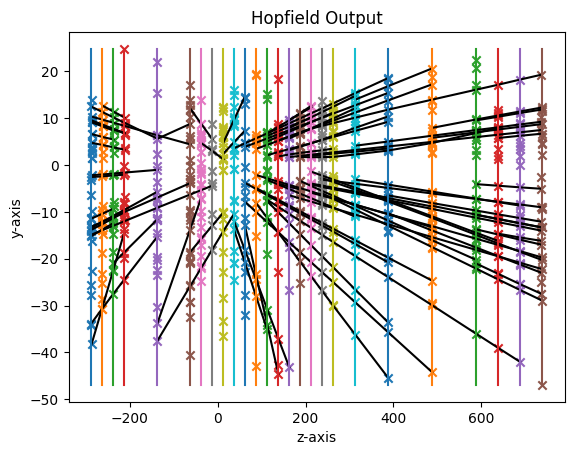

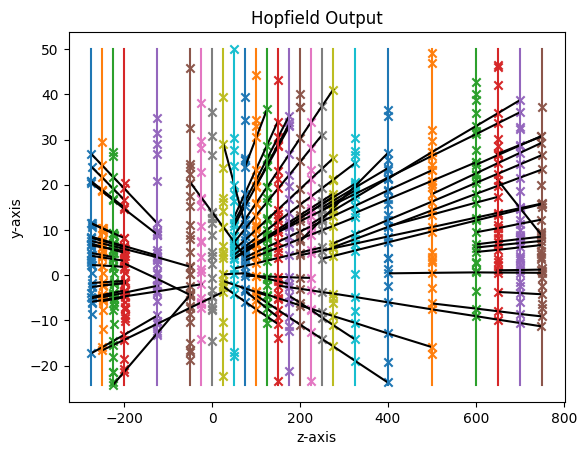

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_410
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_360
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_299
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_365
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_122
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_389

starting instance 83 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.78 seconds
energy: -418.8242679668227
energy: -431.02097585863345
energy: -474.46864367700306
energy: -451.71653438488545
energy: -470.6477548775595
energy: -440

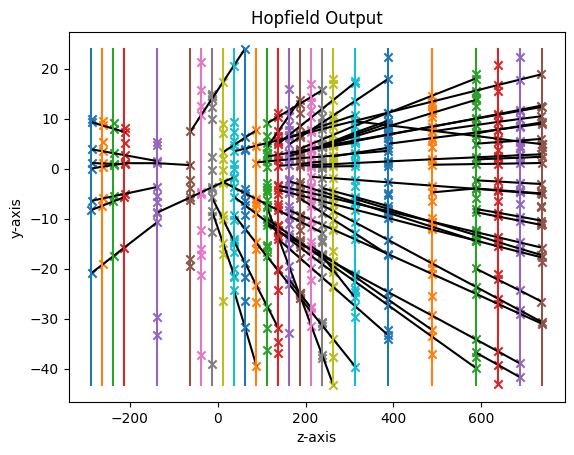

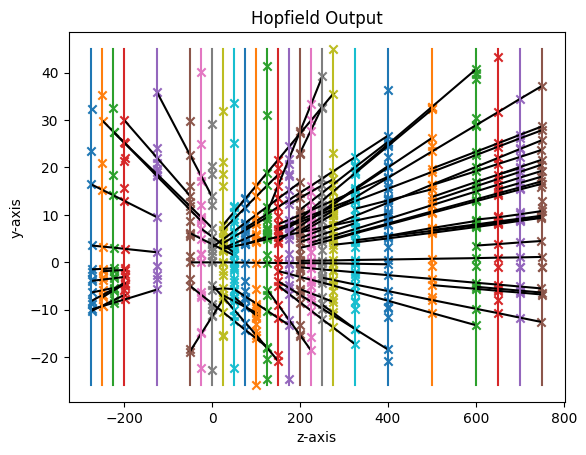

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_245

starting instance 84 out of 100

[INFO] Hopfield Networks initialized in 0 mins 7.31 seconds
energy: -517.7865545142587
energy: -566.2391864685926
energy: -487.35281272554374
energy: -555.9273789681151
energy: -604.0146454049452
energy: -488.65339551613164
energy: -492.2388126526601
energy: -458.43419125545216
energy: -487.0096096703403
energy: -481.50337316280036
[HOPFIELD] converged network by below_mean after 8 mins 5.51 seconds; (energy: -513.92)
energy: -297.59294963536735
energy: -321.9240855008061
energy: -332.0858545407022
energy: -325.88071931484797
energy: -278.0277138536108
energy: -329.67545800004564
energy: -348.60822496697403
energy: -361.9025186862487
energy: -356.3934603589246
energy: -294.40004220618357
[HOPFIELD] converged network by below_mean after 1 mins 47.65 seconds; (energy: -324.65)
[INFO] tracks extracted in 0 mins 0.21 seconds


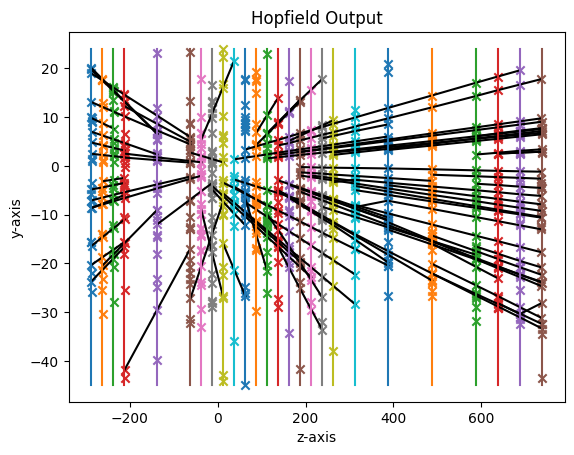

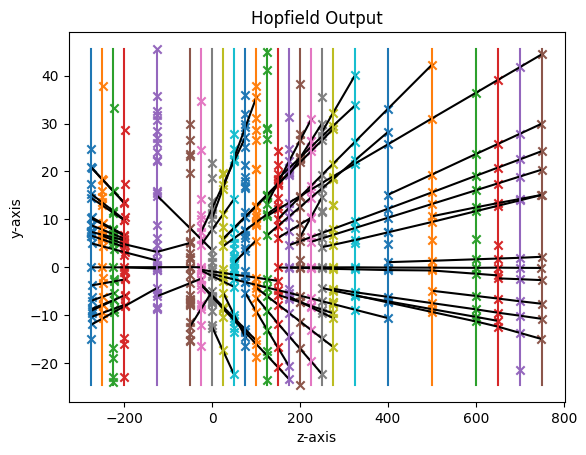

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_427

starting instance 85 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.97 seconds
energy: -301.3866398672468
energy: -325.5160020974992
energy: -343.6045399116523
energy: -310.74392040551936
energy: -312.34869967381746
energy: -336.3221552042793
energy: -325.92510973180146
energy: -334.2240988438806
energy: -311.956665207758
energy: -295.43658717794625
[HOPFIELD] converged network by below_mean after 0 mins 52.98 seconds; (energy: -319.75)
energy: -423.3127248320702
energy: -472.9564690085668
energy: -376.40565085178486
energy: -343.65016034671004
energy: -330.90240975442833
energy: -361.52335938607223
energy: -370.7719017615359
energy: -402.9542820369627
energy: -358.11548215656705
energy: -341.79192880515143
[HOPFIELD] converged network by below_mean after 3 mins 24.29 seconds; (energy: -378.24)
[INFO] tracks extracted in 0 mins 0.09 seconds


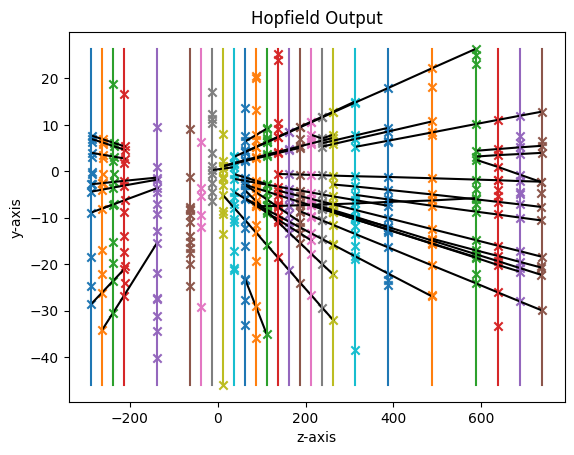

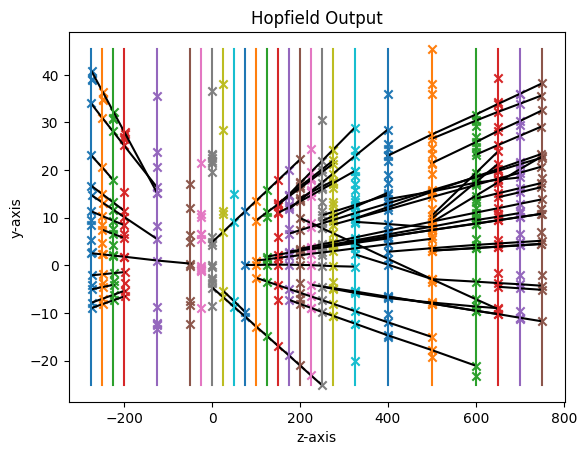

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_868
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_268

starting instance 86 out of 100

[INFO] Hopfield Networks initialized in 0 mins 12.42 seconds
energy: -515.6571139253597
energy: -468.01598331613366
energy: -500.20877297104215
energy: -490.22318793062647
energy: -475.56169157324814
energy: -461.46699422980026
energy: -502.7398003364559
energy: -466.7072929511509
energy: -512.2874015862858
energy: -543.6515266861014
[HOPFIELD] converged network by below_mean after 9 mins 54.50 seconds; (energy: -493.65)
energy: -510.89489804975545
energy: -609.093097541027
energy: -547.8967949712845
energy: -513.3170190233765
energy: -558.1444132473391
energy: -520.1482463762468
energy: -571.2195359946671
energy: -544.7475711084744
energy: -537.0545999886102
energy: -519.4667147680512
[HOPFIELD] converge

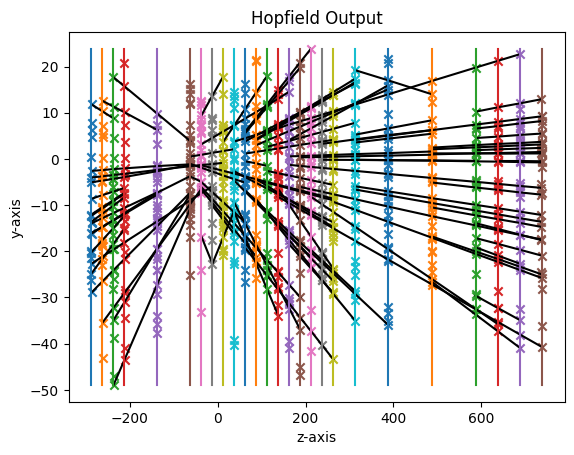

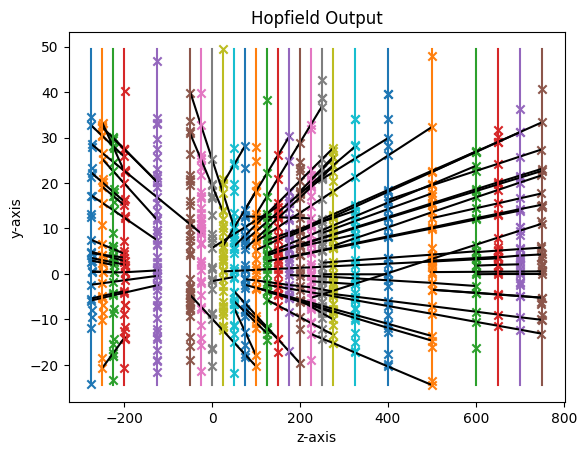

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_529
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_437

starting instance 87 out of 100

[INFO] Hopfield Networks initialized in 0 mins 0.83 seconds
energy: -262.45411901580314
energy: -265.7629597908166
energy: -275.16371462182997
energy: -285.0799266675674
energy: -232.32174228853512
energy: -255.9777582398328
energy: -258.2922740139671
energy: -269.9942919157126
energy: -264.73351369105484
energy: -275.82573501157924
[HOPFIELD] converged network by below_mean after 0 mins 35.92 seconds; (energy: -264.56)
energy: -285.97334776351954
energy: -281.6167021622481
energy: -307.0552519686669
energy: -270.8782644487855
energy: -285.3320518013126
energy: -303.40271069849564
energy: -293.10446568052237
energy: -282.41828239326236
energy: -293.903448272887
energy: -317.9257598975212
[HOPFIELD] conver

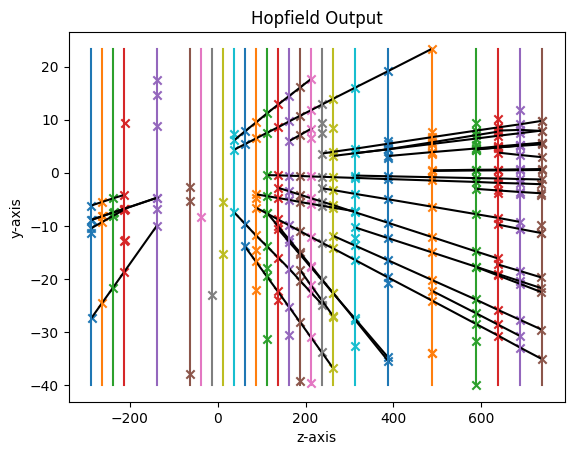

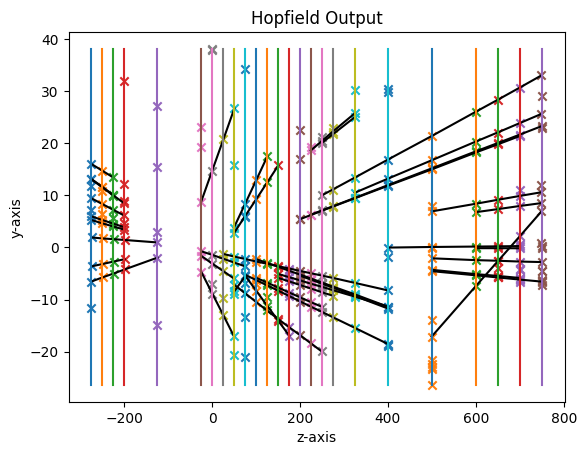

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_718

starting instance 88 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.99 seconds
energy: -488.4361330291865
energy: -483.5240502926303
energy: -445.01699326577904
energy: -463.7654639162131
energy: -497.7869858277169
energy: -521.554304396788
energy: -457.90498782791883
energy: -517.8727267969977
energy: -498.334373257086
energy: -497.43976377605094
[HOPFIELD] converged network by below_mean after 6 mins 58.61 seconds; (energy: -487.16)
energy: -447.4231821029139
energy: -435.0980235739348
energy: -440.25045940645026
energy: -431.8037547488982
energy: -422.0527089344619
energy: -357.1923365901001
energy: -414.48596202663134
energy: -412.4540954081609
energy: -422.7328889558566
energy: -447.9731308602157
[HOPFIELD] converged network by below_mean after 4 mins 39.73 seconds; (energy: -423.15)
[INFO] tracks extracted in 0 mins 0.17 seconds


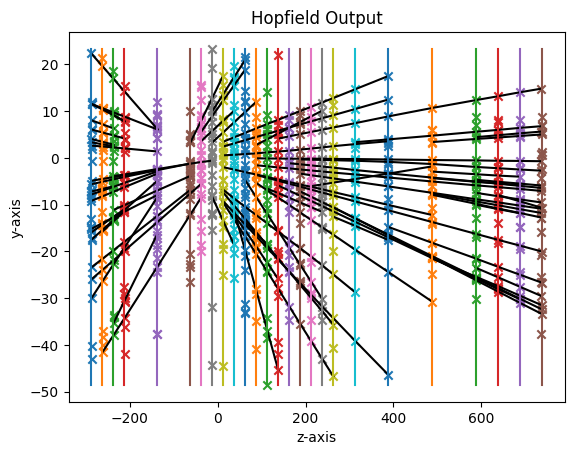

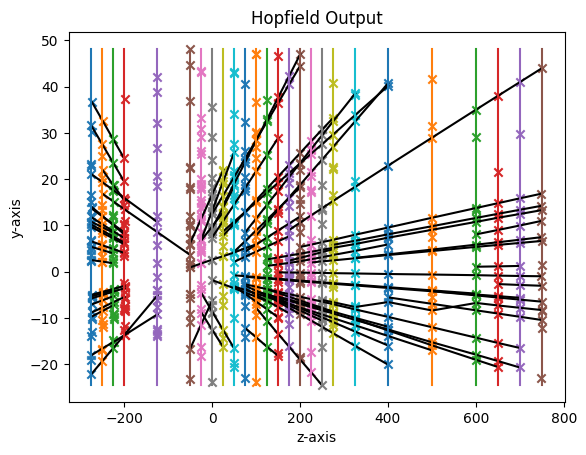

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_795
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_303
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_217
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_869
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_744

starting instance 89 out of 100

[INFO] Hopfield Networks initialized in 0 mins 5.11 seconds
energy: -429.19498544165054
energy: -350.48873387111234
energy: -360.6874619938238
energy: -381.0854619664205
energy: -355.42795634213434
energy: -342.13558890707645
energy: -357.4953325064863
energy: -399.4877155170201
energy: -434.33867242947383
energy: -377.25663839266696


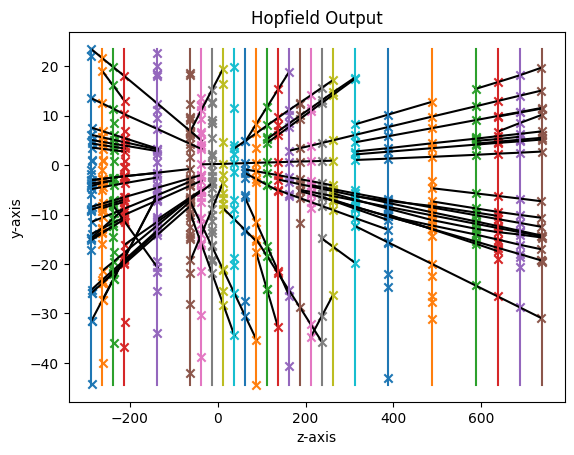

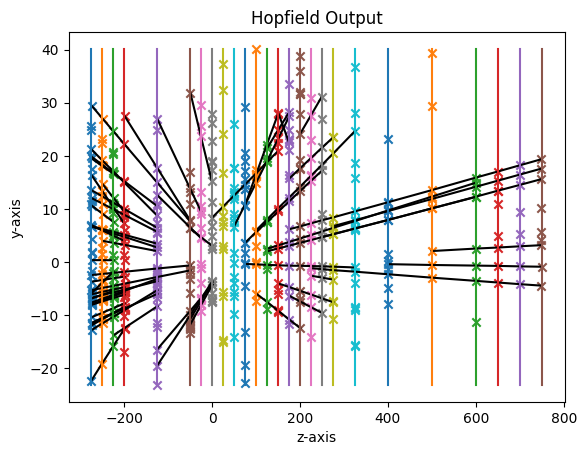

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_434
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_670
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_522
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_823
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_326
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_732
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_300
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_ev

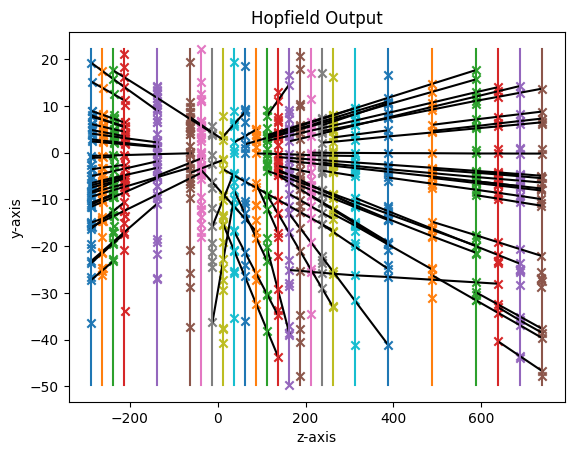

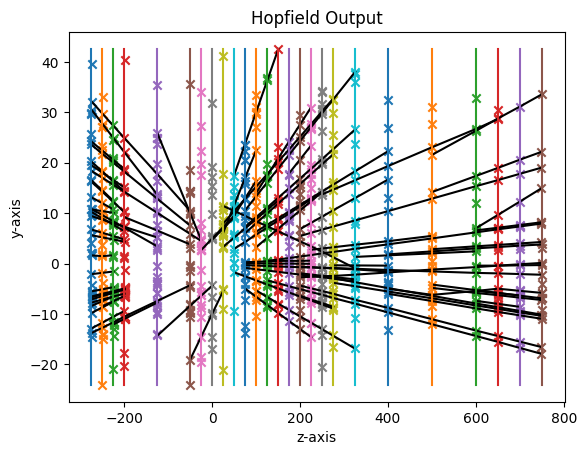

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_384

starting instance 91 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.66 seconds
energy: -340.1852018804149
energy: -342.59916912215976
energy: -313.6020582747851
energy: -370.56222533454024
energy: -393.2240309802501
energy: -376.0896008768589
energy: -344.77600247156704
energy: -377.5330436948045
energy: -429.49524868000196
energy: -272.0997470726412
[HOPFIELD] converged network by below_mean after 2 mins 7.56 seconds; (energy: -356.02)
energy: -370.47956822658824
energy: -367.2225027187992
energy: -318.2737834337836
energy: -354.68819136807383
energy: -383.22534504630903
energy: -365.7722955101836
energy: -395.3474675367824
energy: -390.4987321772947
energy: -400.54383407524557
energy: -348.35366509095996
[HOPFIELD] converged network by below_mean after 1 mins 13.64 seconds; (energy: -369.44)
[INFO] tracks extracted in 0 mins 0.09 seconds


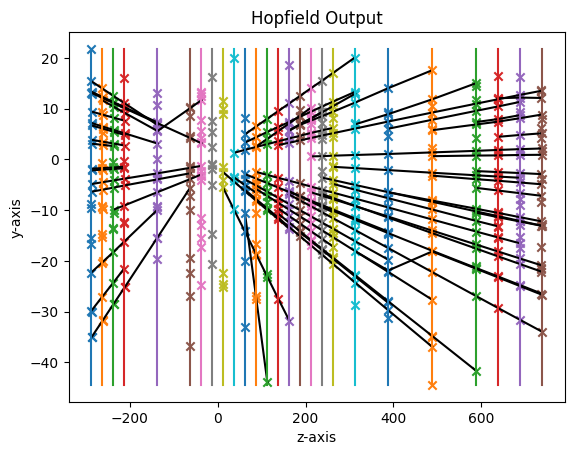

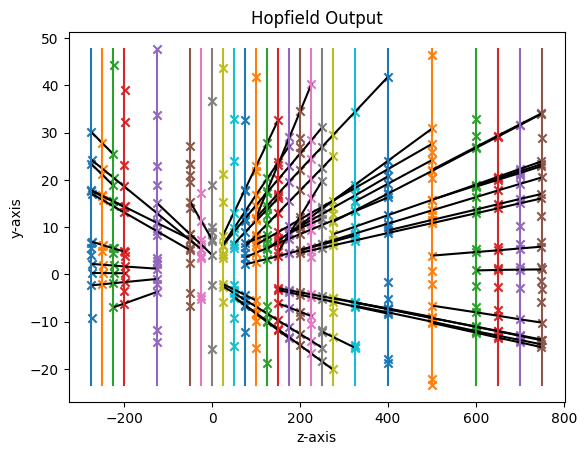

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_611

starting instance 92 out of 100

[INFO] Hopfield Networks initialized in 0 mins 9.13 seconds
energy: -523.9476608805419
energy: -592.3243782474518
energy: -472.34598052519
energy: -536.5424407182289
energy: -488.342803478562
energy: -458.9264390362019
energy: -450.04288150040713
energy: -470.861680045558
energy: -483.09242141631677
energy: -483.83986937548553
[HOPFIELD] converged network by below_mean after 5 mins 27.04 seconds; (energy: -496.03)
energy: -477.6108596707322
energy: -384.9316642806564
energy: -412.83692548231073
energy: -425.79967136860785
energy: -547.4082282958216
energy: -464.72263841635436
energy: -421.67888503649704
energy: -446.1420406105927
energy: -404.9778184173958
energy: -453.83096297542875
[HOPFIELD] converged network by below_mean after 6 mins 35.83 seconds; (energy: -443.99)
[INFO] tracks extracted in 0 mins 0.19 seconds


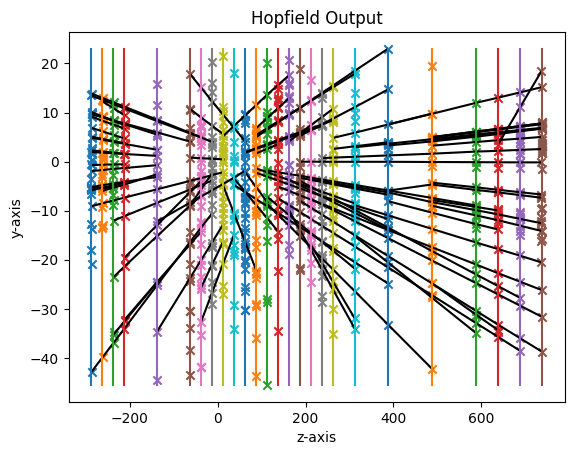

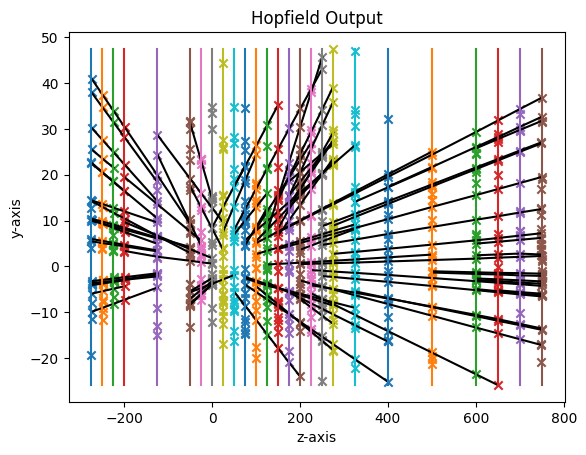

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_562
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_514

starting instance 93 out of 100

[INFO] Hopfield Networks initialized in 0 mins 1.72 seconds
energy: -321.7876965398281
energy: -296.78034937510876
energy: -302.72858999368447
energy: -252.86401741520427
energy: -296.98533365981206
energy: -250.86710587404124
energy: -350.757522788522
energy: -298.22996559251493
energy: -290.17033412618827
energy: -326.7942375858675
[HOPFIELD] converged network by below_mean after 0 mins 50.34 seconds; (energy: -298.80)
energy: -392.3333543975633
energy: -318.25892104975924
energy: -382.6607337581678
energy: -332.6420220310978
energy: -359.75986294329493
energy: -322.0738868363237
energy: -327.03439229936765
energy: -335.978136688402
energy: -316.6566658229717
energy: -418.47939971905123
[HOPFIELD] conve

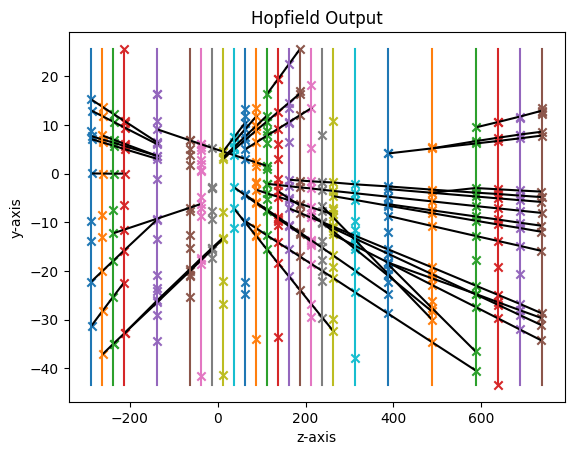

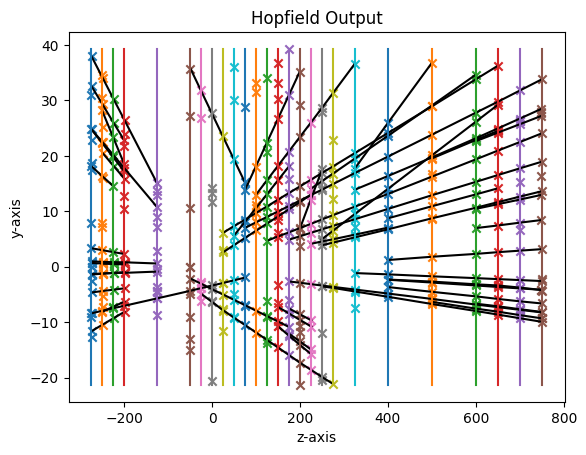

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_480
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_921
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_867
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_462
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_383
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_750
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_855
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_ev

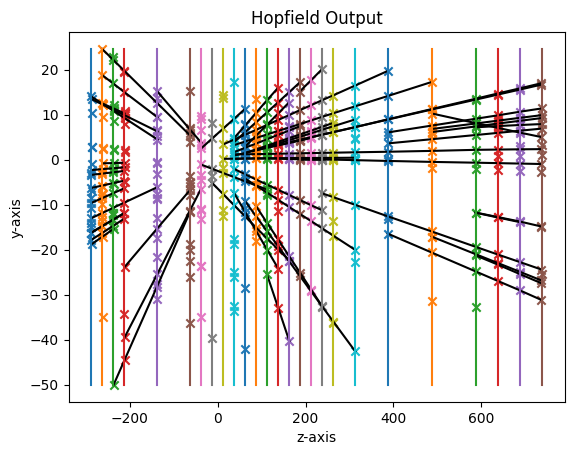

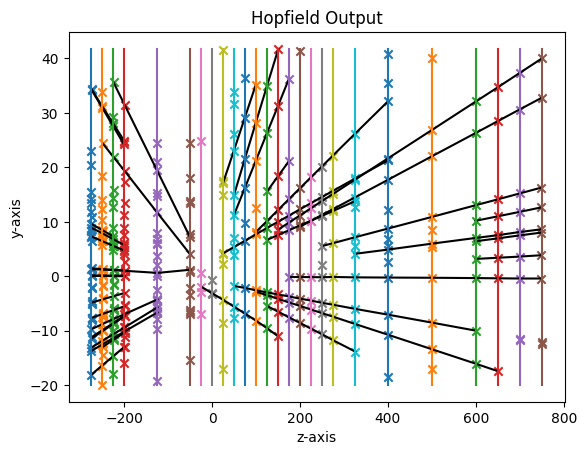

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_14

starting instance 95 out of 100

[INFO] Hopfield Networks initialized in 0 mins 3.75 seconds
energy: -290.4878799101232
energy: -306.44334157974424
energy: -285.25418014168434
energy: -351.09903224208745
energy: -297.49741329113664
energy: -343.89218885647495
energy: -279.8577644770143
energy: -274.02502452803884
energy: -322.01077391743655
energy: -281.91277158875056
[HOPFIELD] converged network by below_mean after 1 mins 7.03 seconds; (energy: -303.25)
energy: -333.5832470718146
energy: -335.60031628568856
energy: -352.24086199582393
energy: -361.8026138583362
energy: -366.2083293982678
energy: -358.8496483573358
energy: -321.8923055089223
energy: -277.98839369524995
energy: -364.24719827690126
energy: -349.84803071433345
[HOPFIELD] converged network by below_mean after 2 mins 5.64 seconds; (energy: -342.23)
[INFO] tracks extracted in 0 mins 0.09 seconds


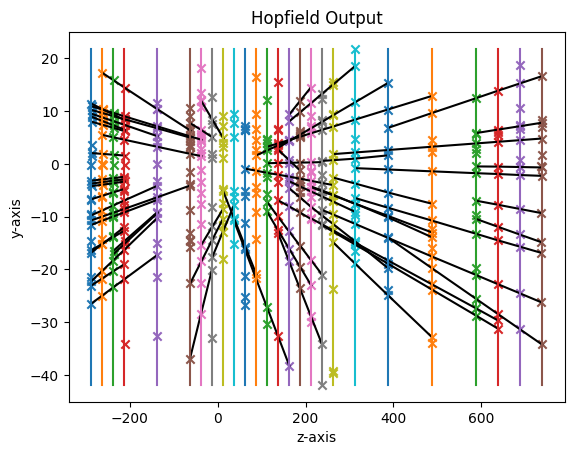

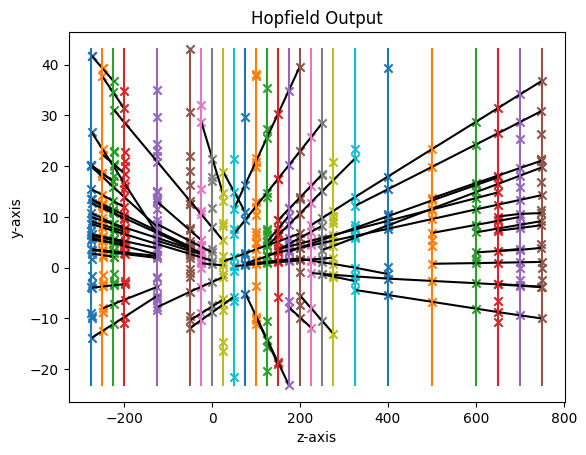

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_149
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_683

starting instance 96 out of 100

[INFO] Hopfield Networks initialized in 0 mins 10.67 seconds
energy: -480.7727866428866
energy: -540.4157252654304
energy: -530.0403983349701
energy: -522.1091243701917
energy: -546.0318287632886
energy: -501.8131566657666
energy: -462.95742246341996
energy: -558.6993429929926
energy: -484.1599884314872
energy: -472.32530724747306
[HOPFIELD] converged network by below_mean after 9 mins 49.22 seconds; (energy: -509.93)
energy: -450.9897449192915
energy: -578.1857984689885
energy: -482.8999984087237
energy: -480.1832523724183
energy: -507.81285555230914
energy: -450.2159822866506
energy: -413.38826398787415
energy: -448.08316961159665
energy: -445.98528888254697
energy: -432.51987289975955
[HOPFIELD] conver

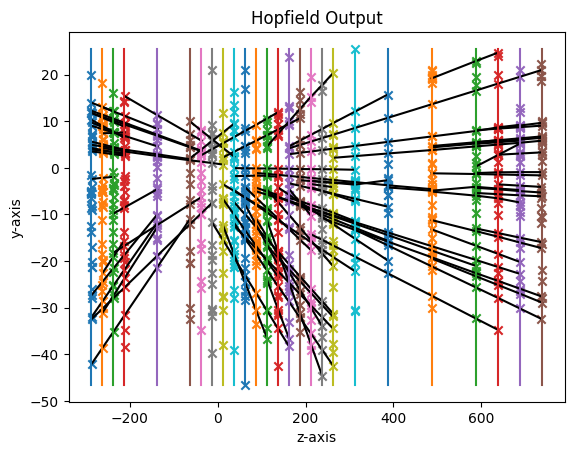

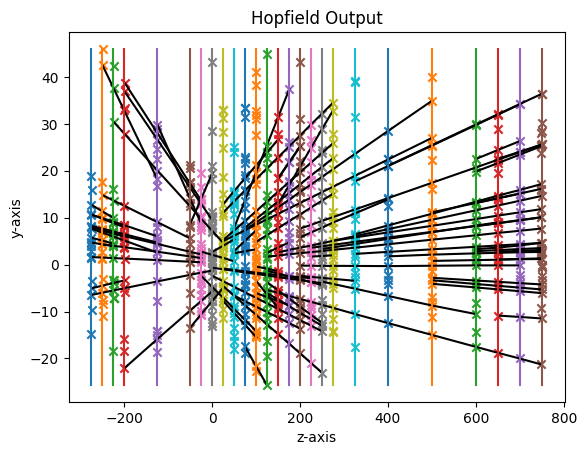

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_292

starting instance 97 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.42 seconds
energy: -220.43355804186118
energy: -226.03550324246626
energy: -217.7025192006311
energy: -233.03907695699556
energy: -250.36804304652733
energy: -257.0375673570482
energy: -241.19936624316549
energy: -240.71389730037302
energy: -237.32385819551374
energy: -241.54767444733812
[HOPFIELD] converged network by below_mean after 0 mins 31.68 seconds; (energy: -236.54)
energy: -385.8056452973089
energy: -449.36768981879504
energy: -384.50480152240823
energy: -370.3448847530807
energy: -466.8828264803155
energy: -428.1173886830436
energy: -460.58853739855124
energy: -417.54250105949086
energy: -417.6823982217991
energy: -452.07199996266115
[HOPFIELD] converged network by below_mean after 3 mins 51.71 seconds; (energy: -423.29)
[INFO] tracks extracted in 0 mins 0.09 seconds


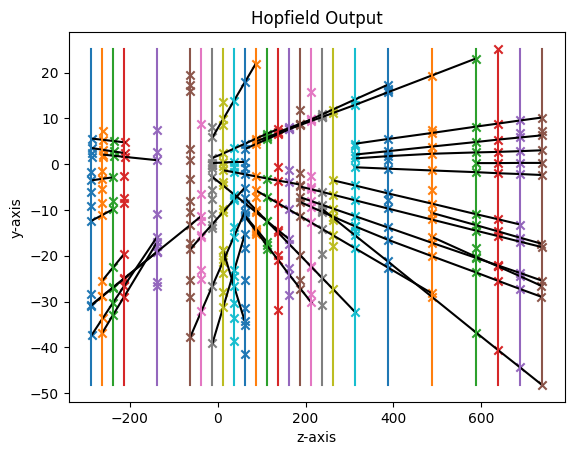

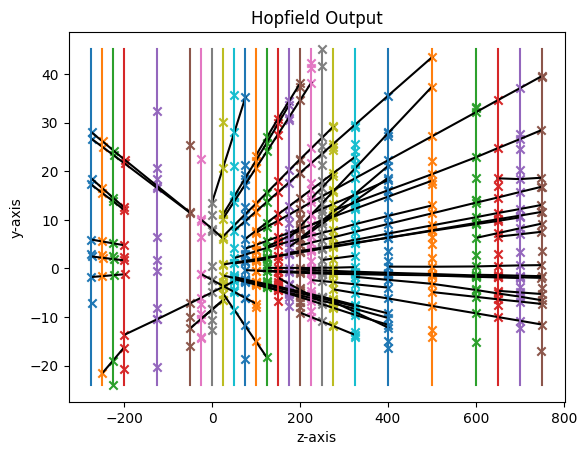

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_386
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_591
[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_664

starting instance 98 out of 100

[INFO] Hopfield Networks initialized in 0 mins 8.63 seconds
energy: -504.7294289870381
energy: -446.9400544982077
energy: -488.29066880002296
energy: -453.84926615283155
energy: -425.0354505930749
energy: -516.1708693631447
energy: -404.0127295584947
energy: -375.64415098732275
energy: -530.5259441484366
energy: -414.711092536152
[HOPFIELD] converged network by below_mean after 3 mins 30.48 seconds; (energy: -455.99)
energy: -438.4232903939297
energy: -538.9496526509814
energy: -450.71163714579944
energy: -572.472307466675
energy: -416.1902114255744
energy: -447.6064489318883
energ

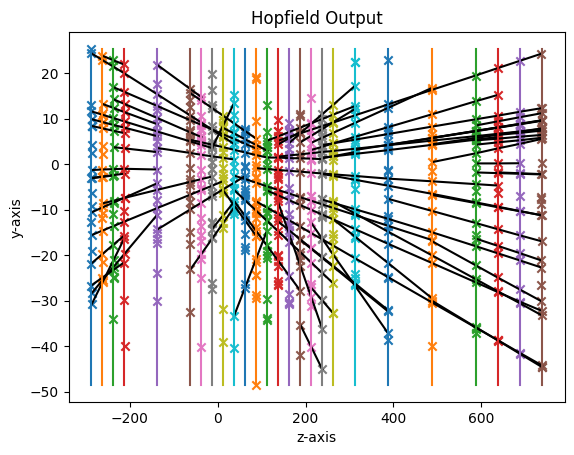

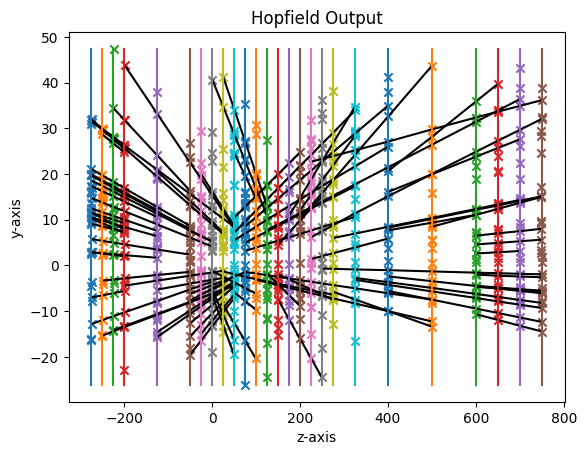

[INFO] Evaluate Event: c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/datasets/minibias/velo_event_905

starting instance 99 out of 100

[INFO] Hopfield Networks initialized in 0 mins 4.67 seconds
energy: -392.599373906232
energy: -453.9263080719854
energy: -369.0751273880734
energy: -495.5584675672579
energy: -474.0431621293248
energy: -416.99484156028234
energy: -430.2387949991431
energy: -449.63997062057774
energy: -409.29859157837365
energy: -427.0940467483885
[HOPFIELD] converged network by below_mean after 3 mins 16.02 seconds; (energy: -431.85)
energy: -342.5739721514014
energy: -303.30737644030154
energy: -374.3995883764922
energy: -382.47644791218346
energy: -382.0940787289699
energy: -313.7289269129493
energy: -332.10350648583625
energy: -314.47984166229224
energy: -310.5005435289713
energy: -298.87177695182703
[HOPFIELD] converged network by below_mean after 3 mins 15.62 seconds; (energy: -335.45)
[INFO] tracks extracted in 0 mins 0.16 seconds


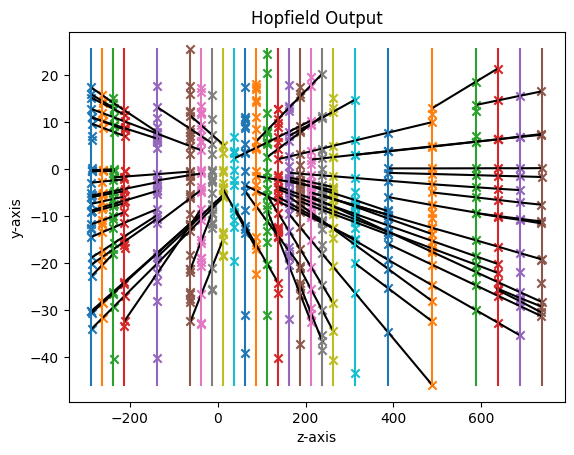

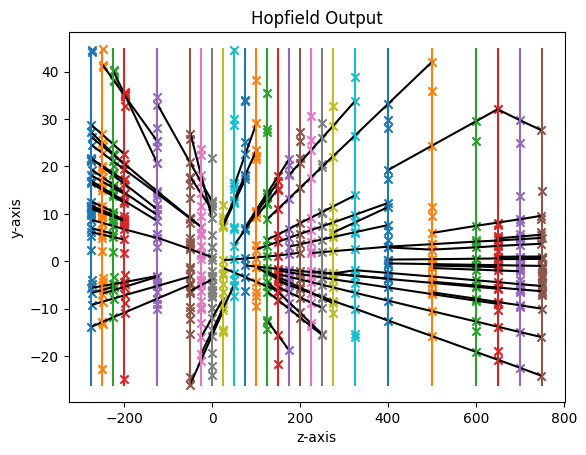

c:\Users\aurel\Documents\GitHub\Code_Thesis_GitHub\Code_Thesis_GitHub/algorithms/experiments/aurelie_experiments_01_02.txt


In [15]:
  
    ###################################################################
save_experiment(
        "aurelie_experiments_01_02",
        "B equal 100*T",
        "Best Configuration Large 100 event Test with 0.01 Pruning Threshold",
        parameters,
        "/datasets/minibias/velo_event_",
        100,
    )
exit()

> What is running here is the "save_experiment" fct, 
which runs the "evaluate_events, 
which runs the Hopfield class

In [16]:
#    modules, tracks = load_instance(r"C:\Users\aurel\Documents\Maastricht University\Thesis\Code_Thesis\algorithms\test.txt", plot_events=True)
#    modules, tracks = prepare_instance(
#        num_modules=10, plot_events=True, num_tracks=20, save_to_file="test.txt")
#    evaluate_events(
#         project_root + "/events/minibias/velo_event_",
#         parameters,
#         nr_events=1,
#         plot_event=True,
#     )

#    my_instance = Hopfield(modules=modules, parameters=parameters)
    # for i in range(len(my_instance.W)):
    #     sns.heatmap(my_instance.W[i])
    #     plt.show()
    # for i in range(3):
    #     print(my_instance.N_info[:,:,i])

    # print(np.round(my_instance.N, 2))
#    np.random.seed(20)
#    my_instance.converge()

    # plt.plot(my_instance.energies)
    # plt.show()

#    my_instance.bootstrap_converge(bootstraps=5, method="mean")
#    print("Converged:", my_instance.energies[-1])
#    my_instance.tracks()
#    my_instance.plot_network_results(show_states=True)

#    my_instance.mark_bifurcation()
#    my_instance.full_tracks()
#    my_instance.plot_network_results(show_states=False)
    # my_instance.tracks()
    # my_instance.plot_network_results(show_states=True)

    # true_instance = Hopfield(modules=modules, parameters=parameters, tracks=tracks)
    # print("True:", true_instance.energy())
    # true_instance.tracks()
    # true_instance.plot_network_results()

    # THIS CODE IS FOR COMPUTING THE MSES FOR DIFFERENT BOOTSTRAPS

    # total_mse = []
    # for i in range(50):
    #     mses = []
    #     for j in range(ceil(50/(i+1))):
    #         instance = Hopfield(modules=modules, parameters=parameters)
    #         instance.bootstrap_converge(bootstraps=i+1)
    #         mses.append(mse(instance, tracks))
    #     total_mse.append(sum(mses)/len(mses))
    #
    # plt.plot(total_mse)
    # plt.show()

: 